### Master Thesis: Development of A Clustering Algorithm for Customer Segmentation

#### Author: Thanita Eiamvijit

#### University: M.Sc. Data Science at University of Europe for Applied Sciences, Germany

#### 1. Import Python Libraries and Dataset

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN
import scipy.cluster.hierarchy as sch 
from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.metrics import silhouette_score
from sklearn.metrics import davies_bouldin_score
from sklearn.metrics import calinski_harabasz_score
import time

data = pd.read_csv("BankChurners.csv")

In [2]:
data.shape

(10127, 23)

#### 2. Data Exploration (Exploratory Data Analysis)

In [2]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10127 entries, 0 to 10126
Data columns (total 23 columns):
 #   Column                                                                                                                              Non-Null Count  Dtype  
---  ------                                                                                                                              --------------  -----  
 0   CLIENTNUM                                                                                                                           10127 non-null  int64  
 1   Attrition_Flag                                                                                                                      10127 non-null  object 
 2   Customer_Age                                                                                                                        10127 non-null  int64  
 3   Gender                                                                           

In [3]:
data.columns

Index(['CLIENTNUM', 'Attrition_Flag', 'Customer_Age', 'Gender',
       'Dependent_count', 'Education_Level', 'Marital_Status',
       'Income_Category', 'Card_Category', 'Months_on_book',
       'Total_Relationship_Count', 'Months_Inactive_12_mon',
       'Contacts_Count_12_mon', 'Credit_Limit', 'Total_Revolving_Bal',
       'Avg_Open_To_Buy', 'Total_Amt_Chng_Q4_Q1', 'Total_Trans_Amt',
       'Total_Trans_Ct', 'Total_Ct_Chng_Q4_Q1', 'Avg_Utilization_Ratio',
       'Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_1',
       'Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_2'],
      dtype='object')

In [2]:
data.rename(columns = {
    "Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_1": "nbc_mon_1",
    "Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_2": "nbc_mon_2"
}, 
inplace=True)

- Descriptive statistics

In [6]:
data.describe()

,CLIENTNUM,Customer_Age,Dependent_count,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,nbc_mon_1,nbc_mon_2
count,1.012700e+04,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000,10127.000000
mean,7.391776e+08,46.325960,2.346203,35.928409,3.812580,2.341167,2.455317,8631.953698,1162.814061,7469.139637,0.759941,4404.086304,64.858695,0.712222,0.274894,0.159997,0.840003
std,3.690378e+07,8.016814,1.298908,7.986416,1.554408,1.010622,1.106225,9088.776650,814.987335,9090.685324,0.219207,3397.129254,23.472570,0.238086,0.275691,0.365301,0.365301
min,7.080821e+08,26.000000,0.000000,13.000000,1.000000,0.000000,0.000000,1438.300000,0.000000,3.000000,0.000000,510.000000,10.000000,0.000000,0.000000,0.000008,0.000420
25%,7.130368e+08,41.000000,1.000000,31.000000,3.000000,2.000000,2.000000,2555.000000,359.000000,1324.500000,0.631000,2155.500000,45.000000,0.582000,0.023000,0.000099,0.999660
50%,7.179264e+08,46.000000,2.000000,36.000000,4.000000,2.000000,2.000000,4549.000000,1276.000000,3474.000000,0.736000,3899.000000,67.000000,0.702000,0.176000,0.000181,0.999820
75%,7.731435e+08,52.000000,3.000000,40.000000,5.000000,3.000000,3.000000,11067.500000,1784.000000,9859.000000,0.859000,4741.000000,81.000000,0.818000,0.503000,0.000337,0.999900
max,8.283431e+08,73.000000,5.000000,56.000000,6.000000,6.000000,6.000000,34516.000000,2517.000000,34516.000000,3.397000,18484.000000,139.000000,3.714000,0.999000,0.999580,0.999990


In [3]:
data_drop = data.drop(['CLIENTNUM', 'nbc_mon_1', 'nbc_mon_2'], axis=1)

In [4]:
data_drop_plot = data.drop(['CLIENTNUM', 'nbc_mon_1', 'nbc_mon_2','Contacts_Count_12_mon','Total_Amt_Chng_Q4_Q1','Total_Ct_Chng_Q4_Q1'], axis=1)

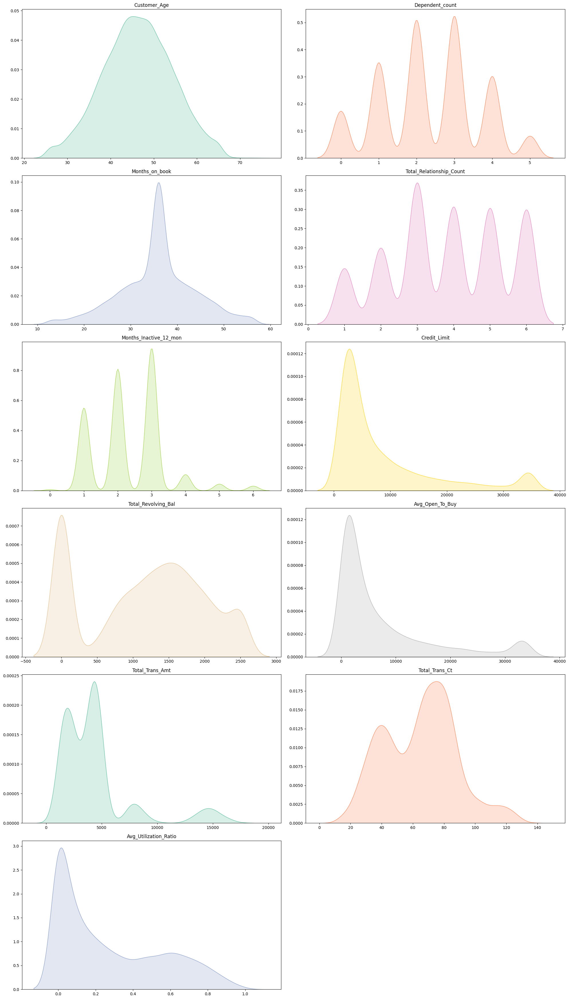

['',
 'import pandas as pd\nimport numpy as np\nimport matplotlib.pyplot as plt\nimport seaborn as sns\nfrom sklearn.cluster import KMeans\nfrom sklearn.cluster import DBSCAN\nimport scipy.cluster.hierarchy as sch \nfrom sklearn.cluster import AgglomerativeClustering\nfrom scipy.cluster.hierarchy import dendrogram, linkage\nfrom sklearn.metrics import silhouette_score\nfrom sklearn.metrics import davies_bouldin_score\nfrom sklearn.metrics import calinski_harabasz_score\nimport time\n\ndata = pd.read_csv("BankChurners.csv")',
 'data.info()',
 'data.columns',
 'data.rename(columns = {\n    "Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_1": "nbc_mon_1",\n    "Naive_Bayes_Classifier_Attrition_Flag_Card_Category_Contacts_Count_12_mon_Dependent_count_Education_Level_Months_Inactive_12_mon_2": "nbc_mon_2"\n}, \ninplace=True)',
 "data_drop = data.drop(['CLIENTNUM', 'nbc_mon_1', 'nbc_mon_2'], axis=1)",
 "data_dro

In [7]:
# Select numerical variables
numeric = data_drop_plot.select_dtypes(exclude=object).columns

# Determine the number of subplots needed
num_plots = len(numeric)

# Determine the number of rows and columns for the subplot grid
num_rows = (num_plots + 1) // 2
num_cols = 2

# Create the figure and subplots
fig, axs = plt.subplots(num_rows, num_cols, figsize=(20, 35))
fig.patch.set_facecolor('white')

colors = sns.color_palette("Set2", n_colors=num_plots).as_hex()

# Loop over the numerical variables and corresponding subplots
for i, (col, ax) in enumerate(zip(numeric, axs.flatten())):
    sns.kdeplot(x=col, data=data_drop_plot, color=colors[i], fill=True, ax=ax)
    ax.set_title(f'{col}')
    ax.set_xlabel('')
    ax.set_ylabel('')

# Remove any unused subplots if the number of plots is not divisible by 2
if num_plots % 2 != 0:
    fig.delaxes(axs.flatten()[-1])

plt.tight_layout()

plt.show()
In 

- Data visualization

In [10]:
data.columns

Index(['CLIENTNUM', 'Attrition_Flag', 'Customer_Age', 'Gender',
       'Dependent_count', 'Education_Level', 'Marital_Status',
       'Income_Category', 'Card_Category', 'Months_on_book',
       'Total_Relationship_Count', 'Months_Inactive_12_mon',
       'Contacts_Count_12_mon', 'Credit_Limit', 'Total_Revolving_Bal',
       'Avg_Open_To_Buy', 'Total_Amt_Chng_Q4_Q1', 'Total_Trans_Amt',
       'Total_Trans_Ct', 'Total_Ct_Chng_Q4_Q1', 'Avg_Utilization_Ratio',
       'nbc_mon_1', 'nbc_mon_2'],
      dtype='object')

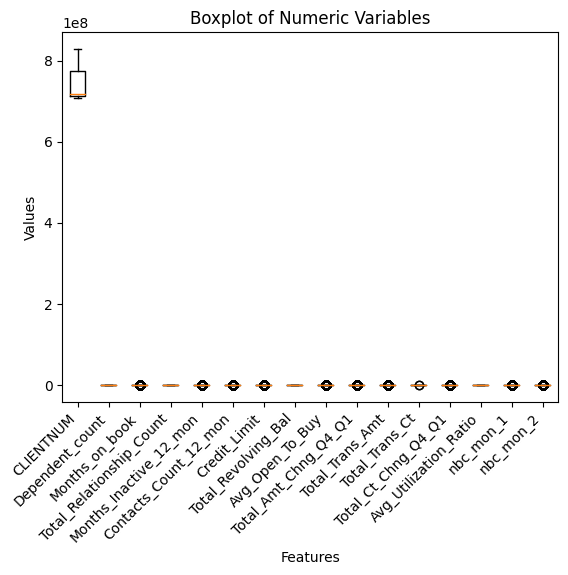

<Figure size 2000x1400 with 0 Axes>

In [5]:
# Create box plot for numeric variables to original dataset

numeric_data = data[['CLIENTNUM', 
       'Dependent_count', 
       'Months_on_book',
       'Total_Relationship_Count', 'Months_Inactive_12_mon',
       'Contacts_Count_12_mon', 'Credit_Limit', 'Total_Revolving_Bal',
       'Avg_Open_To_Buy', 'Total_Amt_Chng_Q4_Q1', 'Total_Trans_Amt',
       'Total_Trans_Ct', 'Total_Ct_Chng_Q4_Q1', 'Avg_Utilization_Ratio',
       'nbc_mon_1', 'nbc_mon_2']]

fig, ax = plt.subplots()
ax.boxplot(numeric_data)
fig = plt.figure(figsize = (20, 14))
ax.set_title("Boxplot of Numeric Variables")
ax.set_xlabel("Features")
ax.set_ylabel("Values")
ax.set_xticklabels(numeric_data.columns, rotation=45, ha="right")

plt.tight_layout()
plt.show()

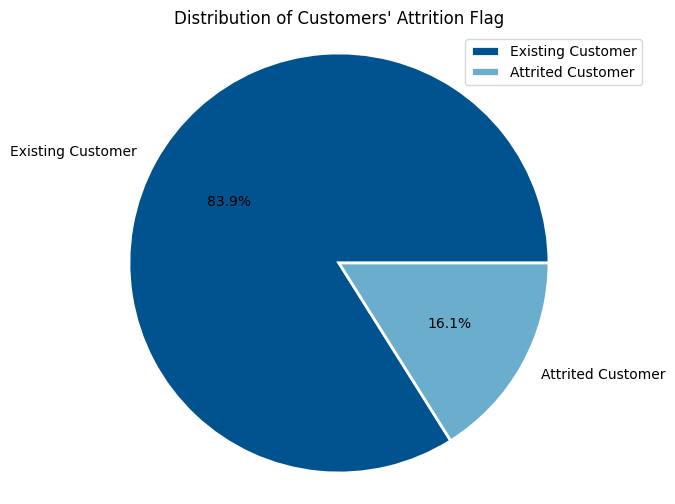

In [12]:
pie_data = data['Attrition_Flag']

df = pd.DataFrame(pie_data)

count_cat = df['Attrition_Flag'].value_counts()

colors = ['#00538F', '#6AADCC']
          
plt.figure(figsize=(8, 6))
plt.pie(count_cat, labels=count_cat.index, colors=colors, autopct='%1.1f%%',
        wedgeprops={'edgecolor': 'white', 'linewidth': 2.0})

plt.title("Distribution of Customers' Attrition Flag")

plt.axis('equal') # Equal aspect ratio ensures that pie is drawn as a circle

plt.legend()
plt.show()

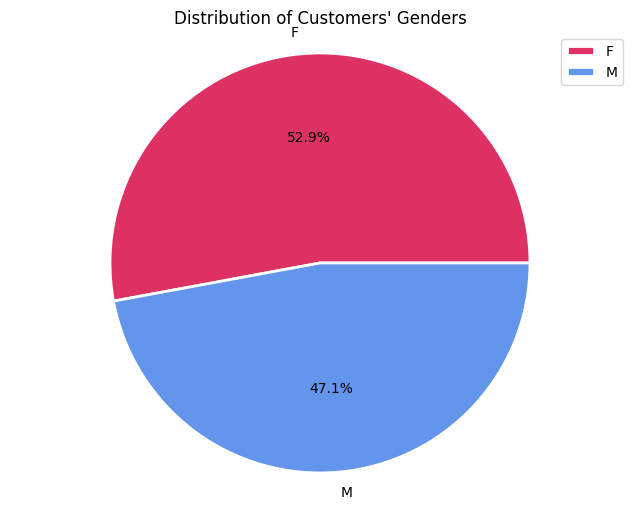

In [13]:
gend_df = pd.DataFrame(data['Gender'])

count_cat = gend_df['Gender'].value_counts()

colors = ['#DE3163', '#6495ED']
          
plt.figure(figsize=(8, 6))
plt.pie(count_cat, labels=count_cat.index, colors=colors, autopct='%1.1f%%',
        wedgeprops={'edgecolor': 'white', 'linewidth': 2.0})

plt.title("Distribution of Customers' Genders")

plt.axis('equal')

plt.legend()
plt.show()

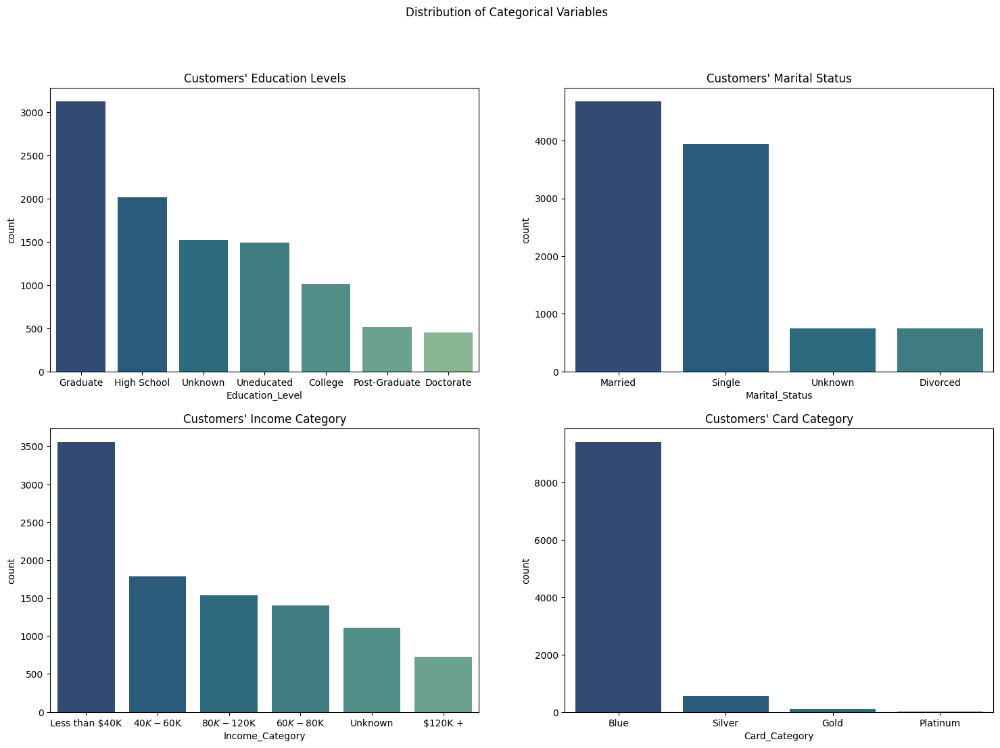

In [14]:
plt.figure(figsize=(18,12))
sns.set_palette("crest_r", n_colors=7)

edu = plt.subplot(2,2,1)
order1 = data['Education_Level'].value_counts().sort_values(ascending=False).index
edu = sns.countplot(x = "Education_Level", data = data, order = order1)
edu.set_title("Customers' Education Levels")

Mari = plt.subplot(2,2,2)
order2 = data['Marital_Status'].value_counts().sort_values(ascending=False).index
Mari = sns.countplot(x = "Marital_Status", data = data, order = order2)
Mari.set_title("Customers' Marital Status")

Income = plt.subplot(2,2,3)
order3 = data['Income_Category'].value_counts().sort_values(ascending=False).index
Income = sns.countplot(x = "Income_Category", data = data, order = order3)
Income.set_title("Customers' Income Category")

Card = plt.subplot(2,2,4)
order4 = data['Card_Category'].value_counts().sort_values(ascending=False).index
Card = sns.countplot(x = "Card_Category", data = data, order = order4)
Card.set_title("Customers' Card Category")

plt.suptitle("Distribution of Categorical Variables")
plt.show()

#### 3. Data Preprocessing

#### 3.1 Data cleaning

In [9]:
# Check missing values
data.isna().sum().sort_values(ascending = True)

CLIENTNUM                   0
Avg_Utilization_Ratio       0
Total_Ct_Chng_Q4_Q1         0
Total_Trans_Ct              0
Total_Trans_Amt             0
Total_Amt_Chng_Q4_Q1        0
Avg_Open_To_Buy             0
Total_Revolving_Bal         0
Credit_Limit                0
Contacts_Count_12_mon       0
nbc_mon_1                   0
Months_Inactive_12_mon      0
Months_on_book              0
Card_Category               0
Income_Category             0
Marital_Status              0
Education_Level             0
Dependent_count             0
Gender                      0
Customer_Age                0
Attrition_Flag              0
Total_Relationship_Count    0
nbc_mon_2                   0
dtype: int64

In [6]:
data_dropid = data.drop(['CLIENTNUM'], axis=1)

In [7]:
data_dropid.shape

(10127, 22)

In [12]:
# Check duplicate in all columns
duplicates = data_dropid[data_dropid.duplicated()]
duplicates

,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,Total_Relationship_Count,...,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,nbc_mon_1,nbc_mon_2


In [8]:
data_dropid.columns

Index(['Attrition_Flag', 'Customer_Age', 'Gender', 'Dependent_count',
       'Education_Level', 'Marital_Status', 'Income_Category', 'Card_Category',
       'Months_on_book', 'Total_Relationship_Count', 'Months_Inactive_12_mon',
       'Contacts_Count_12_mon', 'Credit_Limit', 'Total_Revolving_Bal',
       'Avg_Open_To_Buy', 'Total_Amt_Chng_Q4_Q1', 'Total_Trans_Amt',
       'Total_Trans_Ct', 'Total_Ct_Chng_Q4_Q1', 'Avg_Utilization_Ratio',
       'nbc_mon_1', 'nbc_mon_2'],
      dtype='object')

#### 3.2 Encode categorical variables

In [8]:
# Categorical columns
# Encode categorical columns

from sklearn.preprocessing import LabelEncoder

categorical_columns = [
    "Attrition_Flag",
    "Gender",
    "Education_Level",
    "Marital_Status",
    "Income_Category",
    "Card_Category"
]

cat_maps = dict()
lenc = LabelEncoder()
for c in categorical_columns:
    cat_maps[c] = lenc.fit_transform(data_dropid.loc[:, c])

categorical_df = pd.DataFrame(cat_maps, columns=categorical_columns)

In [15]:
categorical_df

,Attrition_Flag,Gender,Education_Level,Marital_Status,Income_Category,Card_Category
0,1,1,3,1,2,0
1,1,0,2,2,4,0
2,1,1,2,1,3,0
3,1,0,3,3,4,0
4,1,1,5,1,2,0
...,...,...,...,...,...,...
10122,1,1,2,2,1,0
10123,0,1,6,0,1,0
10124,0,0,3,1,4,0
10125,0,1,2,3,1,0


In [9]:
# Numeric columns
numeric_columns = [f for f in data_dropid.columns if f not in categorical_columns]
numeric_df = data_dropid.loc[:, numeric_columns]

In [23]:
numeric_df

,Customer_Age,Dependent_count,Months_on_book,Total_Relationship_Count,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,nbc_mon_1,nbc_mon_2
0,45,3,39,5,1,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061,0.000093,0.999910
1,49,5,44,6,1,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105,0.000057,0.999940
2,51,3,36,4,1,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000,0.000021,0.999980
3,40,4,34,3,4,1,3313.0,2517,796.0,1.405,1171,20,2.333,0.760,0.000134,0.999870
4,40,3,21,5,1,0,4716.0,0,4716.0,2.175,816,28,2.500,0.000,0.000022,0.999980
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10122,50,2,40,3,2,3,4003.0,1851,2152.0,0.703,15476,117,0.857,0.462,0.000191,0.999810
10123,41,2,25,4,2,3,4277.0,2186,2091.0,0.804,8764,69,0.683,0.511,0.995270,0.004729
10124,44,1,36,5,3,4,5409.0,0,5409.0,0.819,10291,60,0.818,0.000,0.997880,0.002118
10125,30,2,36,4,3,3,5281.0,0,5281.0,0.535,8395,62,0.722,0.000,0.996710,0.003294


In [10]:
numericalized_df = pd.concat([categorical_df, numeric_df], axis=1)
numericalized_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10127 entries, 0 to 10126
Data columns (total 22 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Attrition_Flag            10127 non-null  int64  
 1   Gender                    10127 non-null  int64  
 2   Education_Level           10127 non-null  int64  
 3   Marital_Status            10127 non-null  int64  
 4   Income_Category           10127 non-null  int64  
 5   Card_Category             10127 non-null  int64  
 6   Customer_Age              10127 non-null  int64  
 7   Dependent_count           10127 non-null  int64  
 8   Months_on_book            10127 non-null  int64  
 9   Total_Relationship_Count  10127 non-null  int64  
 10  Months_Inactive_12_mon    10127 non-null  int64  
 11  Contacts_Count_12_mon     10127 non-null  int64  
 12  Credit_Limit              10127 non-null  float64
 13  Total_Revolving_Bal       10127 non-null  int64  
 14  Avg_Op

In [11]:
numericalized_df.shape

(10127, 22)

In [12]:
numericalized_df.columns

Index(['Attrition_Flag', 'Gender', 'Education_Level', 'Marital_Status',
       'Income_Category', 'Card_Category', 'Customer_Age', 'Dependent_count',
       'Months_on_book', 'Total_Relationship_Count', 'Months_Inactive_12_mon',
       'Contacts_Count_12_mon', 'Credit_Limit', 'Total_Revolving_Bal',
       'Avg_Open_To_Buy', 'Total_Amt_Chng_Q4_Q1', 'Total_Trans_Amt',
       'Total_Trans_Ct', 'Total_Ct_Chng_Q4_Q1', 'Avg_Utilization_Ratio',
       'nbc_mon_1', 'nbc_mon_2'],
      dtype='object')

- Correlation matrix for all variables

In [27]:
# Correlation matrix to numeric variables in original data
corr_df = numericalized_df.corr()
corr_df

,Attrition_Flag,Gender,Education_Level,Marital_Status,Income_Category,Card_Category,Customer_Age,Dependent_count,Months_on_book,Total_Relationship_Count,...,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio,nbc_mon_1,nbc_mon_2
Attrition_Flag,1.000000,0.037272,-0.005551,-0.018597,-0.017584,0.006038,-0.018203,-0.018991,-0.013687,0.150005,...,0.023873,0.263053,0.000285,0.131063,0.168598,0.371403,0.290054,0.178410,-0.999989,0.999989
Gender,0.037272,1.000000,0.000694,-0.000007,-0.539731,0.079203,-0.017312,0.004563,-0.006728,0.003157,...,0.420806,0.029658,0.418059,0.026712,0.024890,-0.067454,-0.005800,-0.257851,-0.037204,0.037204
Education_Level,-0.005551,0.000694,1.000000,0.014720,-0.010442,-0.007212,0.004083,0.003788,-0.004953,0.009636,...,0.003076,0.008029,0.002356,0.005534,0.015287,0.003046,0.007279,0.006477,0.005557,-0.005558
Marital_Status,-0.018597,-0.000007,0.014720,1.000000,0.009659,0.035947,-0.011265,0.000337,-0.012084,-0.021393,...,0.031292,-0.025386,0.033562,-0.036210,0.044553,0.075888,0.000258,-0.027451,0.018555,-0.018555
Income_Category,-0.017584,-0.539731,-0.010442,0.009659,1.000000,-0.051632,-0.013474,-0.035417,-0.016375,0.008138,...,-0.225394,-0.025815,-0.223033,-0.004534,-0.014686,0.033498,0.014892,0.123287,0.017523,-0.017523
Card_Category,0.006038,0.079203,-0.007212,0.035947,-0.051632,1.000000,-0.020131,0.021674,-0.014749,-0.073770,...,0.484090,0.017027,0.482462,0.004061,0.176377,0.116579,-0.004541,-0.205089,-0.006100,0.006100
Customer_Age,-0.018203,-0.017312,0.004083,-0.011265,-0.013474,-0.020131,1.000000,-0.122254,0.788912,-0.010931,...,0.002476,0.014780,0.001151,-0.062042,-0.046446,-0.067097,-0.012143,0.007114,0.018189,-0.018189
Dependent_count,-0.018991,0.004563,0.003788,0.000337,-0.035417,0.021674,-0.122254,1.000000,-0.103062,-0.039076,...,0.068065,-0.002688,0.068291,-0.035439,0.025046,0.049912,0.011087,-0.037135,0.019189,-0.019189
Months_on_book,-0.013687,-0.006728,-0.004953,-0.012084,-0.016375,-0.014749,0.788912,-0.103062,1.000000,-0.009203,...,0.007507,0.008623,0.006732,-0.048959,-0.038591,-0.049819,-0.014072,-0.007541,0.013693,-0.013694
Total_Relationship_Count,0.150005,0.003157,0.009636,-0.021393,0.008138,-0.073770,-0.010931,-0.039076,-0.009203,1.000000,...,-0.071386,0.013726,-0.072601,0.050119,-0.347229,-0.241891,0.040831,0.067663,-0.149981,0.149981


Text(0.5, 1.0, 'Correlation Matrix')

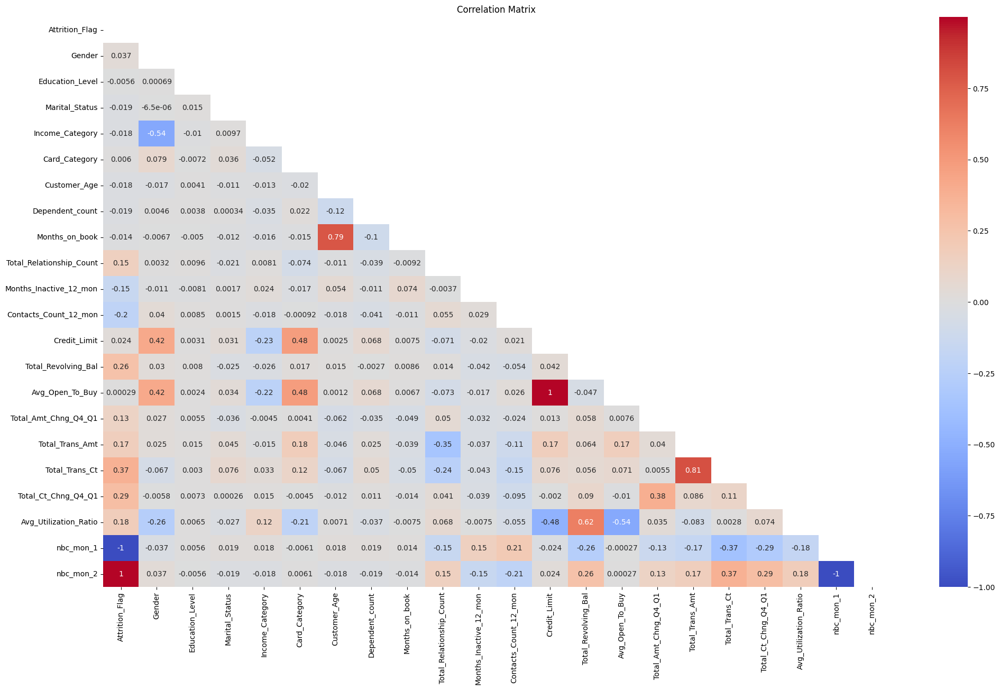

In [28]:
corr_df = numericalized_df.corr()

mask = np.triu(np.ones_like(corr_df, dtype=bool))

plt.figure(figsize=(24, 14))

sns.heatmap(corr_df, mask=mask, annot = True, cmap = 'coolwarm', annot_kws = {"fontsize" : 10})

plt.xticks(rotation = 90)
plt.title('Correlation Matrix')

#### 4. Dimensional Reduction - Feature Importance

Based on numericalized_df

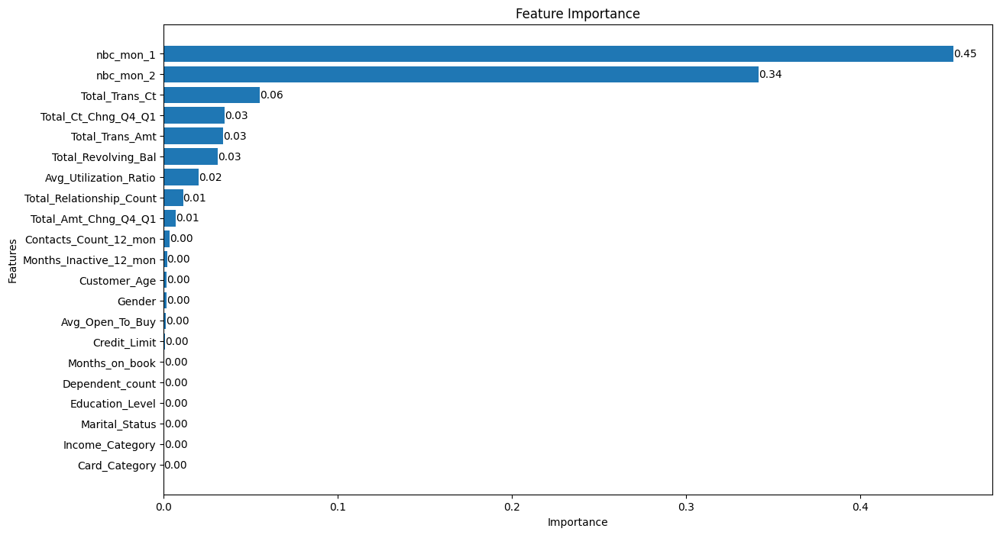

In [12]:
from sklearn.ensemble import RandomForestClassifier

X_full = numericalized_df[[c for c in numericalized_df.columns if c != "Attrition_Flag"]]
y_full = numericalized_df["Attrition_Flag"]

# Create a random forest classifier
clf = RandomForestClassifier(n_estimators=100, random_state=0)

# Train the classifier
clf.fit(X_full, y_full)

# Get feature importances
importances = clf.feature_importances_

# Create a DataFrame for visualization
feature_names = X_full.columns  # Get feature names from your data
feature_importances = pd.DataFrame({'feature': feature_names, 'importance': importances})

# Sort the DataFrame by importance
feature_importances = feature_importances.sort_values('importance', ascending=True)

# Plot feature importances
plt.figure(figsize=(14, 8))
plt.barh(feature_importances['feature'], feature_importances['importance'])
plt.bar_label(plt.gca().containers[0], labels=['{:.2f}'.format(val) for val in feature_importances['importance']])
plt.xlabel('Importance')
plt.ylabel('Features')
plt.title('Feature Importance')
plt.show()

In [15]:
X_full = numericalized_df[[c for c in numericalized_df.columns if c != "Attrition_Flag"]]
y_full = numericalized_df["Attrition_Flag"]

# Create a random forest classifier
clf = RandomForestClassifier(n_estimators=100, random_state=0)

# Train the classifier
clf.fit(X_full, y_full)

# Get feature importances
importances = clf.feature_importances_

# Create a DataFrame with feature names and their importances
df_importances = pd.DataFrame({
    'Feature': X_full.columns,
    'Importance': importances
})

# Sort the DataFrame by importance in descending order
df_importances = df_importances.sort_values(by='Importance', ascending=False)

# Print the sorted DataFrame
print(df_importances)

                     Feature  Importance
19                 nbc_mon_1    0.453439
20                 nbc_mon_2    0.341495
16            Total_Trans_Ct    0.055280
17       Total_Ct_Chng_Q4_Q1    0.034882
15           Total_Trans_Amt    0.034020
12       Total_Revolving_Bal    0.030853
18     Avg_Utilization_Ratio    0.020126
8   Total_Relationship_Count    0.011019
14      Total_Amt_Chng_Q4_Q1    0.006842
10     Contacts_Count_12_mon    0.003506
9     Months_Inactive_12_mon    0.001833
5               Customer_Age    0.001587
0                     Gender    0.001503
13           Avg_Open_To_Buy    0.001081
11              Credit_Limit    0.000907
7             Months_on_book    0.000414
6            Dependent_count    0.000354
1            Education_Level    0.000313
2             Marital_Status    0.000287
3            Income_Category    0.000199
4              Card_Category    0.000058


In [16]:
from sklearn.model_selection import GridSearchCV, StratifiedKFold
from sklearn.metrics import make_scorer, f1_score

params = {
    "max_depth": range(9),
    "min_samples_split": [5,7,9,12,15],
    "min_samples_leaf": [5,7,9,10,12]
}

s_kfold = StratifiedKFold(n_splits=7, shuffle=True, random_state=42)
# s_kfold_iterator = s_kfold(X_full, y_full)

estimators = GridSearchCV(RandomForestClassifier(), param_grid = params, cv = s_kfold, scoring=make_scorer(f1_score), n_jobs=-1)

search_results = estimators.fit(X_full, y_full)

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
175 fits failed out of a total of 1575.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
175 fits failed with the following error:
Traceback (most recent call last):
  File "/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/ensemble/_forest.py", line 340, in fit
    self._validate_params()
  File "/Library/Frameworks/Python.framework/Versions/3.10/lib/python

In [22]:
search_results.best_params_

{'max_depth': 2, 'min_samples_leaf': 5, 'min_samples_split': 5}

In [16]:
# Reduce data to contain only important features columns
important_feature_data = numericalized_df.loc[:,['Total_Revolving_Bal',
                                                'Total_Trans_Amt',
                                                'Total_Trans_Ct',
                                                'Total_Ct_Chng_Q4_Q1',
                                                'nbc_mon_1',
                                                'nbc_mon_2',
                                                'Attrition_Flag']]

In [24]:
important_feature_data.shape

(10127, 7)

In [35]:
important_feature_data.head()

,Total_Revolving_Bal,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,nbc_mon_1,nbc_mon_2,Attrition_Flag
0,777,1144,42,1.625,0.000093,0.99991,1
1,864,1291,33,3.714,0.000057,0.99994,1
2,0,1887,20,2.333,0.000021,0.99998,1
3,2517,1171,20,2.333,0.000134,0.99987,1
4,0,816,28,2.500,0.000022,0.99998,1


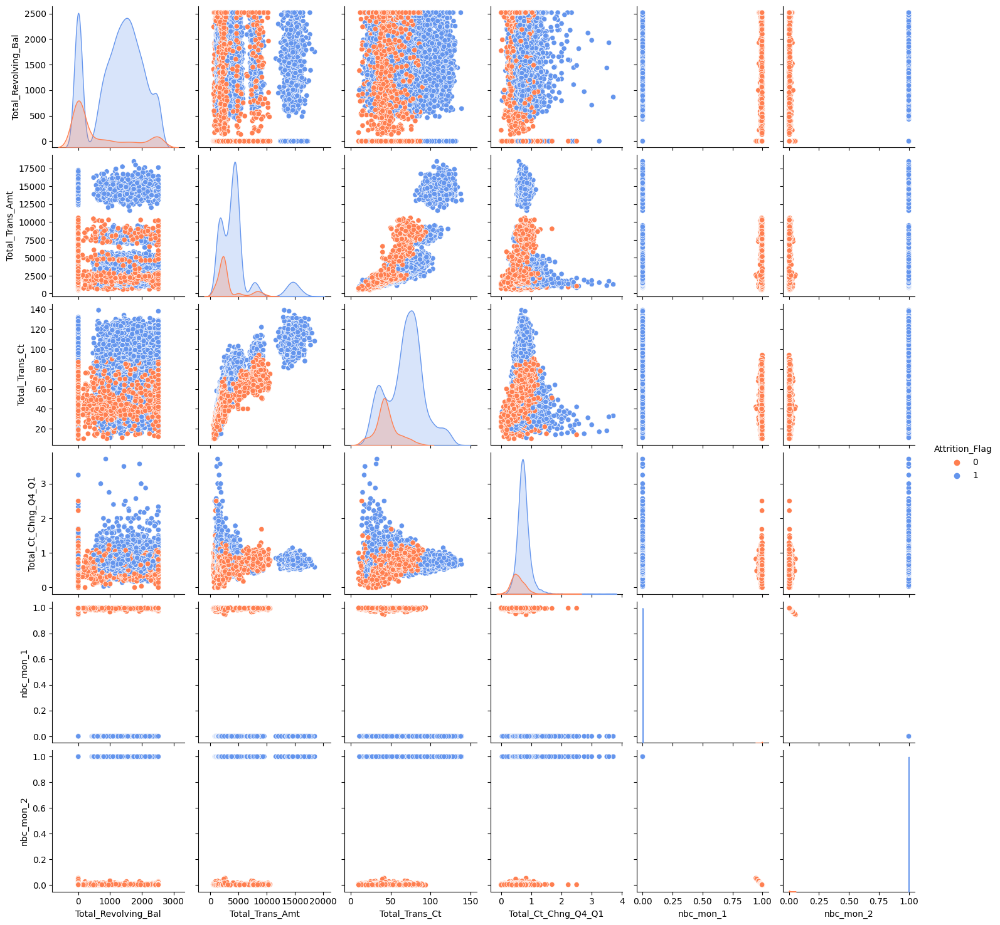

In [36]:
sns.pairplot(important_feature_data, hue='Attrition_Flag', diag_kind='kde', palette=['#FF7F50', '#6495ED']);

feature importance test 2 removing high correlation variables

In [13]:
# Reduce data to contain only important features columns
important_feature_data_2 = numericalized_df.loc[:,['Total_Revolving_Bal',
                                                'Total_Trans_Amt',
                                                'Total_Trans_Ct',
                                                'Total_Ct_Chng_Q4_Q1',
                                                'nbc_mon_1',
                                                'Total_Amt_Chng_Q4_Q1',
                                                'Attrition_Flag']]

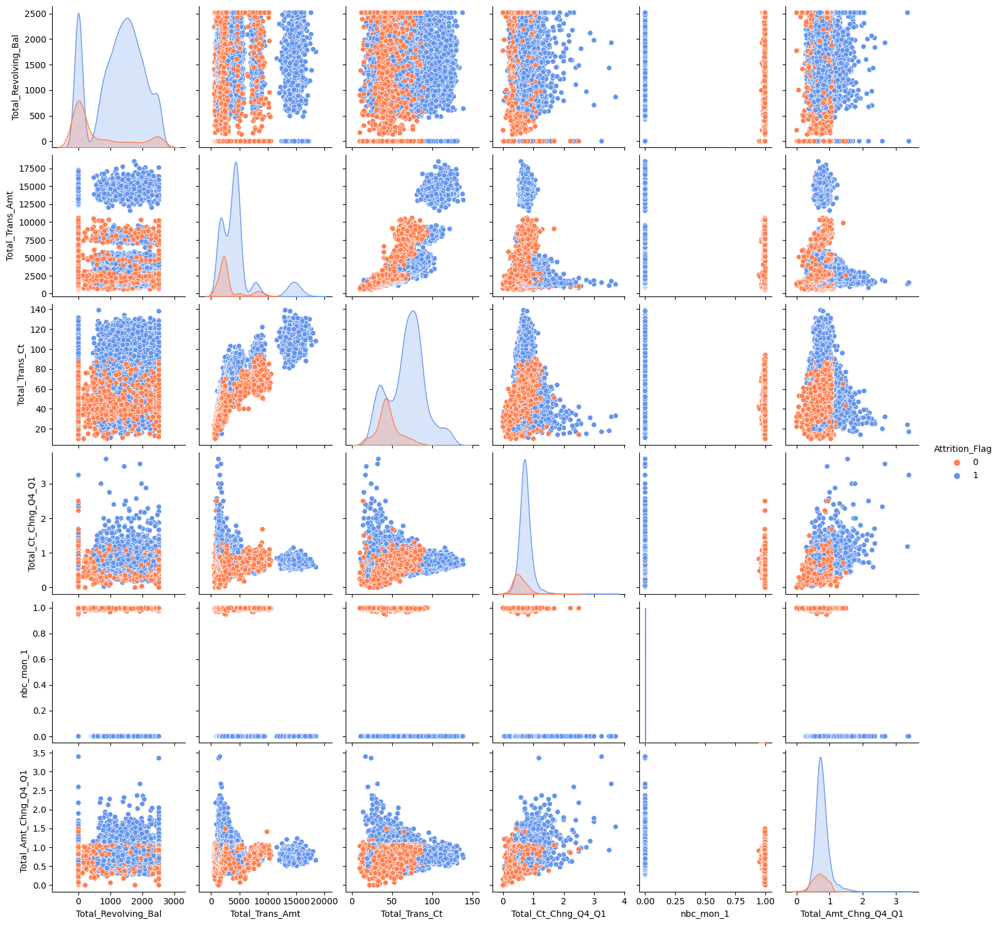

In [38]:
sns.pairplot(important_feature_data_2, hue='Attrition_Flag', diag_kind='kde', palette=['#FF7F50', '#6495ED']);

#### 5. Standardization

- To numericalized_df 

In [26]:
numericalized_df.columns

Index(['Attrition_Flag', 'Gender', 'Education_Level', 'Marital_Status',
       'Income_Category', 'Card_Category', 'Customer_Age', 'Dependent_count',
       'Months_on_book', 'Total_Relationship_Count', 'Months_Inactive_12_mon',
       'Contacts_Count_12_mon', 'Credit_Limit', 'Total_Revolving_Bal',
       'Avg_Open_To_Buy', 'Total_Amt_Chng_Q4_Q1', 'Total_Trans_Amt',
       'Total_Trans_Ct', 'Total_Ct_Chng_Q4_Q1', 'Avg_Utilization_Ratio',
       'nbc_mon_1', 'nbc_mon_2'],
      dtype='object')

In [14]:
from sklearn.preprocessing import StandardScaler 

scaler1 = StandardScaler()
scaled_numericalized_df = scaler1.fit_transform(numericalized_df)

In [41]:
# Calculate the standard deviation, proportion of variance, and mean of the scaled data
std_deviation = scaled_numericalized_df.std(axis=0)
mean = scaled_numericalized_df.mean(axis=0)

# Print the results
for i in range(len(std_deviation)):
    print(f"Variable {i+1}:")
    print("Standard Deviation:", std_deviation[i])
    print("Mean:", mean[i])
    print()

Variable 1:
Standard Deviation: 1.0
Mean: 1.4032640184854355e-17

Variable 2:
Standard Deviation: 1.0
Mean: 6.73566728873009e-17

Variable 3:
Standard Deviation: 1.0
Mean: 2.38554883142524e-17

Variable 4:
Standard Deviation: 1.0000000000000002
Mean: 5.893708877638828e-17

Variable 5:
Standard Deviation: 1.0
Mean: -2.5258752332737837e-17

Variable 6:
Standard Deviation: 1.0000000000000002
Mean: 0.0

Variable 7:
Standard Deviation: 1.0
Mean: 1.3331008175611637e-16

Variable 8:
Standard Deviation: 1.0
Mean: -7.577625699821351e-17

Variable 9:
Standard Deviation: 1.0
Mean: -3.3818662845498993e-16

Variable 10:
Standard Deviation: 1.0
Mean: -4.490444859153393e-17

Variable 11:
Standard Deviation: 0.9999999999999998
Mean: 1.6137536212582507e-16

Variable 12:
Standard Deviation: 0.9999999999999999
Mean: -7.858278503518438e-17

Variable 13:
Standard Deviation: 0.9999999999999999
Mean: 1.347133457746018e-16

Variable 14:
Standard Deviation: 1.0
Mean: -7.016320092427177e-17

Variable 15:
Standa

- To important_feature_data (reduced to only important_feature_data)

In [28]:
important_feature_data.columns

Index(['Total_Revolving_Bal', 'Total_Trans_Amt', 'Total_Trans_Ct',
       'Total_Ct_Chng_Q4_Q1', 'nbc_mon_1', 'nbc_mon_2', 'Attrition_Flag'],
      dtype='object')

In [19]:
scaler2 = StandardScaler()
scaled_important_feature_data = scaler2.fit_transform(important_feature_data)

In [44]:
# Calculate the standard deviation, proportion of variance, and mean of the scaled data
std_deviation = scaled_important_feature_data.std(axis=0)
mean = scaled_important_feature_data.mean(axis=0)

# Print the results
for i in range(len(std_deviation)):
    print(f"Variable {i+1}:")
    print("Standard Deviation:", std_deviation[i])
    print("Mean:", mean[i])
    print()

Variable 1:
Standard Deviation: 1.0
Mean: -7.016320092427177e-17

Variable 2:
Standard Deviation: 1.0
Mean: -8.980889718306786e-17

Variable 3:
Standard Deviation: 1.0
Mean: -2.2452224295766967e-16

Variable 4:
Standard Deviation: 0.9999999999999999
Mean: -3.1152461210376664e-16

Variable 5:
Standard Deviation: 1.0
Mean: -1.1226112147883482e-17

Variable 6:
Standard Deviation: 1.0
Mean: 6.73566728873009e-17

Variable 7:
Standard Deviation: 1.0
Mean: 1.4032640184854355e-17



- To important_feature_data_2 (reduced to only important_feature_data)

In [15]:
important_feature_data_2.columns

Index(['Total_Revolving_Bal', 'Total_Trans_Amt', 'Total_Trans_Ct',
       'Total_Ct_Chng_Q4_Q1', 'nbc_mon_1', 'Total_Amt_Chng_Q4_Q1',
       'Attrition_Flag'],
      dtype='object')

In [16]:
scaler3 = StandardScaler()
scaled_important_feature_data_2 = scaler3.fit_transform(important_feature_data_2)

In [47]:
# Calculate the standard deviation, proportion of variance, and mean of the scaled data
std_deviation = scaled_important_feature_data_2.std(axis=0)
mean = scaled_important_feature_data_2.mean(axis=0)

# Print the results
for i in range(len(std_deviation)):
    print(f"Variable {i+1}:")
    print("Standard Deviation:", std_deviation[i])
    print("Mean:", mean[i])
    print()

Variable 1:
Standard Deviation: 1.0
Mean: -7.016320092427177e-17

Variable 2:
Standard Deviation: 1.0
Mean: -8.980889718306786e-17

Variable 3:
Standard Deviation: 1.0
Mean: -2.2452224295766967e-16

Variable 4:
Standard Deviation: 0.9999999999999999
Mean: -3.1152461210376664e-16

Variable 5:
Standard Deviation: 1.0
Mean: -1.1226112147883482e-17

Variable 6:
Standard Deviation: 0.9999999999999998
Mean: 3.8309107704652383e-16

Variable 7:
Standard Deviation: 1.0
Mean: 1.4032640184854355e-17



#### 6. Principal Component Analysis (PCA)

- Apply PCA to scaled_numericalized_df

In [17]:
from sklearn.decomposition import PCA 

# Apply PCA to reduce the dimensionality of the dataset
pca_1 = PCA(n_components = 22)
pca_data = pca_1.fit_transform(scaled_numericalized_df)

- Find the Optimal Number of Principal Components (PCs)

Method 2 - Using Kaiser's Criterion

In [18]:
# Calculate the eigenvalues of the correlation matrix
corr_matrix = np.corrcoef(scaled_numericalized_df.T)
eigenvalues, eigenvectors = np.linalg.eig(corr_matrix)

# Identify the number of principal components to retain using Kaiser's criterion
num_components = sum(eigenvalues > 1)
print('Number of Principal Components to Retain:', num_components)

Number of Principal Components to Retain: 8


In [50]:
# Print the eigenvalues and explained variance ratio for each principal component
for i in range(pca_1.n_components_):
    print(f'PC{i+1}: Eigenvalue = {pca_1.explained_variance_[i]:.2f}, % Variance = {pca_1.explained_variance_ratio_[i]*100:.2f}%')

PC1: Eigenvalue = 3.71, % Variance = 16.84%
PC2: Eigenvalue = 3.12, % Variance = 14.17%
PC3: Eigenvalue = 1.90, % Variance = 8.65%
PC4: Eigenvalue = 1.79, % Variance = 8.13%
PC5: Eigenvalue = 1.33, % Variance = 6.06%
PC6: Eigenvalue = 1.24, % Variance = 5.63%
PC7: Eigenvalue = 1.19, % Variance = 5.39%
PC8: Eigenvalue = 1.02, % Variance = 4.64%
PC9: Eigenvalue = 1.00, % Variance = 4.54%
PC10: Eigenvalue = 0.98, % Variance = 4.46%
PC11: Eigenvalue = 0.96, % Variance = 4.36%
PC12: Eigenvalue = 0.90, % Variance = 4.07%
PC13: Eigenvalue = 0.69, % Variance = 3.14%
PC14: Eigenvalue = 0.63, % Variance = 2.85%
PC15: Eigenvalue = 0.59, % Variance = 2.66%
PC16: Eigenvalue = 0.40, % Variance = 1.82%
PC17: Eigenvalue = 0.22, % Variance = 0.98%
PC18: Eigenvalue = 0.21, % Variance = 0.95%
PC19: Eigenvalue = 0.15, % Variance = 0.67%
PC20: Eigenvalue = 0.00, % Variance = 0.00%
PC21: Eigenvalue = 0.00, % Variance = 0.00%
PC22: Eigenvalue = 0.00, % Variance = 0.00%


- Apply the Optimal Number of Principal Components (PCs) in PCA again

In [19]:
# optimal number of PCA = 8
pca = PCA(n_components = 8)
opt_pca_data = pca.fit_transform(scaled_numericalized_df)

In [52]:
# Print the eigenvalues and explained variance ratio for each principal component
for i in range(pca.n_components_):
    print(f'PC{i+1}: Eigenvalue = {pca.explained_variance_[i]:.2f}, % Variance = {pca.explained_variance_ratio_[i]*100:.2f}%')

PC1: Eigenvalue = 3.71, % Variance = 16.84%
PC2: Eigenvalue = 3.12, % Variance = 14.17%
PC3: Eigenvalue = 1.90, % Variance = 8.65%
PC4: Eigenvalue = 1.79, % Variance = 8.13%
PC5: Eigenvalue = 1.33, % Variance = 6.06%
PC6: Eigenvalue = 1.24, % Variance = 5.63%
PC7: Eigenvalue = 1.19, % Variance = 5.39%
PC8: Eigenvalue = 1.02, % Variance = 4.64%


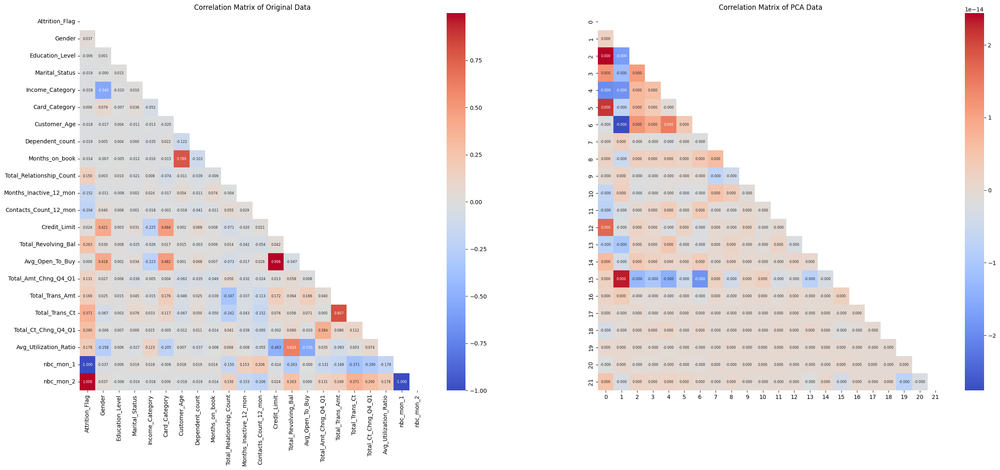

<Figure size 2400x1400 with 0 Axes>

In [53]:
# Calculate correlation matrix of original data
corr_original = numericalized_df.corr()

# Calculate correlation matrix of PCA data
pca_data_df = pd.DataFrame(pca_data)
corr_pca = pca_data_df.corr()

# Create subplots
fig, axes = plt.subplots(1, 2, figsize=(30, 12))

# Plot correlation matrix of original data
mask = np.triu(np.ones_like(corr_df, dtype=bool))

plt.figure(figsize=(24, 14))

sns.heatmap(corr_original, mask=mask, annot=True, cmap='coolwarm', fmt=".3f", ax=axes[0], annot_kws = {"fontsize" : 6})
axes[0].set_title('Correlation Matrix of Original Data')

# Plot correlation matrix of PCA data
sns.heatmap(corr_pca, mask=mask, annot=True, cmap='coolwarm', fmt=".3f", ax=axes[1], annot_kws = {"fontsize" : 6})
axes[1].set_title('Correlation Matrix of PCA Data')

# Adjust spacing between subplots
plt.tight_layout()

# Show the plot
plt.show()

#### 7. Unsupervised Learning for Clustering Algorithms

#### 7.1 K-Means Clustering Algorithm

1. Find optimal number of clusters (k) using Silhouette Method

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to '

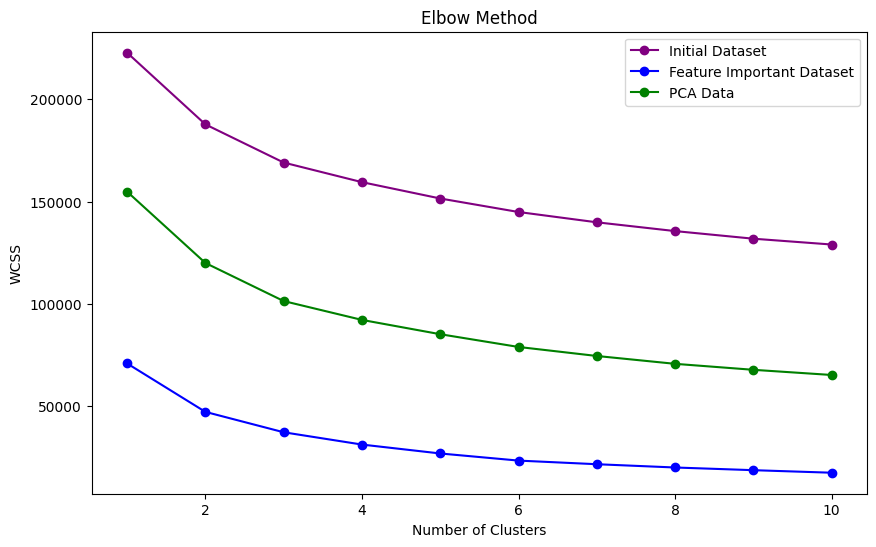

Elapsed time: 12.46 seconds


In [54]:
start_time = time.time()

datasets = [scaled_numericalized_df, scaled_important_feature_data_2,opt_pca_data] 
dataset_names = ['Initial Dataset', 'Feature Important Dataset', 'PCA Data'] 
colors = ['purple', 'blue', 'green']  

# Initialize lists to store the within-cluster sum of squares (WCSS) for each dataset
wcss_scores = [[] for _ in range(len(datasets))]

# Create a KMeans instance
kmeans = KMeans(random_state=42)

# Apply the Elbow method for each dataset
for i, dataset in enumerate(datasets):
    for num_clusters in range(1, 11):
        kmeans.set_params(n_clusters=num_clusters)
        kmeans.fit(dataset)
        wcss_scores[i].append(kmeans.inertia_)

# Plot the WCSS scores for all datasets in the same plot
plt.figure(figsize=(10, 6))
for i, scores in enumerate(wcss_scores):
    plt.plot(range(1, 11), scores, marker='o', label=dataset_names[i], color=colors[i])

plt.title('Elbow Method')
plt.xlabel('Number of Clusters')
plt.ylabel('WCSS')
plt.legend()
plt.show()

elapsed_time = time.time() - start_time
print("Elapsed time: {:.2f} seconds".format(elapsed_time))

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to '

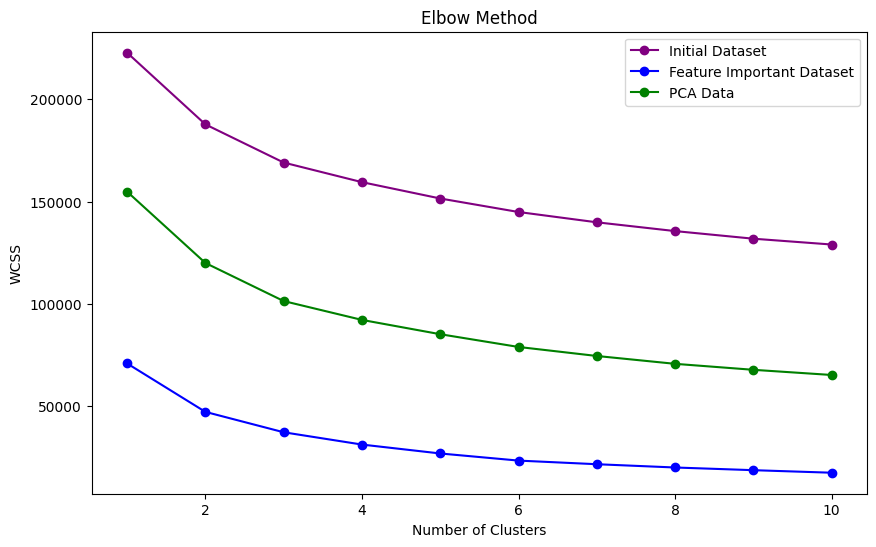

Elapsed time for Initial Dataset : 7.14 seconds
Elapsed time for Feature Important Dataset : 3.50 seconds
Elapsed time for PCA Data : 3.76 seconds


In [91]:
datasets = [scaled_numericalized_df, scaled_important_feature_data_2, opt_pca_data]
dataset_names = ['Initial Dataset', 'Feature Important Dataset', 'PCA Data']
colors = ['purple', 'blue', 'green']

# Initialize lists to store the within-cluster sum of squares (WCSS) and elapsed time for each dataset
wcss_scores = [[] for _ in range(len(datasets))]
elapsed_times = []

# Create a KMeans instance
kmeans = KMeans(random_state=42)

# Apply the Elbow method for each dataset
for i, dataset in enumerate(datasets):
    start_time = time.time()

    for num_clusters in range(1, 11):
        kmeans.set_params(n_clusters=num_clusters)
        kmeans.fit(dataset)
        wcss_scores[i].append(kmeans.inertia_)

    elapsed_time = time.time() - start_time
    elapsed_times.append(elapsed_time)

# Plot the WCSS scores for all datasets in the same plot
plt.figure(figsize=(10, 6))
for i, scores in enumerate(wcss_scores):
    plt.plot(range(1, 11), scores, marker='o', label=dataset_names[i], color=colors[i])

plt.title('Elbow Method')
plt.xlabel('Number of Clusters')
plt.ylabel('WCSS')
plt.legend()
plt.show()

# Print the elapsed time for each dataset
for i, time in enumerate(elapsed_times):
    print("Elapsed time for", dataset_names[i], ": {:.2f} seconds".format(time))

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to '

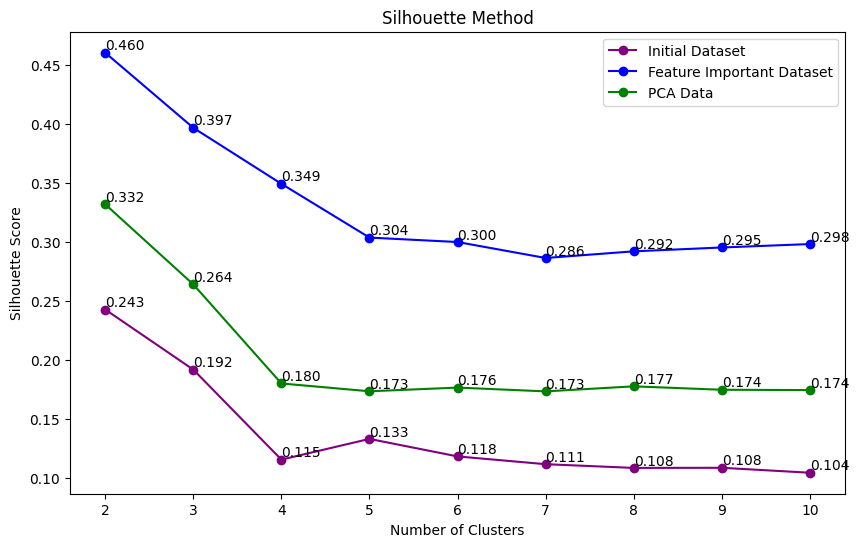

Elapsed time: 38.26 seconds


In [55]:
start_time = time.time()

datasets = [scaled_numericalized_df, scaled_important_feature_data_2,opt_pca_data] 
dataset_names = ['Initial Dataset', 'Feature Important Dataset', 'PCA Data'] 
colors = ['purple', 'blue', 'green']  

# Initialize lists to store silhouette scores for each dataset
silhouette_scores = [[] for _ in range(len(datasets))]

clusters_range = range(2, 11)

for i, dataset in enumerate(datasets):
    for num_clusters in clusters_range:
        kmeans = KMeans(n_clusters=num_clusters, init='k-means++', random_state=42)
        kmeans.fit(dataset)
        cluster_labels = kmeans.labels_
        silhouette_avg = silhouette_score(dataset, cluster_labels)
        silhouette_scores[i].append(silhouette_avg)

# Plot the Silhouette scores for all datasets in the same plot
plt.figure(figsize=(10, 6))
for i, scores in enumerate(silhouette_scores):
    plt.plot(clusters_range, scores, marker='o', label=dataset_names[i], color=colors[i])

plt.xlabel('Number of Clusters')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Method')
plt.legend()

# Add labels for each point on the plot for each dataset
for i, scores in enumerate(silhouette_scores):
    for x, y in zip(clusters_range, scores):
        plt.text(x, y, f'{y:.3f}', ha='left', va='bottom')

plt.show()

elapsed_time = time.time() - start_time
print("Elapsed time: {:.2f} seconds".format(elapsed_time))

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to '

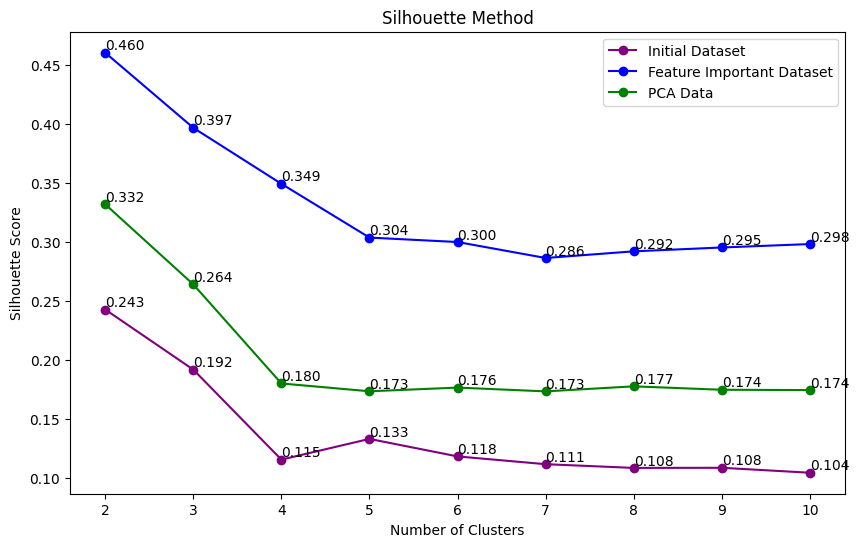

Elapsed time for Initial Dataset : 15.44 seconds
Elapsed time for Feature Important Dataset : 13.76 seconds
Elapsed time for PCA Data : 13.06 seconds


In [95]:
import time

datasets = [scaled_numericalized_df, scaled_important_feature_data_2,opt_pca_data] 
dataset_names = ['Initial Dataset', 'Feature Important Dataset', 'PCA Data'] 
colors = ['purple', 'blue', 'green']  

# Initialize lists to store silhouette scores for each dataset
silhouette_scores = [[] for _ in range(len(datasets))]

clusters_range = range(2, 11)

elapsed_times = []

for i, dataset in enumerate(datasets):
    start_time = time.time()
    
    for num_clusters in clusters_range:
        kmeans = KMeans(n_clusters=num_clusters, init='k-means++', random_state=42)
        kmeans.fit(dataset)
        cluster_labels = kmeans.labels_
        silhouette_avg = silhouette_score(dataset, cluster_labels)
        silhouette_scores[i].append(silhouette_avg)
    
    elapsed_time = time.time() - start_time
    elapsed_times.append(elapsed_time)

# Plot the Silhouette scores for all datasets in the same plot
plt.figure(figsize=(10, 6))
for i, scores in enumerate(silhouette_scores):
    plt.plot(clusters_range, scores, marker='o', label=dataset_names[i], color=colors[i])

plt.xlabel('Number of Clusters')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Method')
plt.legend()

# Add labels for each point on the plot for each dataset
for i, scores in enumerate(silhouette_scores):
    for x, y in zip(clusters_range, scores):
        plt.text(x, y, f'{y:.3f}', ha='left', va='bottom')

plt.show()

# Print the elapsed time for each dataset
for i, time in enumerate(elapsed_times):
    print("Elapsed time for", dataset_names[i], ": {:.2f} seconds".format(time))


In [56]:
# Option 2
# Determine the optimal number of clusters using the silhouette score
best_silhouette = -1
best_k = None
max_clusters = 11

for k in range(2, max_clusters + 1):
    kmeans = KMeans(n_clusters=k, random_state=42)
    cluster_labels = kmeans.fit_predict(scaled_numericalized_df)
    silhouette_avg = silhouette_score(scaled_numericalized_df, cluster_labels)

    if silhouette_avg > best_silhouette:
        best_silhouette = silhouette_avg
        best_k = k

# Train the K-means algorithm with the optimal number of clusters
kmeans = KMeans(n_clusters=best_k, random_state=42)
cluster_labels = kmeans.fit_predict(scaled_numericalized_df)

silhouette_avg = silhouette_score(scaled_numericalized_df, cluster_labels)
print("For K = {}, the average Silhouette score is: {}".format(best_k, silhouette_avg))

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to '

For K = 2, the average Silhouette score is: 0.2425235583364459


2. Fit the model and evaluate the performance

- Apply scaled_numericalized_df

In [57]:
start_time = time.time()

# fit K-means model
kmeans = KMeans(n_clusters = 2, init = 'k-means++', random_state = 42)
kmeans.fit(scaled_numericalized_df)

labels_kmeans = kmeans.labels_

silhouette_kmeans = silhouette_score(scaled_numericalized_df, labels_kmeans)
davies_bouldin_kmeans = davies_bouldin_score(scaled_numericalized_df, labels_kmeans)
calinski_harabasz_kmeans = calinski_harabasz_score(scaled_numericalized_df, labels_kmeans)

print("Silhouette Score:", silhouette_kmeans)
print("Davies-Bouldin Score:", davies_bouldin_kmeans)
print("Calinski-Harabasz Score:", calinski_harabasz_kmeans)

elapsed_time = time.time() - start_time
print("Elapsed time: {:.2f} seconds".format(elapsed_time))

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Silhouette Score: 0.2425235583364459
Davies-Bouldin Score: 1.629135504954874
Calinski-Harabasz Score: 1889.417846419457
Elapsed time: 1.14 seconds


In [35]:
from scipy.spatial import distance

# fit K-means model
kmeans = KMeans(n_clusters = 2, init = 'k-means++', random_state = 42)
kmeans.fit(scaled_numericalized_df)

labels_kmeans = kmeans.labels_

num_obs = np.bincount(labels_kmeans)
print("Number of observations in each cluster:", num_obs)

# Calculate the distance of each point to its cluster centroid
distances = distance.cdist(scaled_numericalized_df, kmeans.cluster_centers_, 'euclidean')

# For each point, get the distance to the centroid of its cluster
cluster_distances = distances[np.arange(len(distances)), labels_kmeans]

# Calculate max and average dissimilarity for each cluster
for i in range(kmeans.n_clusters):
    cluster_dissimilarity = cluster_distances[labels_kmeans == i]
    print(f"Cluster {i}: Max dissimilarity = {np.max(cluster_dissimilarity)}, Average dissimilarity = {np.mean(cluster_dissimilarity)}")


# Calculate the distance between each pair of centroids
centroid_distances = distance.cdist(kmeans.cluster_centers_, kmeans.cluster_centers_, 'euclidean')

# The diagonal of the distance matrix will be zeros (distance of a centroid to itself). 
# We replace these zeros with a large value (np.inf) to ignore them when finding the minimum
np.fill_diagonal(centroid_distances, np.inf)

# Find the minimum distance for each cluster
isolation = np.min(centroid_distances, axis=1)
print("Isolation for each cluster:", isolation)

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Number of observations in each cluster: [1627 8500]
Cluster 0: Max dissimilarity = 9.172740918481065, Average dissimilarity = 4.058151973527834
Cluster 1: Max dissimilarity = 17.012121877652255, Average dissimilarity = 4.193839304594749
Isolation for each cluster: [5.06525777 5.06525777]


- Apply scaled_important_feature_data_2

In [58]:
start_time = time.time()

# fit K-means model
kmeans = KMeans(n_clusters = 2, init = 'k-means++', random_state = 42)
kmeans.fit(scaled_important_feature_data_2)

labels_kmeans_2 = kmeans.labels_

silhouette_kmeans = silhouette_score(scaled_important_feature_data_2, labels_kmeans_2)
davies_bouldin_kmeans = davies_bouldin_score(scaled_important_feature_data_2, labels_kmeans_2)
calinski_harabasz_kmeans = calinski_harabasz_score(scaled_important_feature_data_2, labels_kmeans_2)

print("Silhouette Score:", silhouette_kmeans)
print("Davies-Bouldin Score:", davies_bouldin_kmeans)
print("Calinski-Harabasz Score:", calinski_harabasz_kmeans)

elapsed_time = time.time() - start_time
print("Elapsed time: {:.2f} seconds".format(elapsed_time))

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Silhouette Score: 0.4604317740866476
Davies-Bouldin Score: 0.9029510919045778
Calinski-Harabasz Score: 5073.94890046707
Elapsed time: 1.44 seconds


In [37]:
# fit K-means model
kmeans = KMeans(n_clusters = 2, init = 'k-means++', random_state = 42)
kmeans.fit(scaled_important_feature_data_2)

labels_kmeans_2 = kmeans.labels_

num_obs = np.bincount(labels_kmeans_2)
print("Number of observations in each cluster:", num_obs)

# Calculate the distance of each point to its cluster centroid
distances = distance.cdist(scaled_important_feature_data_2, kmeans.cluster_centers_, 'euclidean')

# For each point, get the distance to the centroid of its cluster
cluster_distances = distances[np.arange(len(distances)), labels_kmeans_2]

# Calculate max and average dissimilarity for each cluster
for i in range(kmeans.n_clusters):
    cluster_dissimilarity = cluster_distances[labels_kmeans_2 == i]
    print(f"Cluster {i}: Max dissimilarity = {np.max(cluster_dissimilarity)}, Average dissimilarity = {np.mean(cluster_dissimilarity)}")


# Calculate the distance between each pair of centroids
centroid_distances = distance.cdist(kmeans.cluster_centers_, kmeans.cluster_centers_, 'euclidean')

# The diagonal of the distance matrix will be zeros (distance of a centroid to itself). 
# We replace these zeros with a large value (np.inf) to ignore them when finding the minimum
np.fill_diagonal(centroid_distances, np.inf)

# Find the minimum distance for each cluster
isolation = np.min(centroid_distances, axis=1)
print("Isolation for each cluster:", isolation)

Number of observations in each cluster: [1627 8500]
Cluster 0: Max dissimilarity = 8.421548243513357, Average dissimilarity = 1.8355792022784077
Cluster 1: Max dissimilarity = 16.197601202579126, Average dissimilarity = 1.9232888879092376
Isolation for each cluster: [4.16287009 4.16287009]


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


- Apply opt_pca_data

In [59]:
start_time = time.time()

# fit K-means model
kmeans = KMeans(n_clusters = 2, init = 'k-means++', random_state = 42)
kmeans.fit(opt_pca_data)

labels_kmeans_3 = kmeans.labels_

silhouette_kmeans = silhouette_score(opt_pca_data, labels_kmeans_3)
davies_bouldin_kmeans = davies_bouldin_score(opt_pca_data, labels_kmeans_3)
calinski_harabasz_kmeans = calinski_harabasz_score(opt_pca_data, labels_kmeans_3)

print("Silhouette Score:", silhouette_kmeans)
print("Davies-Bouldin Score:", davies_bouldin_kmeans)
print("Calinski-Harabasz Score:", calinski_harabasz_kmeans)

elapsed_time = time.time() - start_time
print("Elapsed time: {:.2f} seconds".format(elapsed_time))

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Silhouette Score: 0.33179389516993385
Davies-Bouldin Score: 1.274773023604264
Calinski-Harabasz Score: 2941.1794399482283
Elapsed time: 1.12 seconds


In [38]:
# fit K-means model
kmeans = KMeans(n_clusters = 2, init = 'k-means++', random_state = 42)
kmeans.fit(opt_pca_data)

labels_kmeans_3 = kmeans.labels_

num_obs = np.bincount(labels_kmeans_3)
print("Number of observations in each cluster:", num_obs)

# Calculate the distance of each point to its cluster centroid
distances = distance.cdist(opt_pca_data, kmeans.cluster_centers_, 'euclidean')

# For each point, get the distance to the centroid of its cluster
cluster_distances = distances[np.arange(len(distances)), labels_kmeans_3]

# Calculate max and average dissimilarity for each cluster
for i in range(kmeans.n_clusters):
    cluster_dissimilarity = cluster_distances[labels_kmeans_3 == i]
    print(f"Cluster {i}: Max dissimilarity = {np.max(cluster_dissimilarity)}, Average dissimilarity = {np.mean(cluster_dissimilarity)}")


# Calculate the distance between each pair of centroids
centroid_distances = distance.cdist(kmeans.cluster_centers_, kmeans.cluster_centers_, 'euclidean')

# The diagonal of the distance matrix will be zeros (distance of a centroid to itself). 
# We replace these zeros with a large value (np.inf) to ignore them when finding the minimum
np.fill_diagonal(centroid_distances, np.inf)

# Find the minimum distance for each cluster
isolation = np.min(centroid_distances, axis=1)
print("Isolation for each cluster:", isolation)

Number of observations in each cluster: [8500 1627]
Cluster 0: Max dissimilarity = 16.34409183406737, Average dissimilarity = 3.2854504918940544
Cluster 1: Max dissimilarity = 7.191633595565618, Average dissimilarity = 3.1552877019567216
Isolation for each cluster: [5.05245686 5.05245686]


/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


3. Plot the cluster distribution

- Apply scaled_numericalized_df

In [60]:
numericalized_df.columns

Index(['Attrition_Flag', 'Gender', 'Education_Level', 'Marital_Status',
       'Income_Category', 'Card_Category', 'Customer_Age', 'Dependent_count',
       'Months_on_book', 'Total_Relationship_Count', 'Months_Inactive_12_mon',
       'Contacts_Count_12_mon', 'Credit_Limit', 'Total_Revolving_Bal',
       'Avg_Open_To_Buy', 'Total_Amt_Chng_Q4_Q1', 'Total_Trans_Amt',
       'Total_Trans_Ct', 'Total_Ct_Chng_Q4_Q1', 'Avg_Utilization_Ratio',
       'nbc_mon_1', 'nbc_mon_2'],
      dtype='object')

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


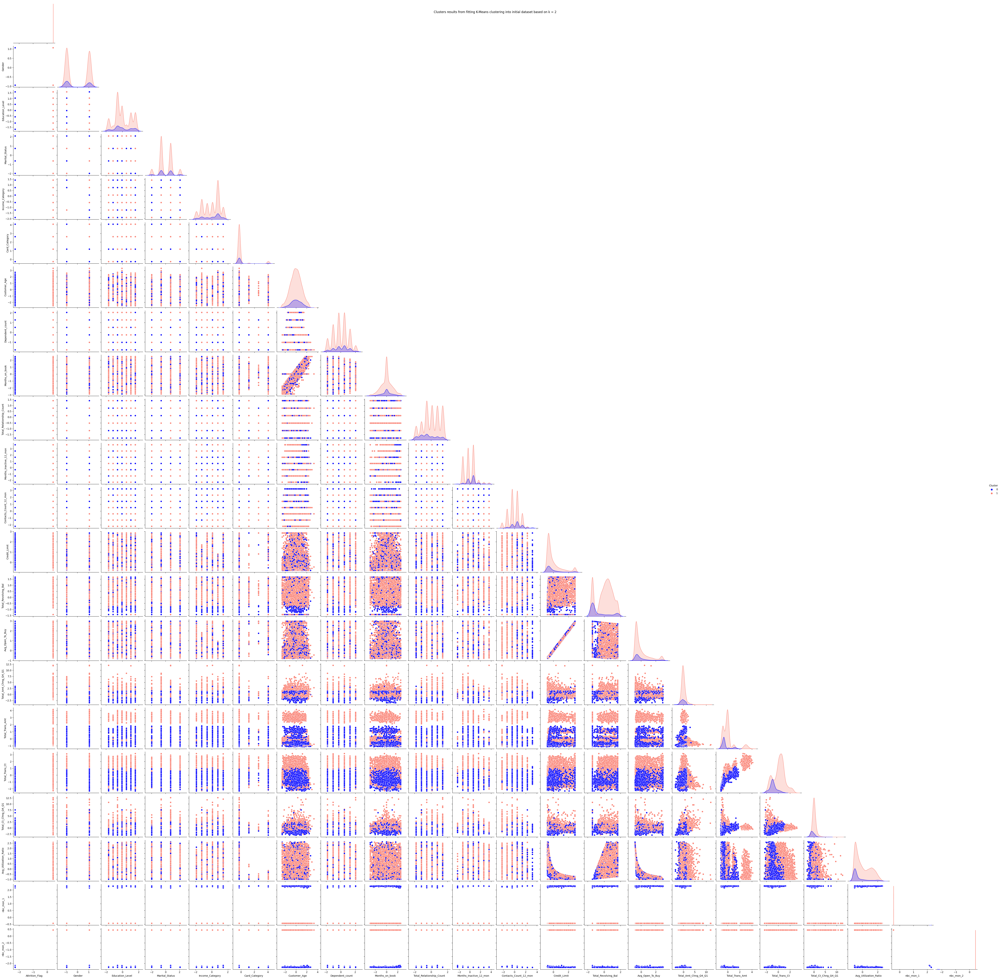

In [85]:
kmeans = KMeans(n_clusters=2, init='k-means++', random_state=42)
kmeans_fit = kmeans.fit(scaled_numericalized_df)

labels_kmeans_2 = kmeans_fit.labels_

# Assuming your scaled data is a numpy array, convert it to a dataframe
df_scaled_num = pd.DataFrame(scaled_numericalized_df, columns=['Attrition_Flag', 'Gender', 'Education_Level', 'Marital_Status',
       'Income_Category', 'Card_Category', 'Customer_Age', 'Dependent_count',
       'Months_on_book', 'Total_Relationship_Count', 'Months_Inactive_12_mon',
       'Contacts_Count_12_mon', 'Credit_Limit', 'Total_Revolving_Bal',
       'Avg_Open_To_Buy', 'Total_Amt_Chng_Q4_Q1', 'Total_Trans_Amt',
       'Total_Trans_Ct', 'Total_Ct_Chng_Q4_Q1', 'Avg_Utilization_Ratio',
       'nbc_mon_1', 'nbc_mon_2'])
# Add the cluster labels to your dataframe
df_scaled_num['Cluster'] = labels_kmeans_2

# Now you can create the pairplot
sns.pairplot(df_scaled_num, hue='Cluster', corner=True, diag_kind="kde", palette=['blue', 'salmon'])
plt.suptitle("Clusters results from fitting K-Means clustering into initial dataset based on k = 2")
plt.show()

- Apply scaled_important_feature_data_2

In [62]:
important_feature_data_2.columns

Index(['Total_Revolving_Bal', 'Total_Trans_Amt', 'Total_Trans_Ct',
       'Total_Ct_Chng_Q4_Q1', 'nbc_mon_1', 'Total_Amt_Chng_Q4_Q1',
       'Attrition_Flag'],
      dtype='object')

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


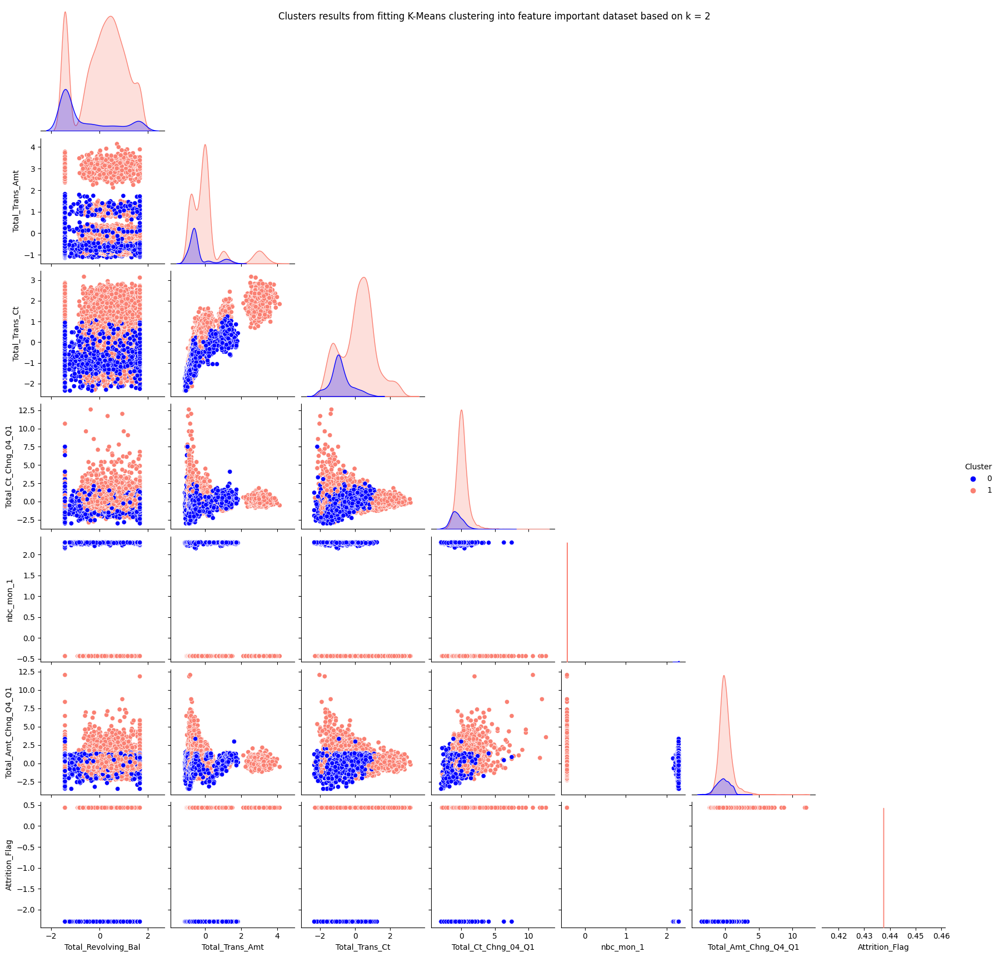

In [84]:
kmeans = KMeans(n_clusters=2, init='k-means++', random_state=42)
kmeans_fit = kmeans.fit(scaled_important_feature_data_2)

labels_kmeans_2 = kmeans_fit.labels_

# Assuming your scaled data is a numpy array, convert it to a dataframe
df_scaled_imp = pd.DataFrame(scaled_important_feature_data_2, columns=['Total_Revolving_Bal','Total_Trans_Amt','Total_Trans_Ct','Total_Ct_Chng_04_Q1','nbc_mon_1','Total_Amt_Chng_Q4_Q1','Attrition_Flag'])

# Add the cluster labels to your dataframe
df_scaled_imp['Cluster'] = labels_kmeans_2

# Now you can create the pairplot
sns.pairplot(df_scaled_imp, hue='Cluster', corner=True, diag_kind="kde", palette=['blue', 'salmon'])
plt.suptitle("Clusters results from fitting K-Means clustering into feature important dataset based on k = 2")
plt.show()

- Apply opt_pca_data

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


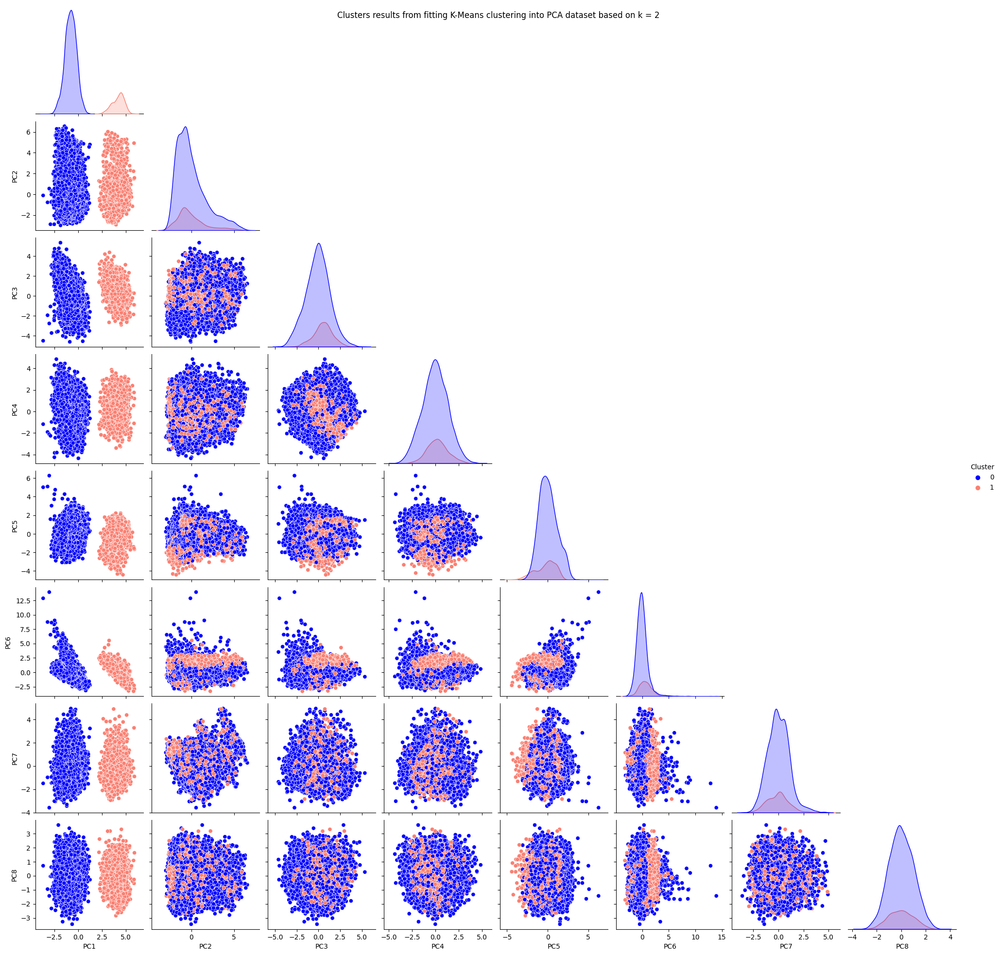

In [86]:
kmeans = KMeans(n_clusters=2, init='k-means++', random_state=42)
kmeans_fit = kmeans.fit(opt_pca_data)

labels_kmeans_2 = kmeans_fit.labels_

# Assuming your scaled data is a numpy array, convert it to a dataframe
df_scaled_imp = pd.DataFrame(opt_pca_data, columns=['PC1','PC2','PC3','PC4','PC5','PC6','PC7','PC8'])
# Add the cluster labels to your dataframe
df_scaled_imp['Cluster'] = labels_kmeans_2

# Now you can create the pairplot
sns.pairplot(df_scaled_imp, hue='Cluster', corner=True, diag_kind="kde", palette=['blue', 'salmon'])
plt.suptitle("Clusters results from fitting K-Means clustering into PCA dataset based on k = 2")
plt.show()

See components in PCA object/ characteristic of each cluster (Ref.PCA Visualization)

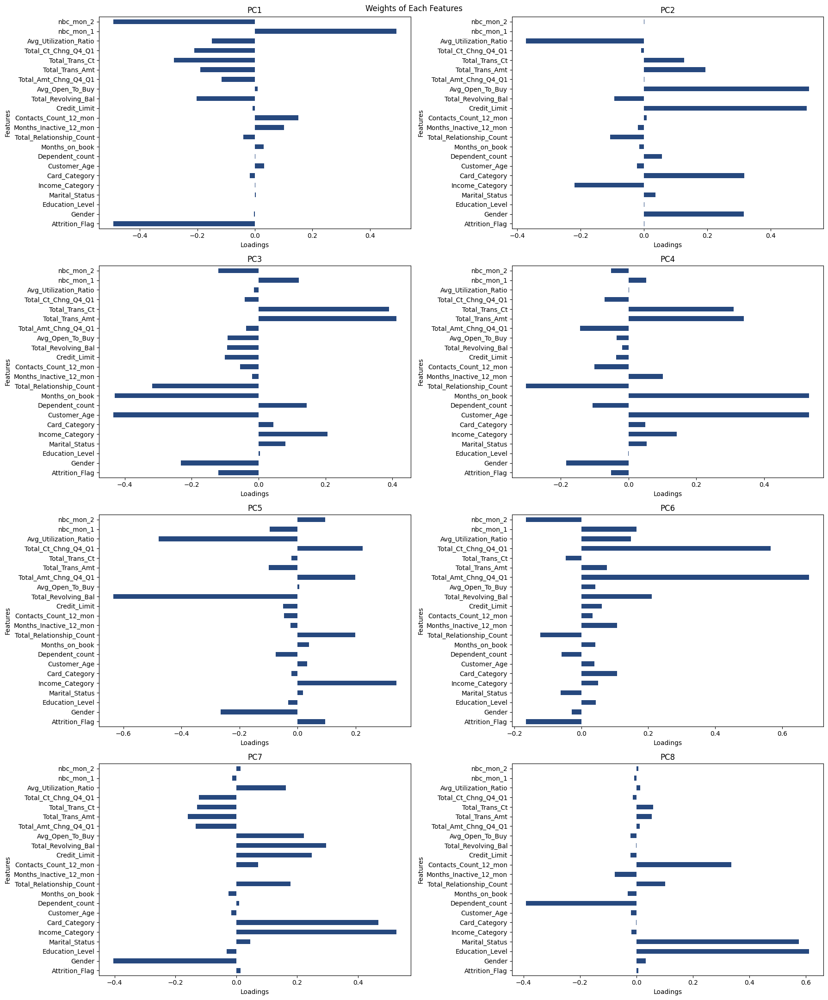

In [65]:
n_components = 8  # Number of principal components
loadings = pca.components_
df_loadings = pd.DataFrame(loadings, columns=numericalized_df.columns)

fig, axs = plt.subplots(4, 2, figsize=(18, 22))  
axs = axs.flatten()  # Flatten the subplot array for easier indexing

for pc_index in range(n_components):
    ax = axs[pc_index]  # Select the current subplot
    
    pc_loadings = df_loadings.loc[pc_index]
    pc_loadings.plot(kind='barh', ax=ax)
    
    ax.set_xlabel('Loadings')
    ax.set_ylabel('Features')
    ax.set_title(f'PC{pc_index+1}')  # Add the principal component number to the title


plt.suptitle("Weights of Each Features")  
plt.tight_layout()
plt.show()  

#### 7.2 Hierarchical Clustering Algorithm

1. Find Optimal Number of Cluster using Dendrogram

- Ward's method

Elapsed time for Initial Dataset : 7.58 seconds
Elapsed time for Feature Important Dataset : 6.15 seconds
Elapsed time for PCA Data : 6.51 seconds


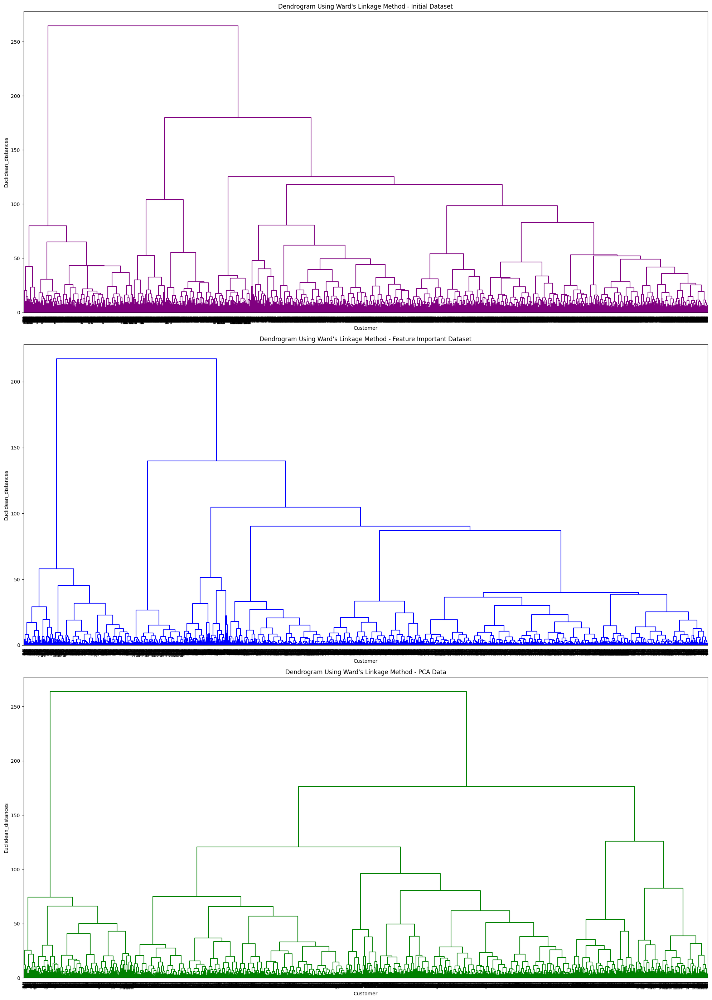

In [66]:
datasets = [scaled_numericalized_df, scaled_important_feature_data_2,opt_pca_data] 
dataset_names = ['Initial Dataset', 'Feature Important Dataset', 'PCA Data'] 
colors = ['purple', 'blue', 'green']  

plt.figure(figsize=(20, 28))

for i, dataset in enumerate(datasets):
    start_time = time.time()

    plt.subplot(len(datasets), 1, i+1)
    dendrogram = sch.dendrogram(sch.linkage(dataset, method='ward'), color_threshold=0, above_threshold_color=colors[i])
    plt.title("Dendrogram Using Ward's Linkage Method - " + dataset_names[i])
    plt.xlabel('Customer')
    plt.ylabel('Euclidean_distances')

    elapsed_time = time.time() - start_time
    print("Elapsed time for", dataset_names[i], ": {:.2f} seconds".format(elapsed_time))


plt.tight_layout()
plt.show()


- Average method

Elapsed time for Initial Dataset : 7.48 seconds
Elapsed time for Feature Important Dataset : 6.41 seconds
Elapsed time for PCA Data : 6.28 seconds


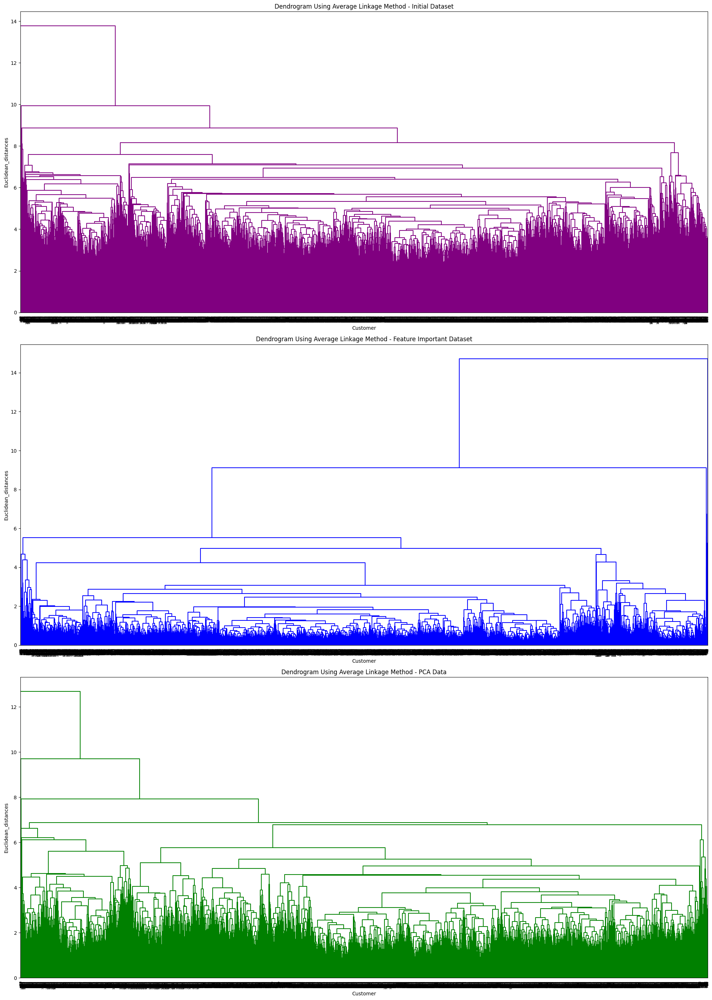

In [67]:
datasets = [scaled_numericalized_df, scaled_important_feature_data_2, opt_pca_data]
dataset_names = ['Initial Dataset', 'Feature Important Dataset', 'PCA Data']
colors = ['purple', 'blue', 'green']

plt.figure(figsize=(20, 28))

for i, dataset in enumerate(datasets):
    start_time = time.time()

    plt.subplot(len(datasets), 1, i+1)
    dendrogram = sch.dendrogram(sch.linkage(dataset, method='average'), color_threshold=0, above_threshold_color=colors[i])
    plt.title('Dendrogram Using Average Linkage Method - ' + dataset_names[i])
    plt.xlabel('Customer')
    plt.ylabel('Euclidean_distances')

    elapsed_time = time.time() - start_time
    print("Elapsed time for", dataset_names[i], ": {:.2f} seconds".format(elapsed_time))

plt.tight_layout()
plt.show()

- Complete Linkage Method

Elapsed time for Initial Dataset : 7.33 seconds
Elapsed time for Feature Important Dataset : 6.12 seconds
Elapsed time for PCA Data : 6.43 seconds


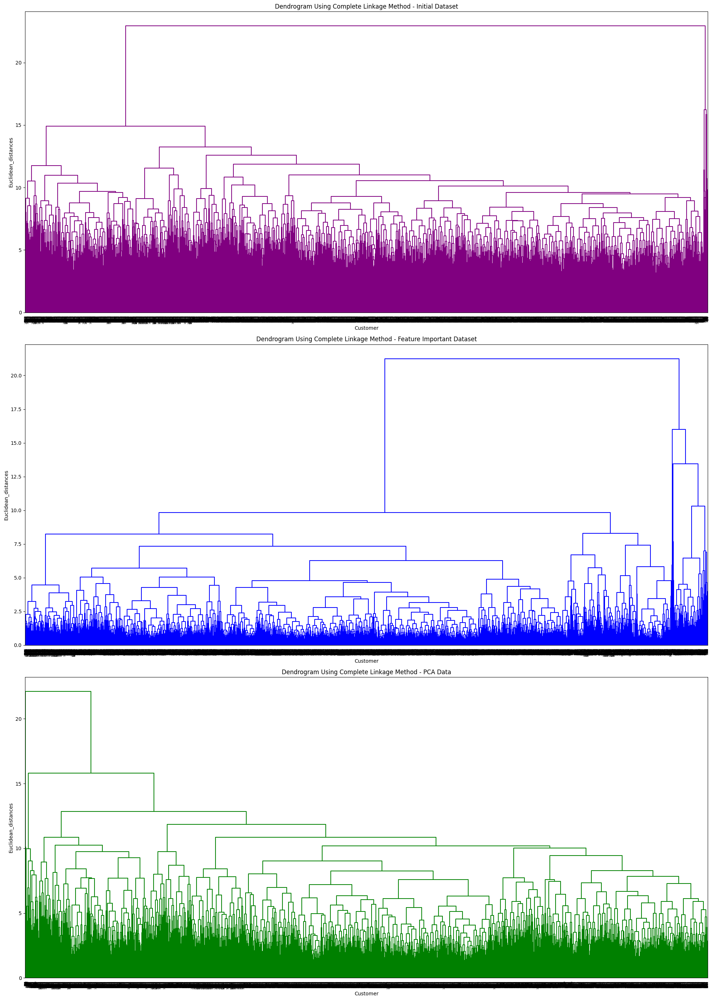

In [68]:
datasets = [scaled_numericalized_df, scaled_important_feature_data_2, opt_pca_data]
dataset_names = ['Initial Dataset', 'Feature Important Dataset', 'PCA Data']
colors = ['purple', 'blue', 'green']

plt.figure(figsize=(20, 28))

for i, dataset in enumerate(datasets):
    start_time = time.time()

    plt.subplot(len(datasets), 1, i+1)
    dendrogram = sch.dendrogram(sch.linkage(dataset, method='complete'), color_threshold=0, above_threshold_color=colors[i])
    plt.title('Dendrogram Using Complete Linkage Method - ' + dataset_names[i])
    plt.xlabel('Customer')
    plt.ylabel('Euclidean_distances')

    elapsed_time = time.time() - start_time
    print("Elapsed time for", dataset_names[i], ": {:.2f} seconds".format(elapsed_time))

plt.tight_layout()
plt.show()

2. Fit the model and evaluate the performance when k = 2

- Apply scaled_numericalized_df

In [69]:
start_time = time.time()

agg_cluster = AgglomerativeClustering(n_clusters = 2, affinity = 'euclidean', linkage = 'ward')
hiera_cluster = agg_cluster.fit_predict(scaled_numericalized_df)

silhouette_hiera = silhouette_score(scaled_numericalized_df, hiera_cluster)
davies_bouldin_hiera = davies_bouldin_score(scaled_numericalized_df, hiera_cluster)
calinski_harabasz_hiera = calinski_harabasz_score(scaled_numericalized_df, hiera_cluster)

print("Silhouette Score:", silhouette_hiera)
print("Davies-Bouldin Score:", davies_bouldin_hiera)
print("Calinski-Harabasz Score:", calinski_harabasz_hiera)

elapsed_time = time.time() - start_time
print("Elapsed time: {:.2f} seconds".format(elapsed_time))

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/cluster/_agglomerative.py:983: FutureWarning: Attribute `affinity` was deprecated in version 1.2 and will be removed in 1.4. Use `metric` instead
  warnings.warn(


Silhouette Score: 0.2421278965464173
Davies-Bouldin Score: 1.62815611576524
Calinski-Harabasz Score: 1886.0051371251107
Elapsed time: 2.85 seconds


In [44]:
from scipy.spatial.distance import pdist, squareform
from sklearn.metrics.pairwise import euclidean_distances

agg_cluster = AgglomerativeClustering(n_clusters = 2, affinity = 'euclidean', linkage = 'ward')
hiera_cluster = agg_cluster.fit_predict(scaled_numericalized_df)

# Get number of observations in each cluster
n_obs = np.bincount(hiera_cluster)

print("Number of observations in each cluster:", n_obs)

# Calculate pairwise distances for all data points
distances = euclidean_distances(scaled_numericalized_df, scaled_numericalized_df)

# Compute max and average dissimilarity for each cluster
for i in range(2):  # Assuming 2 clusters
    cluster_distances = distances[hiera_cluster == i][:, hiera_cluster == i]
    max_dissimilarity = np.max(cluster_distances)
    avg_dissimilarity = np.mean(cluster_distances)
    print(f"Cluster {i}: Max dissimilarity = {max_dissimilarity}, Average dissimilarity = {avg_dissimilarity}")

# Compute isolation (distance to nearest cluster) for each cluster
isolation = np.min(squareform(pdist(np.array([np.mean(scaled_numericalized_df[hiera_cluster == i], axis=0) for i in range(2)]))), axis=0)
print("Isolation for each cluster: [{:.7f}, {:.7f}]".format(isolation[0], isolation[1]))

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/cluster/_agglomerative.py:983: FutureWarning: Attribute `affinity` was deprecated in version 1.2 and will be removed in 1.4. Use `metric` instead
  warnings.warn(


Number of observations in each cluster: [8503 1624]
Cluster 0: Max dissimilarity = 20.808051296862306, Average dissimilarity = 5.9498963604816675
Cluster 1: Max dissimilarity = 11.754835703600389, Average dissimilarity = 5.741031296824736
Isolation for each cluster: [0.0000000, 0.0000000]


revised (23 June 2023)

In [21]:
from scipy.spatial.distance import pdist, squareform
from sklearn.metrics.pairwise import euclidean_distances

agg_cluster = AgglomerativeClustering(n_clusters=2, affinity='euclidean', linkage='ward')
hiera_cluster = agg_cluster.fit_predict(scaled_numericalized_df)

# Get number of observations in each cluster
n_obs = np.bincount(hiera_cluster)

print("Number of observations in each cluster:", n_obs)

# Calculate pairwise distances for all data points
distances = euclidean_distances(scaled_numericalized_df, scaled_numericalized_df)

# Compute max and average dissimilarity for each cluster
for i in range(2):  # Assuming 2 clusters
    cluster_distances = distances[hiera_cluster == i][:, hiera_cluster == i]
    max_dissimilarity = np.max(cluster_distances)
    avg_dissimilarity = np.mean(cluster_distances)
    print(f"Cluster {i}: Max dissimilarity = {max_dissimilarity}, Average dissimilarity = {avg_dissimilarity}")

# Compute isolation (distance to nearest cluster) for each cluster
isolation_values = []
for i in range(2):  # Assuming 2 clusters
    cluster_distances = distances[hiera_cluster == i][:, hiera_cluster != i]
    isolation_value = np.min(cluster_distances)
    isolation_values.append(isolation_value)

# Print the isolation values for each cluster
for i, isolation in enumerate(isolation_values):
    print(f"Cluster {i}: Isolation Value = {isolation}")

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/cluster/_agglomerative.py:983: FutureWarning: Attribute `affinity` was deprecated in version 1.2 and will be removed in 1.4. Use `metric` instead
  warnings.warn(


Number of observations in each cluster: [8503 1624]
Cluster 0: Max dissimilarity = 20.808051296862306, Average dissimilarity = 5.9498963604816675
Cluster 1: Max dissimilarity = 11.754835703600389, Average dissimilarity = 5.741031296824736
Cluster 0: Isolation Value = 3.9872971640346995
Cluster 1: Isolation Value = 3.9872971640346995


- Apply scaled_important_feature_data_2

In [40]:
start_time = time.time()

agg_cluster = AgglomerativeClustering(n_clusters = 2, affinity = 'euclidean', linkage = 'ward')
hiera_cluster_2 = agg_cluster.fit_predict(scaled_important_feature_data_2)

silhouette_hiera = silhouette_score(scaled_important_feature_data_2, hiera_cluster_2)
davies_bouldin_hiera = davies_bouldin_score(scaled_important_feature_data_2, hiera_cluster_2)
calinski_harabasz_hiera = calinski_harabasz_score(scaled_important_feature_data_2, hiera_cluster_2)

print("Silhouette Score:", silhouette_hiera)
print("Davies-Bouldin Score:", davies_bouldin_hiera)
print("Calinski-Harabasz Score:", calinski_harabasz_hiera)

elapsed_time = time.time() - start_time
print("Elapsed time: {:.2f} seconds".format(elapsed_time))

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/cluster/_agglomerative.py:983: FutureWarning: Attribute `affinity` was deprecated in version 1.2 and will be removed in 1.4. Use `metric` instead
  warnings.warn(


Silhouette Score: 0.4599965796471321
Davies-Bouldin Score: 0.9014004716743294
Calinski-Harabasz Score: 5068.561008605812
Elapsed time: 3.01 seconds


In [43]:
from scipy.spatial.distance import pdist, squareform
from sklearn.metrics.pairwise import euclidean_distances

agg_cluster = AgglomerativeClustering(n_clusters = 2, affinity = 'euclidean', linkage = 'ward')
hiera_cluster_2 = agg_cluster.fit_predict(scaled_important_feature_data_2)

# Get number of observations in each cluster
n_obs = np.bincount(hiera_cluster_2)

print("Number of observations in each cluster:", n_obs)

# Calculate pairwise distances for all data points
distances = euclidean_distances(scaled_important_feature_data_2, scaled_important_feature_data_2)

# Compute max and average dissimilarity for each cluster
for i in range(2):  # Assuming 2 clusters
    cluster_distances = distances[hiera_cluster_2 == i][:, hiera_cluster_2 == i]
    max_dissimilarity = np.max(cluster_distances)
    avg_dissimilarity = np.mean(cluster_distances)
    print(f"Cluster {i}: Max dissimilarity = {max_dissimilarity}, Average dissimilarity = {avg_dissimilarity}")

# Compute isolation (distance to nearest cluster) for each cluster
isolation = np.min(squareform(pdist(np.array([np.mean(scaled_important_feature_data_2[hiera_cluster == i], axis=0) for i in range(2)]))), axis=0)
print("Isolation for each cluster: [{:.7f}, {:.7f}]".format(isolation[0], isolation[1]))

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/cluster/_agglomerative.py:983: FutureWarning: Attribute `affinity` was deprecated in version 1.2 and will be removed in 1.4. Use `metric` instead
  warnings.warn(


Number of observations in each cluster: [8502 1625]
Cluster 0: Max dissimilarity = 19.41812641183786, Average dissimilarity = 2.7769354154292833
Cluster 1: Max dissimilarity = 9.440998769099973, Average dissimilarity = 2.568764537813858
Isolation for each cluster: [0.0000000, 0.0000000]


revised (23 June 2023)

In [22]:
agg_cluster = AgglomerativeClustering(n_clusters=2, affinity='euclidean', linkage='ward')
hiera_cluster = agg_cluster.fit_predict(scaled_important_feature_data_2)

# Get number of observations in each cluster
n_obs = np.bincount(hiera_cluster)

print("Number of observations in each cluster:", n_obs)

# Calculate pairwise distances for all data points
distances = euclidean_distances(scaled_important_feature_data_2, scaled_important_feature_data_2)

# Compute max and average dissimilarity for each cluster
for i in range(2):  # Assuming 2 clusters
    cluster_distances = distances[hiera_cluster == i][:, hiera_cluster == i]
    max_dissimilarity = np.max(cluster_distances)
    avg_dissimilarity = np.mean(cluster_distances)
    print(f"Cluster {i}: Max dissimilarity = {max_dissimilarity}, Average dissimilarity = {avg_dissimilarity}")

# Compute isolation (distance to nearest cluster) for each cluster
isolation_values = []
for i in range(2):  # Assuming 2 clusters
    cluster_distances = distances[hiera_cluster == i][:, hiera_cluster != i]
    isolation_value = np.min(cluster_distances)
    isolation_values.append(isolation_value)

# Print the isolation values for each cluster
for i, isolation in enumerate(isolation_values):
    print(f"Cluster {i}: Isolation Value = {isolation}")

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/cluster/_agglomerative.py:983: FutureWarning: Attribute `affinity` was deprecated in version 1.2 and will be removed in 1.4. Use `metric` instead
  warnings.warn(


Number of observations in each cluster: [8502 1625]
Cluster 0: Max dissimilarity = 19.41812641183786, Average dissimilarity = 2.7769354154292833
Cluster 1: Max dissimilarity = 9.440998769099973, Average dissimilarity = 2.568764537813858
Cluster 0: Isolation Value = 3.2832711476168424
Cluster 1: Isolation Value = 3.2832711476168424


- Apply opt_pca_data

In [71]:
start_time = time.time()

agg_cluster = AgglomerativeClustering(n_clusters = 2, affinity = 'euclidean', linkage = 'ward')
hiera_cluster_3 = agg_cluster.fit_predict(opt_pca_data)

silhouette_hiera = silhouette_score(opt_pca_data, hiera_cluster_3)
davies_bouldin_hiera = davies_bouldin_score(opt_pca_data, hiera_cluster_3)
calinski_harabasz_hiera = calinski_harabasz_score(opt_pca_data, hiera_cluster_3)

print("Silhouette Score:", silhouette_hiera)
print("Davies-Bouldin Score:", davies_bouldin_hiera)
print("Calinski-Harabasz Score:", calinski_harabasz_hiera)

elapsed_time = time.time() - start_time
print("Elapsed time: {:.2f} seconds".format(elapsed_time))

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/cluster/_agglomerative.py:983: FutureWarning: Attribute `affinity` was deprecated in version 1.2 and will be removed in 1.4. Use `metric` instead
  warnings.warn(


Silhouette Score: 0.33179389516993385
Davies-Bouldin Score: 1.274773023604264
Calinski-Harabasz Score: 2941.1794399482283
Elapsed time: 2.64 seconds


In [45]:
from scipy.spatial.distance import pdist, squareform
from sklearn.metrics.pairwise import euclidean_distances

agg_cluster = AgglomerativeClustering(n_clusters = 2, affinity = 'euclidean', linkage = 'ward')
hiera_cluster_3 = agg_cluster.fit_predict(opt_pca_data)

# Get number of observations in each cluster
n_obs = np.bincount(hiera_cluster_3)

print("Number of observations in each cluster:", n_obs)

# Calculate pairwise distances for all data points
distances = euclidean_distances(opt_pca_data, opt_pca_data)

# Compute max and average dissimilarity for each cluster
for i in range(2):  # Assuming 2 clusters
    cluster_distances = distances[hiera_cluster_3 == i][:, hiera_cluster_3 == i]
    max_dissimilarity = np.max(cluster_distances)
    avg_dissimilarity = np.mean(cluster_distances)
    print(f"Cluster {i}: Max dissimilarity = {max_dissimilarity}, Average dissimilarity = {avg_dissimilarity}")

# Compute isolation (distance to nearest cluster) for each cluster
isolation = np.min(squareform(pdist(np.array([np.mean(opt_pca_data[hiera_cluster == i], axis=0) for i in range(2)]))), axis=0)
print("Isolation for each cluster: [{:.7f}, {:.7f}]".format(isolation[0], isolation[1]))

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/cluster/_agglomerative.py:983: FutureWarning: Attribute `affinity` was deprecated in version 1.2 and will be removed in 1.4. Use `metric` instead
  warnings.warn(


Number of observations in each cluster: [8500 1627]
Cluster 0: Max dissimilarity = 19.819398766108954, Average dissimilarity = 4.650153089786859
Cluster 1: Max dissimilarity = 12.102815796013436, Average dissimilarity = 4.453096489293879
Isolation for each cluster: [0.0000000, 0.0000000]


revised (23 June 2023)

In [23]:
agg_cluster = AgglomerativeClustering(n_clusters=2, affinity='euclidean', linkage='ward')
hiera_cluster = agg_cluster.fit_predict(opt_pca_data)

# Get number of observations in each cluster
n_obs = np.bincount(hiera_cluster)

print("Number of observations in each cluster:", n_obs)

# Calculate pairwise distances for all data points
distances = euclidean_distances(opt_pca_data, opt_pca_data)

# Compute max and average dissimilarity for each cluster
for i in range(2):  # Assuming 2 clusters
    cluster_distances = distances[hiera_cluster == i][:, hiera_cluster == i]
    max_dissimilarity = np.max(cluster_distances)
    avg_dissimilarity = np.mean(cluster_distances)
    print(f"Cluster {i}: Max dissimilarity = {max_dissimilarity}, Average dissimilarity = {avg_dissimilarity}")

# Compute isolation (distance to nearest cluster) for each cluster
isolation_values = []
for i in range(2):  # Assuming 2 clusters
    cluster_distances = distances[hiera_cluster == i][:, hiera_cluster != i]
    isolation_value = np.min(cluster_distances)
    isolation_values.append(isolation_value)

# Print the isolation values for each cluster
for i, isolation in enumerate(isolation_values):
    print(f"Cluster {i}: Isolation Value = {isolation}")

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/cluster/_agglomerative.py:983: FutureWarning: Attribute `affinity` was deprecated in version 1.2 and will be removed in 1.4. Use `metric` instead
  warnings.warn(


Number of observations in each cluster: [8500 1627]
Cluster 0: Max dissimilarity = 19.819083489807962, Average dissimilarity = 4.650146895247934
Cluster 1: Max dissimilarity = 12.10310834886585, Average dissimilarity = 4.453107415983775
Cluster 0: Isolation Value = 3.4017065259318544
Cluster 1: Isolation Value = 3.4017065259318544


3. Plot the cluster k = 2

- Apply scaled_numericalized_df

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/cluster/_agglomerative.py:983: FutureWarning: Attribute `affinity` was deprecated in version 1.2 and will be removed in 1.4. Use `metric` instead
  warnings.warn(


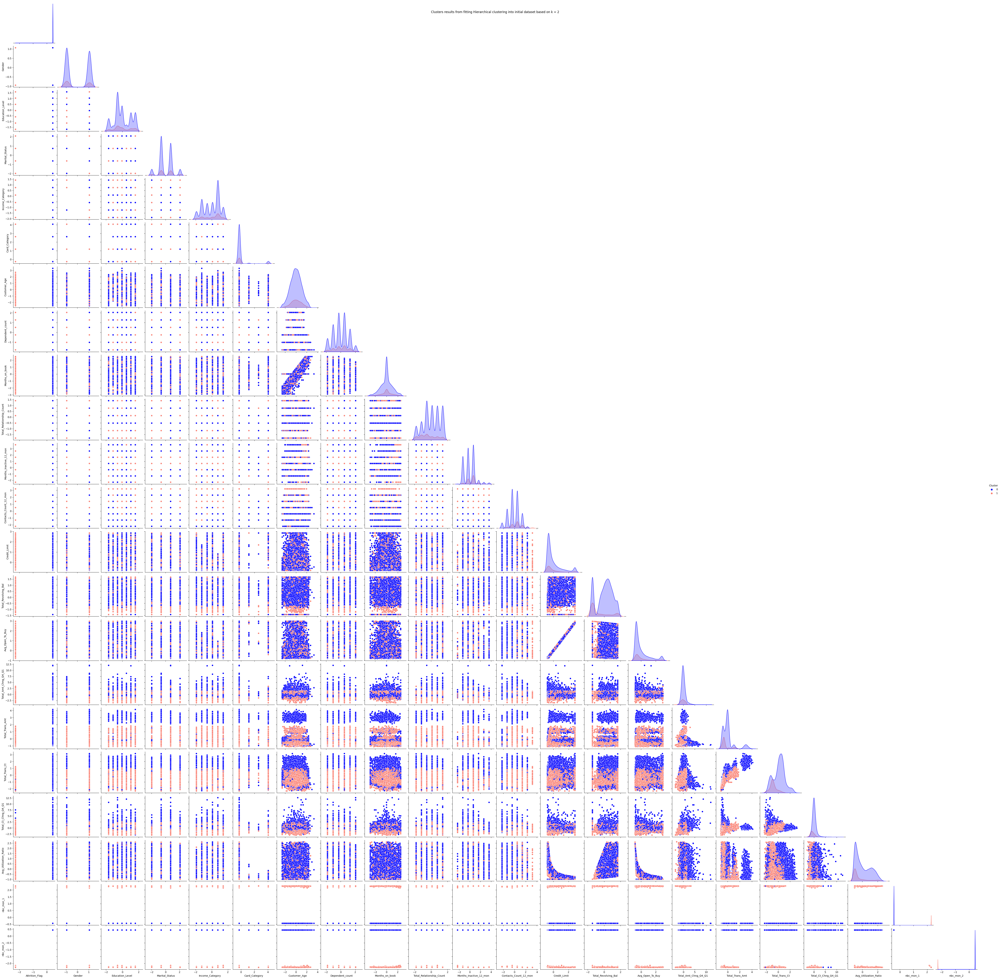

In [88]:
agg_cluster = AgglomerativeClustering(n_clusters = 2, affinity = 'euclidean', linkage = 'ward')
hiera_fit = agg_cluster.fit(scaled_numericalized_df)

labels_hie = hiera_fit.labels_

# Assuming your scaled data is a numpy array, convert it to a dataframe
df_scaled_num = pd.DataFrame(scaled_numericalized_df, columns=['Attrition_Flag', 'Gender', 'Education_Level', 'Marital_Status',
       'Income_Category', 'Card_Category', 'Customer_Age', 'Dependent_count',
       'Months_on_book', 'Total_Relationship_Count', 'Months_Inactive_12_mon',
       'Contacts_Count_12_mon', 'Credit_Limit', 'Total_Revolving_Bal',
       'Avg_Open_To_Buy', 'Total_Amt_Chng_Q4_Q1', 'Total_Trans_Amt',
       'Total_Trans_Ct', 'Total_Ct_Chng_Q4_Q1', 'Avg_Utilization_Ratio',
       'nbc_mon_1', 'nbc_mon_2'])
# Add the cluster labels to your dataframe
df_scaled_num['Cluster'] = labels_hie

# Now you can create the pairplot
sns.pairplot(df_scaled_num, hue='Cluster', corner=True, diag_kind="kde", palette=['blue', 'salmon'])
plt.suptitle("Clusters results from fitting Hierarchical clustering into initial dataset based on k = 2")
plt.show()

- Apply scaled_important_feature_data_2

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/cluster/_agglomerative.py:983: FutureWarning: Attribute `affinity` was deprecated in version 1.2 and will be removed in 1.4. Use `metric` instead
  warnings.warn(


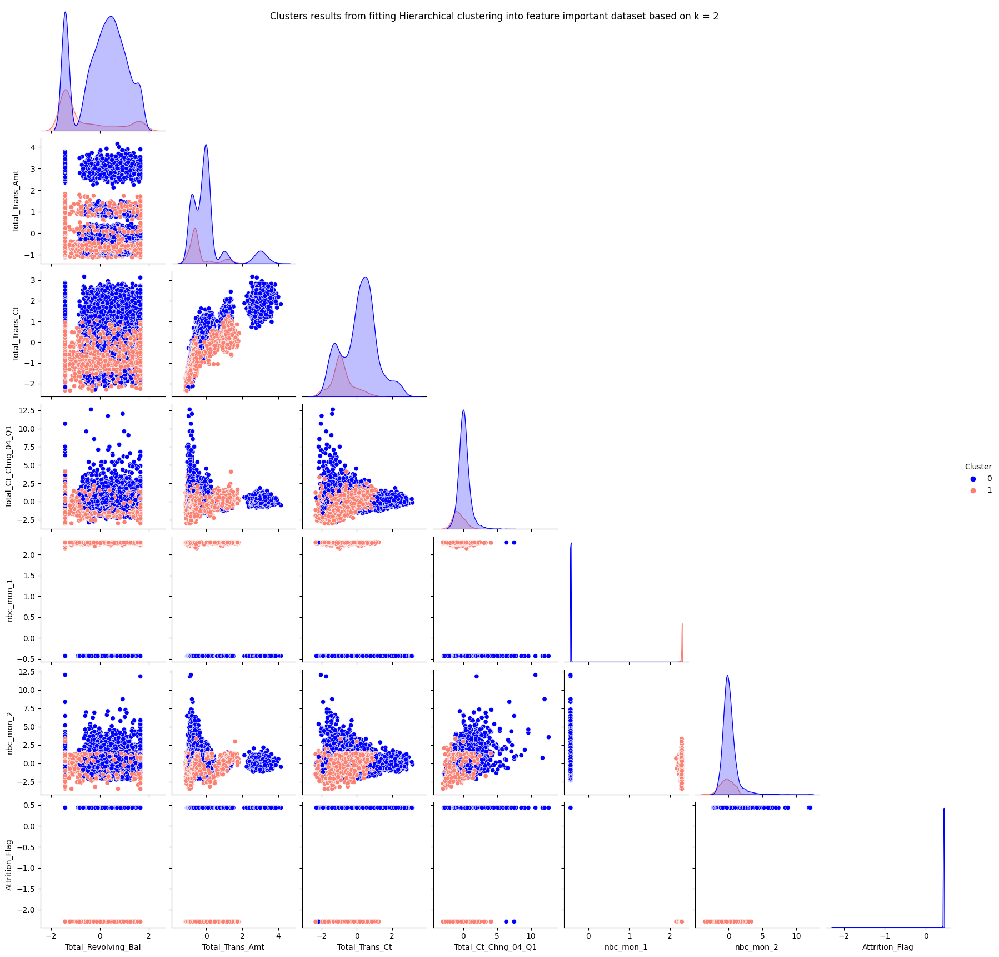

In [89]:
agg_cluster = AgglomerativeClustering(n_clusters = 2, affinity = 'euclidean', linkage = 'ward')
hiera_fit = agg_cluster.fit(scaled_important_feature_data_2)

labels_hie = hiera_fit.labels_

# Assuming your scaled data is a numpy array, convert it to a dataframe
df_scaled_imp = pd.DataFrame(scaled_important_feature_data_2, columns=['Total_Revolving_Bal','Total_Trans_Amt','Total_Trans_Ct','Total_Ct_Chng_04_Q1','nbc_mon_1','Total_Amt_Chng_Q4_Q1','Attrition_Flag'])

# Add the cluster labels to your dataframe
df_scaled_imp['Cluster'] = labels_hie

# Now you can create the pairplot
sns.pairplot(df_scaled_imp, hue='Cluster', corner=True, diag_kind="kde", palette=['blue', 'salmon'])
plt.suptitle("Clusters results from fitting Hierarchical clustering into feature important dataset based on k = 2")
plt.show()

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/cluster/_agglomerative.py:983: FutureWarning: Attribute `affinity` was deprecated in version 1.2 and will be removed in 1.4. Use `metric` instead
  warnings.warn(


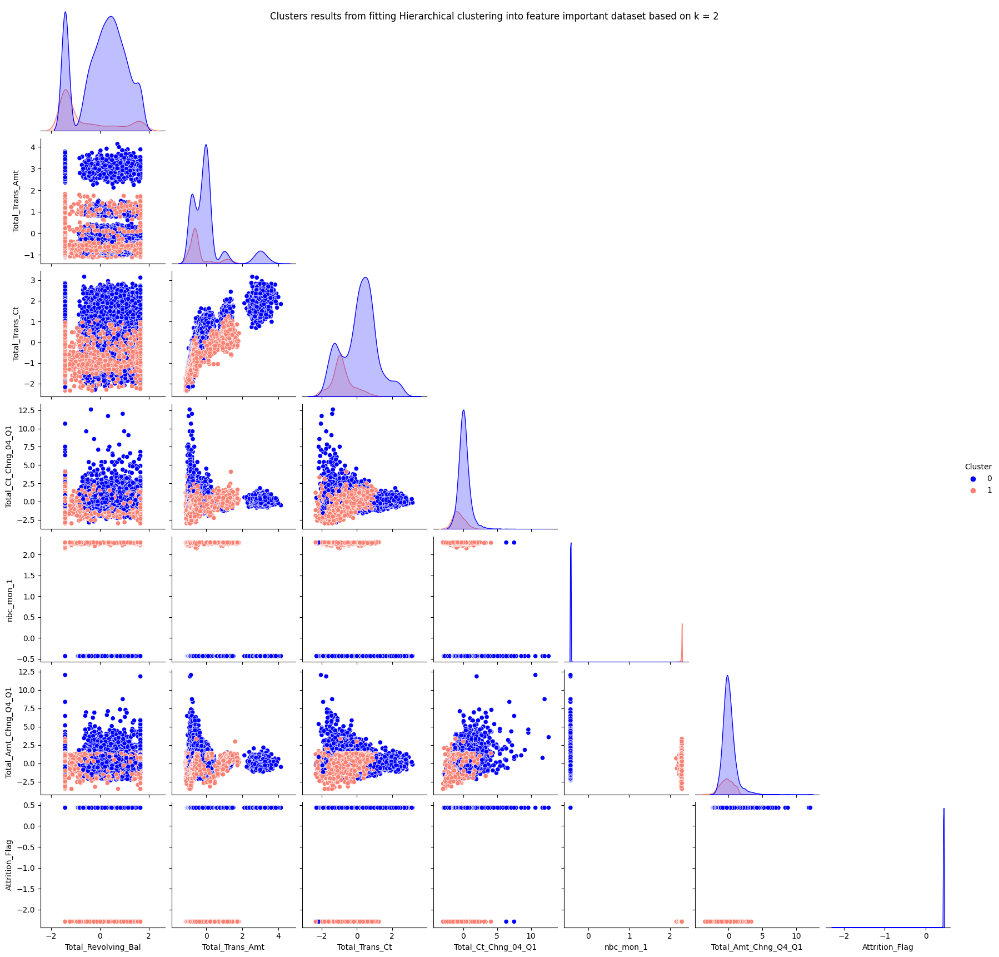

In [22]:
agg_cluster = AgglomerativeClustering(n_clusters = 2, affinity = 'euclidean', linkage = 'ward')
hiera_fit = agg_cluster.fit(scaled_important_feature_data_2)

labels_hie = hiera_fit.labels_

# Assuming your scaled data is a numpy array, convert it to a dataframe
df_scaled_imp = pd.DataFrame(scaled_important_feature_data_2, columns=['Total_Revolving_Bal','Total_Trans_Amt','Total_Trans_Ct','Total_Ct_Chng_04_Q1','nbc_mon_1','Total_Amt_Chng_Q4_Q1','Attrition_Flag'])

# Add the cluster labels to your dataframe
df_scaled_imp['Cluster'] = labels_hie

# Now you can create the pairplot
sns.pairplot(df_scaled_imp, hue='Cluster', corner=True, diag_kind="kde", palette=['blue', 'salmon'])
plt.suptitle("Clusters results from fitting Hierarchical clustering into feature important dataset based on k = 2")
plt.show()

- Apply opt_pca_data

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/cluster/_agglomerative.py:983: FutureWarning: Attribute `affinity` was deprecated in version 1.2 and will be removed in 1.4. Use `metric` instead
  warnings.warn(


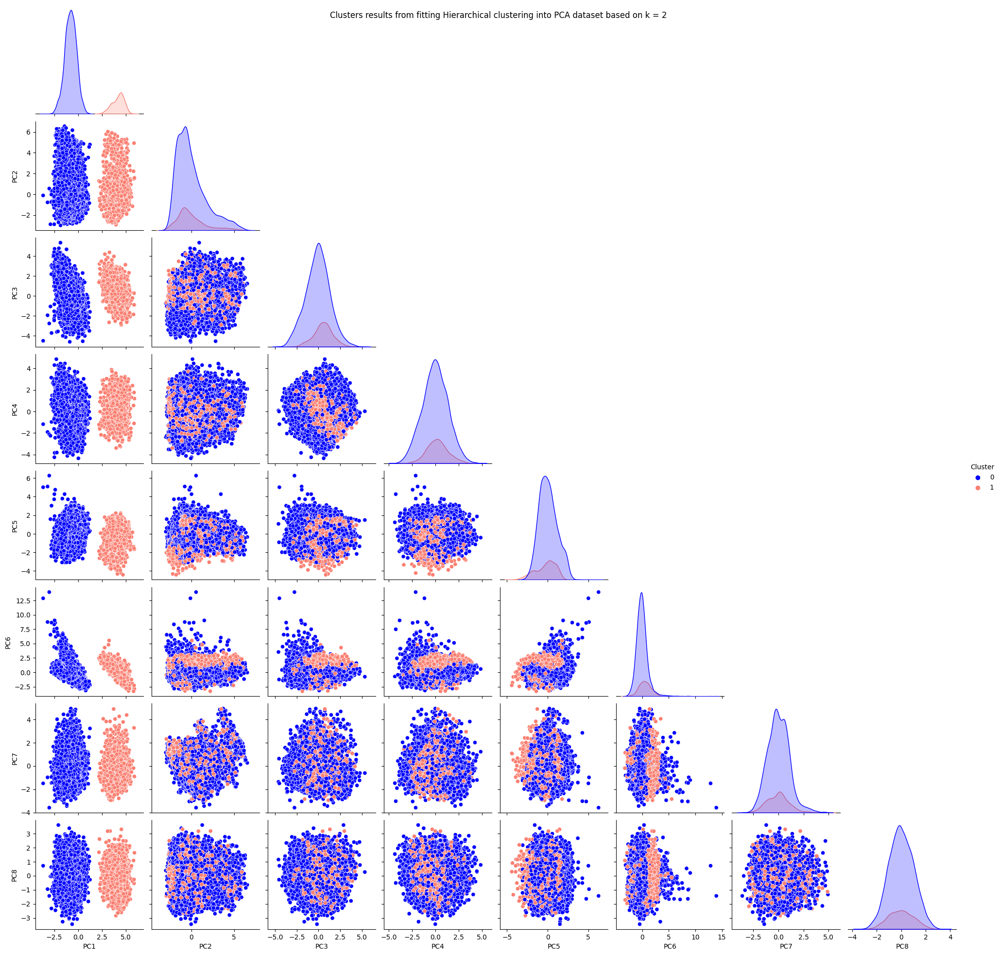

In [90]:
agg_cluster = AgglomerativeClustering(n_clusters = 2, affinity = 'euclidean', linkage = 'ward')
hiera_fit = agg_cluster.fit(opt_pca_data)

labels_hie = hiera_fit.labels_

# Assuming your scaled data is a numpy array, convert it to a dataframe
df_scaled_imp = pd.DataFrame(opt_pca_data, columns=['PC1','PC2','PC3','PC4','PC5','PC6','PC7','PC8'])
# Add the cluster labels to your dataframe
df_scaled_imp['Cluster'] = labels_hie

# Now you can create the pairplot
sns.pairplot(df_scaled_imp, hue='Cluster', corner=True, diag_kind="kde", palette=['blue', 'salmon'])
plt.suptitle("Clusters results from fitting Hierarchical clustering into PCA dataset based on k = 2")
plt.show()

#### 7.3 DBSCAN Clustering Algorithm

1. Determine epsilon (eps) by calculating the distances between each point of 3 datasets and min_samples

- Apply scaled_numericalized_df

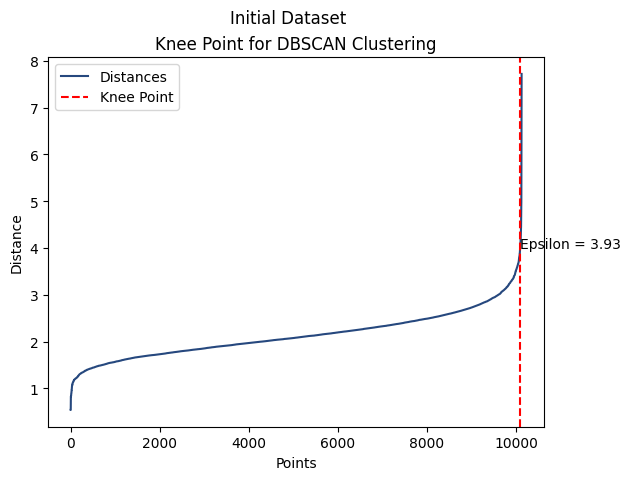

Elapsed time: 0.19 seconds


In [72]:
from sklearn.neighbors import NearestNeighbors
from kneed import KneeLocator

start_time = time.time()

neighbors = NearestNeighbors(n_neighbors=6)
neighbors_fit = neighbors.fit(scaled_numericalized_df)
distances, indices = neighbors_fit.kneighbors(scaled_numericalized_df)

distances = np.sort(distances, axis=0)
distances = distances[:, 1]

# Find the knee point
knee = KneeLocator(range(len(distances)), distances, curve='convex', direction='increasing')
knee_point_index = knee.knee

# Plot the distances and knee point
plt.plot(distances, label='Distances')
plt.axvline(x=knee_point_index, color='red', linestyle='--', label='Knee Point')

epsilon_value = knee.knee_y  # Epsilon value at the knee point

# Add text annotation for epsilon value
plt.text(knee_point_index, epsilon_value, f'Epsilon = {epsilon_value:.2f}', ha='left', va='bottom')

plt.title("Knee Point for DBSCAN Clustering")
plt.suptitle("Initial Dataset")
plt.xlabel("Points")
plt.ylabel("Distance")

plt.legend()

plt.show()

elapsed_time = time.time() - start_time
print("Elapsed time: {:.2f} seconds".format(elapsed_time))

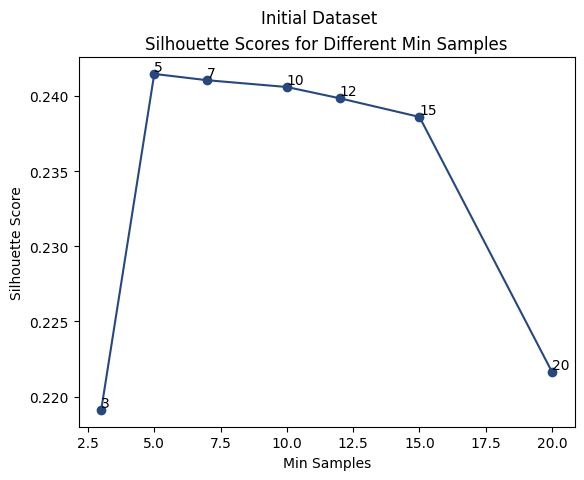

Elapsed time: 8.52 seconds


In [73]:
start_time = time.time()

min_samples_for_density = [3, 5, 7, 10, 12, 15, 20]
silhouettes = []
for samp in min_samples_for_density:    
    dbscan_model = DBSCAN(eps=3.93, min_samples=samp, n_jobs=-1)
    dbscan_model.fit(scaled_numericalized_df)
    pred = dbscan_model.fit_predict(scaled_numericalized_df)
    silhouettes.append(silhouette_score(scaled_numericalized_df, pred))

# Plot the silhouette scores
plt.plot(min_samples_for_density, silhouettes, marker='o')

# Add text annotation for min_samples values
for x, y, min_samples in zip(min_samples_for_density, silhouettes, min_samples_for_density):
    plt.text(x, y, f'{min_samples}', ha='left', va='bottom')

plt.title("Silhouette Scores for Different Min Samples")
plt.suptitle("Initial Dataset")
plt.xlabel("Min Samples")
plt.ylabel("Silhouette Score")

plt.show()

elapsed_time = time.time() - start_time
print("Elapsed time: {:.2f} seconds".format(elapsed_time))

- Apply scaled_important_feature_data_2

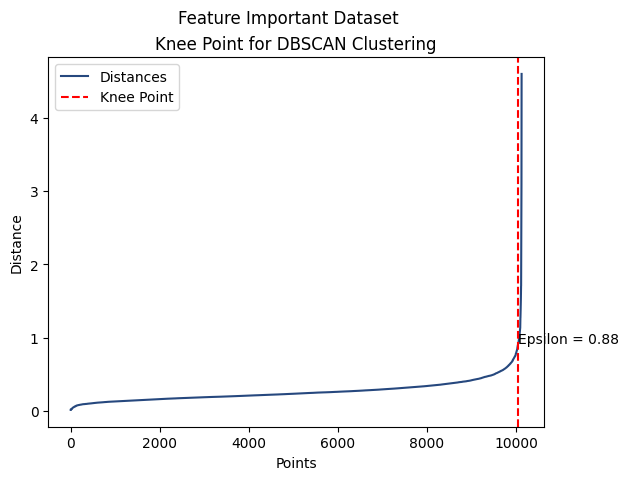

Elapsed time: 0.16 seconds


In [74]:
start_time = time.time()

neighbors = NearestNeighbors(n_neighbors=6)
neighbors_fit = neighbors.fit(scaled_important_feature_data_2)
distances, indices = neighbors_fit.kneighbors(scaled_important_feature_data_2)

distances = np.sort(distances, axis=0)
distances = distances[:, 1]

# Find the knee point
knee = KneeLocator(range(len(distances)), distances, curve='convex', direction='increasing')
knee_point_index = knee.knee

# Plot the distances and knee point
plt.plot(distances, label='Distances')
plt.axvline(x=knee_point_index, color='red', linestyle='--', label='Knee Point')

epsilon_value = knee.knee_y  # Epsilon value at the knee point

# Add text annotation for epsilon value
plt.text(knee_point_index, epsilon_value, f'Epsilon = {epsilon_value:.2f}', ha='left', va='bottom')

plt.title("Knee Point for DBSCAN Clustering")
plt.suptitle("Feature Important Dataset")
plt.xlabel("Points")
plt.ylabel("Distance")

plt.legend()

plt.show()

elapsed_time = time.time() - start_time
print("Elapsed time: {:.2f} seconds".format(elapsed_time))

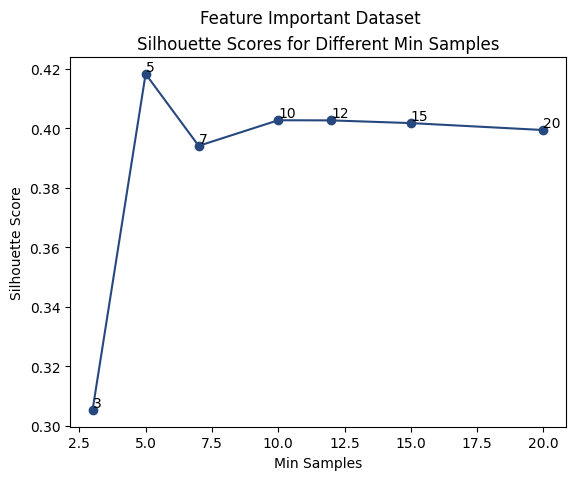

Elapsed time: 8.96 seconds


In [75]:
start_time = time.time()

min_samples_for_density = [3, 5, 7, 10, 12, 15, 20]
silhouettes = []
for samp in min_samples_for_density:    
    dbscan_model = DBSCAN(eps=0.88, min_samples=samp, n_jobs=-1)
    dbscan_model.fit(scaled_important_feature_data_2)
    pred = dbscan_model.fit_predict(scaled_important_feature_data_2)
    silhouettes.append(silhouette_score(scaled_important_feature_data_2, pred))

# Plot the silhouette scores
plt.plot(min_samples_for_density, silhouettes, marker='o')

# Add text annotation for min_samples values
for x, y, min_samples in zip(min_samples_for_density, silhouettes, min_samples_for_density):
    plt.text(x, y, f'{min_samples}', ha='left', va='bottom')

plt.title("Silhouette Scores for Different Min Samples")
plt.suptitle("Feature Important Dataset")
plt.xlabel("Min Samples")
plt.ylabel("Silhouette Score")

plt.show()

elapsed_time = time.time() - start_time
print("Elapsed time: {:.2f} seconds".format(elapsed_time))

- Apply opt_pca_data 

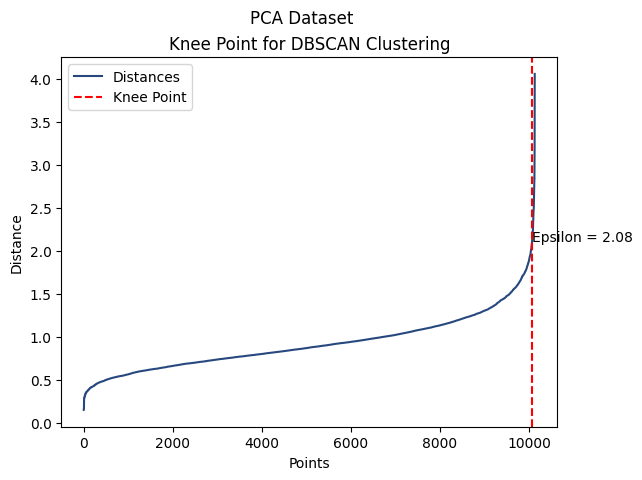

Elapsed time: 0.28 seconds


In [76]:
start_time = time.time()

neighbors = NearestNeighbors(n_neighbors=6)
neighbors_fit = neighbors.fit(opt_pca_data)
distances, indices = neighbors_fit.kneighbors(opt_pca_data)

distances = np.sort(distances, axis=0)
distances = distances[:, 1]

# Find the knee point
knee = KneeLocator(range(len(distances)), distances, curve='convex', direction='increasing')
knee_point_index = knee.knee

# Plot the distances and knee point
plt.plot(distances, label='Distances')
plt.axvline(x=knee_point_index, color='red', linestyle='--', label='Knee Point')

epsilon_value = knee.knee_y  # Epsilon value at the knee point

# Add text annotation for epsilon value
plt.text(knee_point_index, epsilon_value, f'Epsilon = {epsilon_value:.2f}', ha='left', va='bottom')

plt.title("Knee Point for DBSCAN Clustering")
plt.suptitle("PCA Dataset")
plt.xlabel("Points")
plt.ylabel("Distance")

plt.legend()

plt.show()

elapsed_time = time.time() - start_time
print("Elapsed time: {:.2f} seconds".format(elapsed_time))

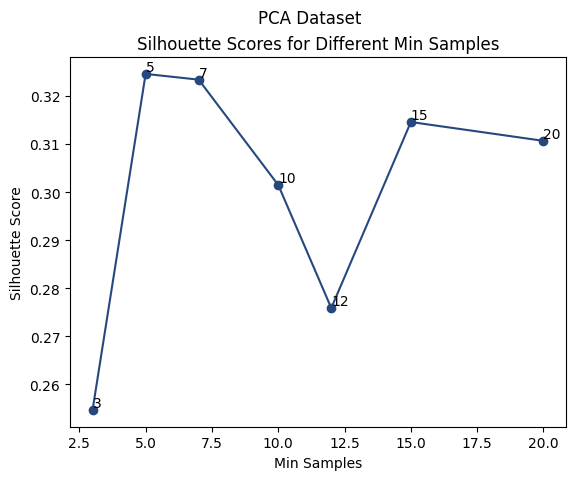

Elapsed time: 9.97 seconds


In [77]:
start_time = time.time()

min_samples_for_density = [3, 5, 7, 10, 12, 15, 20]
silhouettes = []
for samp in min_samples_for_density:    
    dbscan_model = DBSCAN(eps=2.08, min_samples=samp, n_jobs=-1)
    dbscan_model.fit(opt_pca_data)
    pred = dbscan_model.fit_predict(opt_pca_data)
    silhouettes.append(silhouette_score(opt_pca_data, pred))

# Plot the silhouette scores
plt.plot(min_samples_for_density, silhouettes, marker='o')

# Add text annotation for min_samples values
for x, y, min_samples in zip(min_samples_for_density, silhouettes, min_samples_for_density):
    plt.text(x, y, f'{min_samples}', ha='left', va='bottom')

plt.title("Silhouette Scores for Different Min Samples")
plt.suptitle("PCA Dataset")
plt.xlabel("Min Samples")
plt.ylabel("Silhouette Score")

plt.show()

elapsed_time = time.time() - start_time
print("Elapsed time: {:.2f} seconds".format(elapsed_time))

2. Fit the model and evaluate the performance

- Apply scaled_numericalized_df

In [78]:
start_time = time.time()

# Fit DBSCAN model
dbscan = DBSCAN(eps=3.93, min_samples=5)
labels_dbscan = dbscan.fit_predict(scaled_numericalized_df)

silhouette_dbscan = silhouette_score(scaled_numericalized_df, labels_dbscan)
davies_bouldin_dbscan = davies_bouldin_score(scaled_numericalized_df, labels_dbscan)
calinski_harabasz_dbscan = calinski_harabasz_score(scaled_numericalized_df, labels_dbscan)

print("Silhouette Score:", silhouette_dbscan)
print("Davies-Bouldin Score:", davies_bouldin_dbscan)
print("Calinski-Harabasz Score:", calinski_harabasz_dbscan)

elapsed_time = time.time() - start_time
print("Elapsed time: {:.2f} seconds".format(elapsed_time))

Silhouette Score: 0.2414724857915039
Davies-Bouldin Score: 2.0706434673886718
Calinski-Harabasz Score: 979.1952060586395
Elapsed time: 1.29 seconds


In [46]:
from scipy.spatial import distance
from sklearn.metrics import pairwise_distances

dbscan = DBSCAN(eps=3.93, min_samples=5)
labels_dbscan = dbscan.fit_predict(scaled_numericalized_df)

# Calculate pairwise distances
distances = pairwise_distances(scaled_numericalized_df)

# Find number of observations in each cluster
unique_labels, counts = np.unique(labels_dbscan, return_counts=True)
print(f'Number of observations in each cluster: {dict(zip(unique_labels, counts))}')

# For each cluster label
for label in unique_labels:
    # Ignore noise points
    if label == -1:
        continue

    # Indices of instances in the current cluster
    indices = np.where(labels_dbscan == label)[0]
    
    # Calculate max and average dissimilarity
    dissimilarities = distances[np.ix_(indices, indices)]
    max_dissimilarity = dissimilarities.max()
    avg_dissimilarity = dissimilarities.mean()

    print(f'Cluster {label}: Max dissimilarity = {max_dissimilarity}, Average dissimilarity = {avg_dissimilarity}')

# Calculate isolation for each cluster
cluster_distances = distances[np.ix_(labels_dbscan != -1, labels_dbscan != -1)]
min_distances = cluster_distances.min(axis=0)
max_distances = cluster_distances.max(axis=0)
isolation = max_distances - min_distances

for i, label in enumerate(unique_labels):
    # Ignore noise points
    if label == -1:
        continue
    print(f'Isolation for cluster {label}: {isolation[i]:.5f}')

Number of observations in each cluster: {-1: 60, 0: 8464, 1: 1603}
Cluster 0: Max dissimilarity = 14.114771897346502, Average dissimilarity = 5.910561487599197
Cluster 1: Max dissimilarity = 11.754835703600389, Average dissimilarity = 5.696376924059814
Isolation for cluster 0: 11.77191
Isolation for cluster 1: 13.20270


take 2 (18/6) for stat info

In [31]:
start_time = time.time()

# Fit DBSCAN model
dbscan = DBSCAN(eps=3.93, min_samples=5)
labels_dbscan = dbscan.fit_predict(scaled_numericalized_df)

silhouette_dbscan = silhouette_score(scaled_numericalized_df, labels_dbscan)
davies_bouldin_dbscan = davies_bouldin_score(scaled_numericalized_df, labels_dbscan)
calinski_harabasz_dbscan = calinski_harabasz_score(scaled_numericalized_df, labels_dbscan)

print("Silhouette Score:", silhouette_dbscan)
print("Davies-Bouldin Score:", davies_bouldin_dbscan)
print("Calinski-Harabasz Score:", calinski_harabasz_dbscan)

elapsed_time = time.time() - start_time
print("Elapsed time: {:.2f} seconds".format(elapsed_time))

Silhouette Score: 0.2414724857915039
Davies-Bouldin Score: 2.0706434673886718
Calinski-Harabasz Score: 979.1952060586395
Elapsed time: 1.43 seconds


In [32]:
# Calculate pairwise distances
distances = pairwise_distances(scaled_numericalized_df)

# Find number of observations in each cluster
unique_labels, counts = np.unique(labels_dbscan, return_counts=True)
print(f'Number of observations in each cluster: {dict(zip(unique_labels, counts))}')

# For each cluster label
for label in unique_labels:
    # Indices of instances in the current cluster
    indices = np.where(labels_dbscan == label)[0]
    
    # Calculate max and average dissimilarity
    dissimilarities = distances[np.ix_(indices, indices)]
    max_dissimilarity = dissimilarities.max()
    avg_dissimilarity = dissimilarities.mean()

    print(f'Cluster {label}: Max dissimilarity = {max_dissimilarity}, Average dissimilarity = {avg_dissimilarity}')

# Calculate isolation for each cluster
cluster_distances = distances[np.ix_(labels_dbscan == labels_dbscan, labels_dbscan == labels_dbscan)]
min_distances = cluster_distances.min(axis=0)
max_distances = cluster_distances.max(axis=0)
isolation = max_distances - min_distances

for i, label in enumerate(unique_labels):
    print(f'Isolation for cluster {label}: {isolation[i]:.5f}')

Number of observations in each cluster: {-1: 60, 0: 8464, 1: 1603}
Cluster -1: Max dissimilarity = 21.695371027328733, Average dissimilarity = 9.908164919566648
Cluster 0: Max dissimilarity = 14.114771897346502, Average dissimilarity = 5.910561487599197
Cluster 1: Max dissimilarity = 11.754835703600389, Average dissimilarity = 5.696376924059814
Isolation for cluster -1: 13.41781
Isolation for cluster 0: 19.38110
Isolation for cluster 1: 18.07655


- Apply scaled_important_feature_data_2

In [79]:
start_time = time.time()

# Fit DBSCAN model
dbscan = DBSCAN(eps=0.88, min_samples=5)
labels_dbscan_2 = dbscan.fit_predict(scaled_important_feature_data_2)

silhouette_dbscan = silhouette_score(scaled_important_feature_data_2, labels_dbscan_2)
davies_bouldin_dbscan = davies_bouldin_score(scaled_important_feature_data_2, labels_dbscan_2)
calinski_harabasz_dbscan = calinski_harabasz_score(scaled_important_feature_data_2, labels_dbscan_2)

print("Silhouette Score:", silhouette_dbscan)
print("Davies-Bouldin Score:", davies_bouldin_dbscan)
print("Calinski-Harabasz Score:", calinski_harabasz_dbscan)

elapsed_time = time.time() - start_time
print("Elapsed time: {:.2f} seconds".format(elapsed_time))

Silhouette Score: 0.41826846452763
Davies-Bouldin Score: 1.4982328452954725
Calinski-Harabasz Score: 2497.219365467201
Elapsed time: 1.56 seconds


In [47]:
dbscan = DBSCAN(eps=0.88, min_samples=5)
labels_dbscan_2 = dbscan.fit_predict(scaled_important_feature_data_2)

# Calculate pairwise distances
distances = pairwise_distances(scaled_important_feature_data_2)

# Find number of observations in each cluster
unique_labels, counts = np.unique(labels_dbscan_2, return_counts=True)
print(f'Number of observations in each cluster: {dict(zip(unique_labels, counts))}')

# For each cluster label
for label in unique_labels:
    # Ignore noise points
    if label == -1:
        continue

    # Indices of instances in the current cluster
    indices = np.where(labels_dbscan_2 == label)[0]
    
    # Calculate max and average dissimilarity
    dissimilarities = distances[np.ix_(indices, indices)]
    max_dissimilarity = dissimilarities.max()
    avg_dissimilarity = dissimilarities.mean()

    print(f'Cluster {label}: Max dissimilarity = {max_dissimilarity}, Average dissimilarity = {avg_dissimilarity}')

# Calculate isolation for each cluster
cluster_distances = distances[np.ix_(labels_dbscan_2 != -1, labels_dbscan_2 != -1)]
min_distances = cluster_distances.min(axis=0)
max_distances = cluster_distances.max(axis=0)
isolation = max_distances - min_distances

for i, label in enumerate(unique_labels):
    # Ignore noise points
    if label == -1:
        continue
    print(f'Isolation for cluster {label}: {isolation[i]:.5f}')

Number of observations in each cluster: {-1: 152, 0: 7644, 1: 12, 2: 1575, 3: 744}
Cluster 0: Max dissimilarity = 8.563750598737219, Average dissimilarity = 2.374925404812742
Cluster 1: Max dissimilarity = 2.16000309980757, Average dissimilarity = 1.0295222434116047
Cluster 2: Max dissimilarity = 7.7744141452979765, Average dissimilarity = 2.5021665561637474
Cluster 3: Max dissimilarity = 3.9889346749710533, Average dissimilarity = 1.6114595347217864
Isolation for cluster 0: 8.32325
Isolation for cluster 1: 9.01258
Isolation for cluster 2: 6.72157
Isolation for cluster 3: 9.70767


take 2 (18/6 for stat info)

In [33]:
start_time = time.time()

# Fit DBSCAN model
dbscan = DBSCAN(eps=0.88, min_samples=5)
labels_dbscan_2 = dbscan.fit_predict(scaled_important_feature_data_2)

silhouette_dbscan = silhouette_score(scaled_important_feature_data_2, labels_dbscan_2)
davies_bouldin_dbscan = davies_bouldin_score(scaled_important_feature_data_2, labels_dbscan_2)
calinski_harabasz_dbscan = calinski_harabasz_score(scaled_important_feature_data_2, labels_dbscan_2)

print("Silhouette Score:", silhouette_dbscan)
print("Davies-Bouldin Score:", davies_bouldin_dbscan)
print("Calinski-Harabasz Score:", calinski_harabasz_dbscan)

elapsed_time = time.time() - start_time
print("Elapsed time: {:.2f} seconds".format(elapsed_time))

Silhouette Score: 0.41826846452763
Davies-Bouldin Score: 1.4982328452954725
Calinski-Harabasz Score: 2497.219365467201
Elapsed time: 1.93 seconds


In [34]:
# Calculate pairwise distances
distances = pairwise_distances(scaled_important_feature_data_2)

# Find number of observations in each cluster
unique_labels, counts = np.unique(labels_dbscan_2, return_counts=True)
print(f'Number of observations in each cluster: {dict(zip(unique_labels, counts))}')

# For each cluster label
for label in unique_labels:
    # Indices of instances in the current cluster
    indices = np.where(labels_dbscan_2 == label)[0]
    
    # Calculate max and average dissimilarity
    dissimilarities = distances[np.ix_(indices, indices)]
    max_dissimilarity = dissimilarities.max()
    avg_dissimilarity = dissimilarities.mean()

    print(f'Cluster {label}: Max dissimilarity = {max_dissimilarity}, Average dissimilarity = {avg_dissimilarity}')

# Calculate isolation for each cluster
cluster_distances = distances[np.ix_(labels_dbscan_2 == labels_dbscan_2, labels_dbscan_2 == labels_dbscan_2)]
min_distances = cluster_distances.min(axis=0)
max_distances = cluster_distances.max(axis=0)
isolation = max_distances - min_distances

for i, label in enumerate(unique_labels):
    print(f'Isolation for cluster {label}: {isolation[i]:.5f}')

Number of observations in each cluster: {-1: 152, 0: 7644, 1: 12, 2: 1575, 3: 744}
Cluster -1: Max dissimilarity = 21.245423846071294, Average dissimilarity = 6.355252808587433
Cluster 0: Max dissimilarity = 8.563750598737219, Average dissimilarity = 2.374925404812742
Cluster 1: Max dissimilarity = 2.16000309980757, Average dissimilarity = 1.0295222434116047
Cluster 2: Max dissimilarity = 7.7744141452979765, Average dissimilarity = 2.5021665561637474
Cluster 3: Max dissimilarity = 3.9889346749710533, Average dissimilarity = 1.6114595347217864
Isolation for cluster -1: 11.71066
Isolation for cluster 0: 17.65767
Isolation for cluster 1: 16.14904
Isolation for cluster 2: 12.71316
Isolation for cluster 3: 15.27115


- Apply opt_pca_data

In [80]:
start_time = time.time()

# Fit DBSCAN model
dbscan = DBSCAN(eps=2.08, min_samples=5)
labels_dbscan_3 = dbscan.fit_predict(opt_pca_data)

silhouette_dbscan = silhouette_score(opt_pca_data, labels_dbscan_3)
davies_bouldin_dbscan = davies_bouldin_score(opt_pca_data, labels_dbscan_3)
calinski_harabasz_dbscan = calinski_harabasz_score(opt_pca_data, labels_dbscan_3)

print("Silhouette Score:", silhouette_dbscan)
print("Davies-Bouldin Score:", davies_bouldin_dbscan)
print("Calinski-Harabasz Score:", calinski_harabasz_dbscan)

elapsed_time = time.time() - start_time
print("Elapsed time: {:.2f} seconds".format(elapsed_time))

Silhouette Score: 0.32460762435803225
Davies-Bouldin Score: 2.185711219305027
Calinski-Harabasz Score: 1501.245054088508
Elapsed time: 1.94 seconds


In [48]:
dbscan = DBSCAN(eps=2.08, min_samples=5)
labels_dbscan_3 = dbscan.fit_predict(opt_pca_data)

# Calculate pairwise distances
distances = pairwise_distances(opt_pca_data)

# Find number of observations in each cluster
unique_labels, counts = np.unique(labels_dbscan_3, return_counts=True)
print(f'Number of observations in each cluster: {dict(zip(unique_labels, counts))}')

# For each cluster label
for label in unique_labels:
    # Ignore noise points
    if label == -1:
        continue

    # Indices of instances in the current cluster
    indices = np.where(labels_dbscan_3 == label)[0]
    
    # Calculate max and average dissimilarity
    dissimilarities = distances[np.ix_(indices, indices)]
    max_dissimilarity = dissimilarities.max()
    avg_dissimilarity = dissimilarities.mean()

    print(f'Cluster {label}: Max dissimilarity = {max_dissimilarity}, Average dissimilarity = {avg_dissimilarity}')

# Calculate isolation for each cluster
cluster_distances = distances[np.ix_(labels_dbscan_3 != -1, labels_dbscan_3 != -1)]
min_distances = cluster_distances.min(axis=0)
max_distances = cluster_distances.max(axis=0)
isolation = max_distances - min_distances

for i, label in enumerate(unique_labels):
    # Ignore noise points
    if label == -1:
        continue
    print(f'Isolation for cluster {label}: {isolation[i]:.5f}')

Number of observations in each cluster: {-1: 121, 0: 8442, 1: 1564}
Cluster 0: Max dissimilarity = 12.464145560536036, Average dissimilarity = 4.602984904806411
Cluster 1: Max dissimilarity = 10.616107962401102, Average dissimilarity = 4.313382963750651
Isolation for cluster 0: 9.82576
Isolation for cluster 1: 12.08288


take 2 (18/6 for stat info)

In [87]:
start_time = time.time()

# Fit DBSCAN model
dbscan = DBSCAN(eps=2.08, min_samples=5)
labels_dbscan_3 = dbscan.fit_predict(opt_pca_data)

silhouette_dbscan = silhouette_score(opt_pca_data, labels_dbscan_3)
davies_bouldin_dbscan = davies_bouldin_score(opt_pca_data, labels_dbscan_3)
calinski_harabasz_dbscan = calinski_harabasz_score(opt_pca_data, labels_dbscan_3)

print("Silhouette Score:", silhouette_dbscan)
print("Davies-Bouldin Score:", davies_bouldin_dbscan)
print("Calinski-Harabasz Score:", calinski_harabasz_dbscan)

elapsed_time = time.time() - start_time
print("Elapsed time: {:.2f} seconds".format(elapsed_time))

Silhouette Score: 0.3246075938929077
Davies-Bouldin Score: 2.1857127992541923
Calinski-Harabasz Score: 1501.2448180763697
Elapsed time: 1.99 seconds


In [88]:
# Calculate pairwise distances
distances = pairwise_distances(opt_pca_data)

# Find number of observations in each cluster
unique_labels, counts = np.unique(labels_dbscan_3, return_counts=True)
print(f'Number of observations in each cluster: {dict(zip(unique_labels, counts))}')

# For each cluster label
for label in unique_labels:
    # Indices of instances in the current cluster
    indices = np.where(labels_dbscan_3 == label)[0]
    
    # Calculate max and average dissimilarity
    dissimilarities = distances[np.ix_(indices, indices)]
    max_dissimilarity = dissimilarities.max()
    avg_dissimilarity = dissimilarities.mean()

    print(f'Cluster {label}: Max dissimilarity = {max_dissimilarity}, Average dissimilarity = {avg_dissimilarity}')

# Calculate isolation for each cluster
cluster_distances = distances[np.ix_(labels_dbscan_3 == labels_dbscan_3, labels_dbscan_3 == labels_dbscan_3)]
min_distances = cluster_distances.min(axis=0)
max_distances = cluster_distances.max(axis=0)
isolation = max_distances - min_distances

for i, label in enumerate(unique_labels):
    print(f'Isolation for cluster {label}: {isolation[i]:.5f}')

Number of observations in each cluster: {-1: 121, 0: 8442, 1: 1564}
Cluster -1: Max dissimilarity = 22.116435159759533, Average dissimilarity = 8.204130700737098
Cluster 0: Max dissimilarity = 12.464156579855256, Average dissimilarity = 4.602984497667598
Cluster 1: Max dissimilarity = 10.616018889806677, Average dissimilarity = 4.313385993823837
Isolation for cluster -1: 12.06212
Isolation for cluster 0: 17.69709
Isolation for cluster 1: 17.69678


3. Plot the cluster

- Apply to scaled_numericalized_df

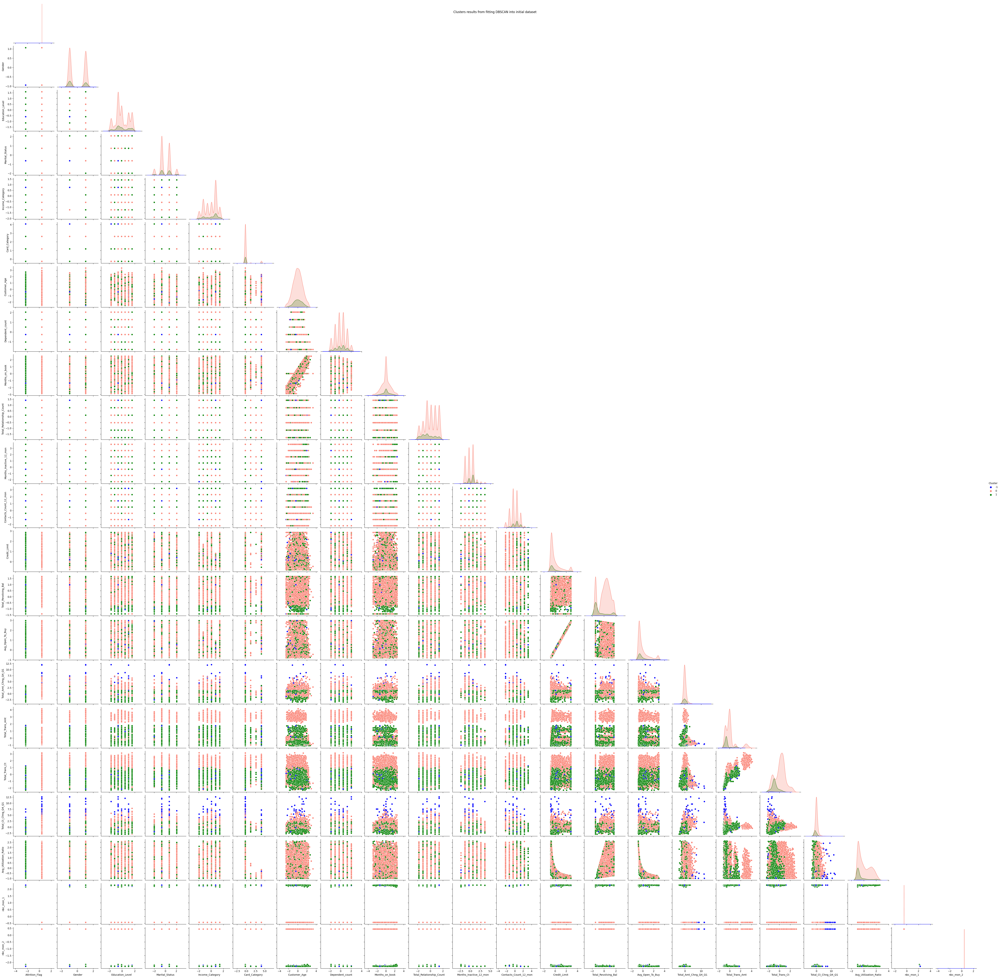

In [54]:
dbscan = DBSCAN(eps=3.93, min_samples=5)
labels_dbscan = dbscan.fit_predict(scaled_numericalized_df)

# Assuming your scaled data is a numpy array, convert it to a dataframe
df_scaled_num = pd.DataFrame(scaled_numericalized_df, columns=['Attrition_Flag', 'Gender', 'Education_Level', 'Marital_Status',
       'Income_Category', 'Card_Category', 'Customer_Age', 'Dependent_count',
       'Months_on_book', 'Total_Relationship_Count', 'Months_Inactive_12_mon',
       'Contacts_Count_12_mon', 'Credit_Limit', 'Total_Revolving_Bal',
       'Avg_Open_To_Buy', 'Total_Amt_Chng_Q4_Q1', 'Total_Trans_Amt',
       'Total_Trans_Ct', 'Total_Ct_Chng_Q4_Q1', 'Avg_Utilization_Ratio',
       'nbc_mon_1', 'nbc_mon_2'])
# Add the cluster labels to your dataframe
df_scaled_num['Cluster'] = labels_dbscan

# Now you can create the pairplot
sns.pairplot(df_scaled_num, hue='Cluster', corner=True, diag_kind="kde", palette=['blue', 'salmon', 'green'])
plt.suptitle("Clusters results from fitting DBSCAN into initial dataset")
plt.show()

- Apply to scaled_important_feature_data_2

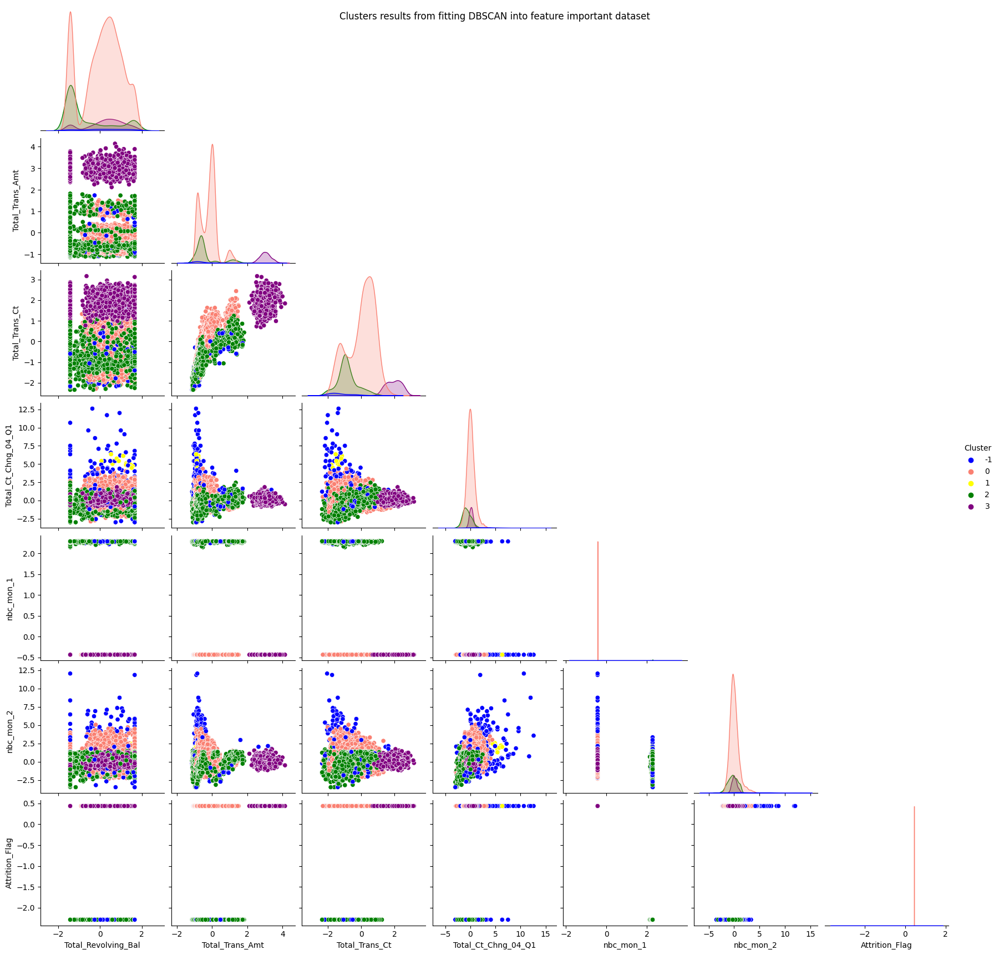

In [52]:
dbscan = DBSCAN(eps=0.88, min_samples=5)
labels_dbscan_2 = dbscan.fit_predict(scaled_important_feature_data_2)

# Assuming your scaled data is a numpy array, convert it to a dataframe
df_scaled_imp = pd.DataFrame(scaled_important_feature_data_2, columns=['Total_Revolving_Bal','Total_Trans_Amt','Total_Trans_Ct','Total_Ct_Chng_04_Q1','nbc_mon_1','Total_Amt_Chng_Q4_Q1','Attrition_Flag'])

# Add the cluster labels to your dataframe
df_scaled_imp['Cluster'] = labels_dbscan_2

# Now you can create the pairplot
sns.pairplot(df_scaled_imp, hue='Cluster', corner=True, diag_kind="kde", palette=['blue', 'salmon', 'yellow', 'green', 'purple'])
plt.suptitle("Clusters results from fitting DBSCAN into feature important dataset")
plt.show()

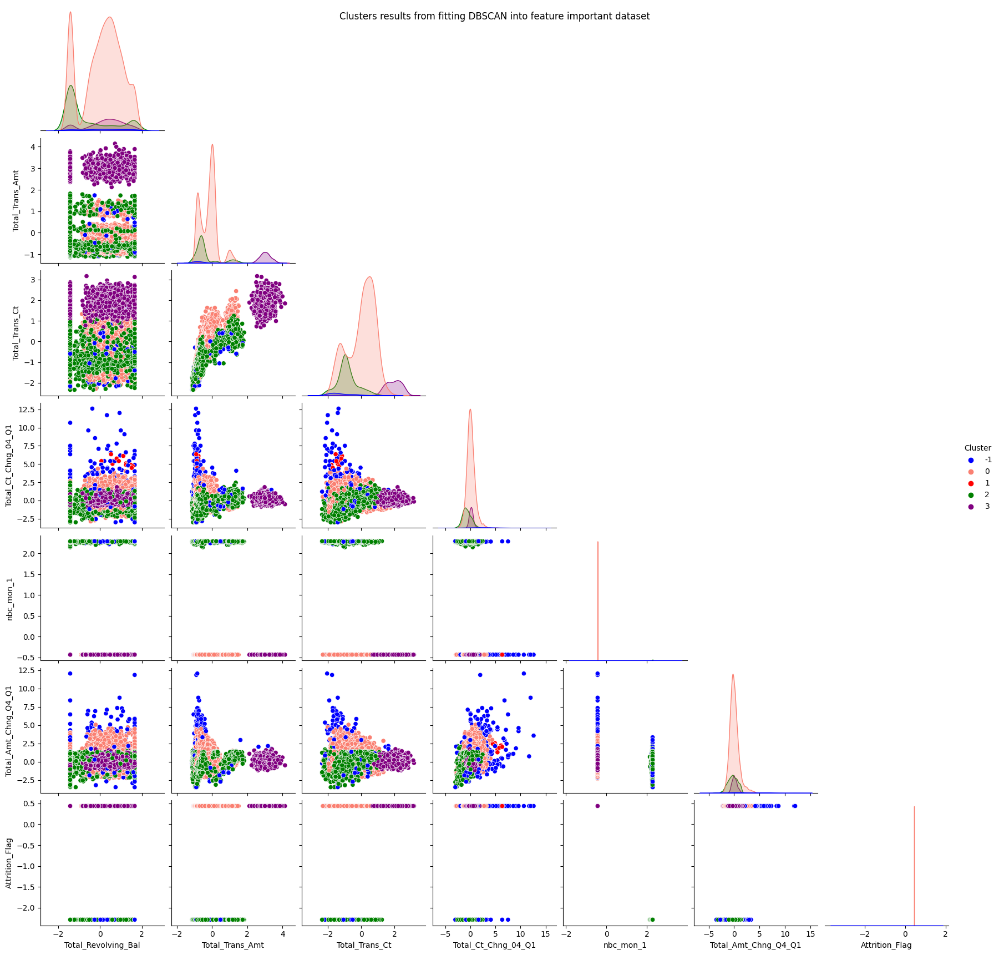

In [25]:
dbscan = DBSCAN(eps=0.88, min_samples=5)
labels_dbscan_2 = dbscan.fit_predict(scaled_important_feature_data_2)

# Assuming your scaled data is a numpy array, convert it to a dataframe
df_scaled_imp = pd.DataFrame(scaled_important_feature_data_2, columns=['Total_Revolving_Bal','Total_Trans_Amt','Total_Trans_Ct','Total_Ct_Chng_04_Q1','nbc_mon_1','Total_Amt_Chng_Q4_Q1','Attrition_Flag'])

# Add the cluster labels to your dataframe
df_scaled_imp['Cluster'] = labels_dbscan_2

# Now you can create the pairplot
sns.pairplot(df_scaled_imp, hue='Cluster', corner=True, diag_kind="kde", palette=['blue', 'salmon', 'red', 'green', 'purple'])
plt.suptitle("Clusters results from fitting DBSCAN into feature important dataset")
plt.show()

- Apply opt_pca_data

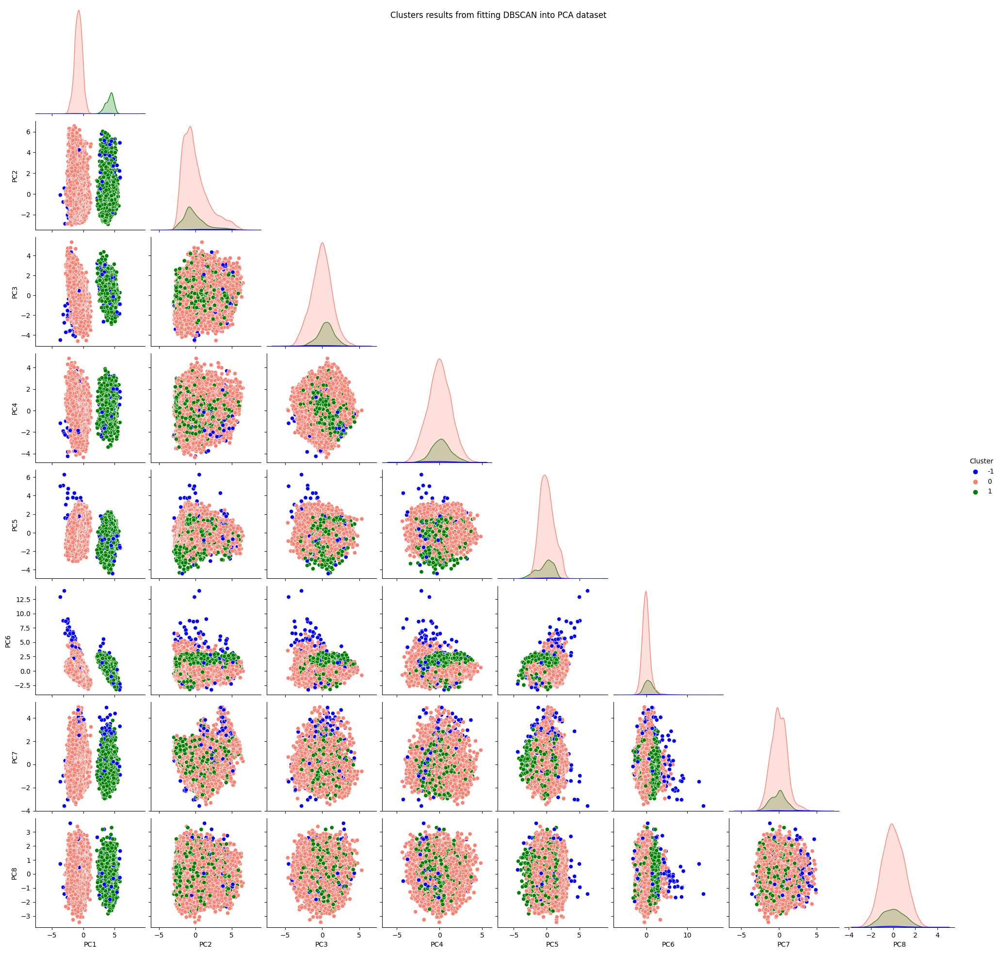

In [56]:
dbscan = DBSCAN(eps=2.08, min_samples=5)
labels_dbscan_3 = dbscan.fit_predict(opt_pca_data)

# Assuming your scaled data is a numpy array, convert it to a dataframe
df_scaled_imp = pd.DataFrame(opt_pca_data, columns=['PC1','PC2','PC3','PC4','PC5','PC6','PC7','PC8'])
# Add the cluster labels to your dataframe
df_scaled_imp['Cluster'] = labels_dbscan_3

# Now you can create the pairplot
sns.pairplot(df_scaled_imp, hue='Cluster', corner=True, diag_kind="kde", palette=['blue', 'salmon', 'green'])
plt.suptitle("Clusters results from fitting DBSCAN into PCA dataset")
plt.show()

#### 7.4 Hybrid DBSCAN K-Means Algorithm

scaled_numericalized_df

In [25]:
from sklearn.cluster import DBSCAN, KMeans

start_time = time.time()

def hybrid_clustering(data, eps, min_samples, n_clusters):
    # Step 1: Apply DBSCAN to identify dense regions and outliers
    dbscan = DBSCAN(eps=eps, min_samples=min_samples)
    dbscan_labels = dbscan.fit_predict(data)

    # Step 2: Filter out the outliers identified by DBSCAN
    filtered_data = data[dbscan_labels != -1]

    # Step 3: Apply k-means on the filtered data
    kmeans = KMeans(n_clusters=n_clusters)
    kmeans_labels = kmeans.fit_predict(filtered_data)

    # Step 4: Combine the labels from DBSCAN and k-means
    hybrid_labels = dbscan_labels.copy()
    hybrid_labels[dbscan_labels != -1] = kmeans_labels

    return hybrid_labels

# Example usage
# Assuming you have your data stored in a variable called 'data'
data = scaled_numericalized_df
eps = 3.93  # DBSCAN epsilon parameter
min_samples = 5  # DBSCAN minimum number of samples parameter
n_clusters = 2  # Number of clusters for k-means

# Apply the hybrid clustering algorithm
labels_dbk_h1 = hybrid_clustering(data, eps, min_samples, n_clusters)

# Evaluate the performance using Silhouette score
silhouette = silhouette_score(data, labels_dbk_h1)
davies_bouldin = davies_bouldin_score(data, labels_dbk_h1)
calinski_harabasz = calinski_harabasz_score(data, labels_dbk_h1)
print("Silhouette score:", silhouette)
print("Davies-Bouldin Score:", davies_bouldin)
print("Calinski-Harabasz Score:", calinski_harabasz)

elapsed_time = time.time() - start_time
print("Elapsed time: {:.2f} seconds".format(elapsed_time))

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Silhouette score: 0.2414724857915039
Davies-Bouldin Score: 2.0706434673886718
Calinski-Harabasz Score: 979.1952060586395
Elapsed time: 1.73 seconds


In [28]:
from sklearn.metrics import pairwise_distances

# Calculate pairwise distances
distances = pairwise_distances(scaled_numericalized_df)

# Find number of observations in each cluster
unique_labels, counts = np.unique(labels_dbk_h1, return_counts=True)
print(f'Number of observations in each cluster: {dict(zip(unique_labels, counts))}')

# For each cluster label
for label in unique_labels:
    # Indices of instances in the current cluster
    indices = np.where(labels_dbk_h1 == label)[0]
    
    # Calculate max and average dissimilarity
    dissimilarities = distances[np.ix_(indices, indices)]
    max_dissimilarity = dissimilarities.max()
    avg_dissimilarity = dissimilarities.mean()

    print(f'Cluster {label}: Max dissimilarity = {max_dissimilarity}, Average dissimilarity = {avg_dissimilarity}')

# Calculate isolation for each cluster
cluster_distances = distances[np.ix_(labels_dbk_h1 == labels_dbk_h1, labels_dbk_h1 == labels_dbk_h1)]
min_distances = cluster_distances.min(axis=0)
max_distances = cluster_distances.max(axis=0)
isolation = max_distances - min_distances

for i, label in enumerate(unique_labels):
    print(f'Isolation for cluster {label}: {isolation[i]:.5f}')

Number of observations in each cluster: {-1: 60, 0: 1603, 1: 8464}
Cluster -1: Max dissimilarity = 21.695371027328733, Average dissimilarity = 9.908164919566648
Cluster 0: Max dissimilarity = 11.754835703600389, Average dissimilarity = 5.696376924059814
Cluster 1: Max dissimilarity = 14.114771897346502, Average dissimilarity = 5.910561487599197
Isolation for cluster -1: 13.41781
Isolation for cluster 0: 19.38110
Isolation for cluster 1: 18.07655


scaled_important_feature_data_2

when k = 2

In [29]:
from sklearn.cluster import DBSCAN, KMeans

start_time = time.time()

def hybrid_clustering(data, eps, min_samples, n_clusters):
    # Step 1: Apply DBSCAN to identify dense regions and outliers
    dbscan = DBSCAN(eps=eps, min_samples=min_samples)
    dbscan_labels = dbscan.fit_predict(data)

    # Step 2: Filter out the outliers identified by DBSCAN
    filtered_data = data[dbscan_labels != -1]

    # Step 3: Apply k-means on the filtered data
    kmeans = KMeans(n_clusters=n_clusters)
    kmeans_labels = kmeans.fit_predict(filtered_data)

    # Step 4: Combine the labels from DBSCAN and k-means
    hybrid_labels = dbscan_labels.copy()
    hybrid_labels[dbscan_labels != -1] = kmeans_labels

    return hybrid_labels

# Example usage
# Assuming you have your data stored in a variable called 'data'
data = scaled_important_feature_data_2
eps = 0.88  # DBSCAN epsilon parameter
min_samples = 5  # DBSCAN minimum number of samples parameter
n_clusters = 2  # Number of clusters for k-means

# Apply the hybrid clustering algorithm
labels_dbk_h2 = hybrid_clustering(data, eps, min_samples, n_clusters)

# Evaluate the performance using Silhouette score
silhouette = silhouette_score(data, labels_dbk_h2)
davies_bouldin = davies_bouldin_score(data, labels_dbk_h2)
calinski_harabasz = calinski_harabasz_score(data, labels_dbk_h2)
print("Silhouette score:", silhouette)
print("Davies-Bouldin Score:", davies_bouldin)
print("Calinski-Harabasz Score:", calinski_harabasz)

elapsed_time = time.time() - start_time
print("Elapsed time: {:.2f} seconds".format(elapsed_time))

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Silhouette score: 0.4585893077797097
Davies-Bouldin Score: 1.5420064696425537
Calinski-Harabasz Score: 2783.0744003509244
Elapsed time: 1.68 seconds


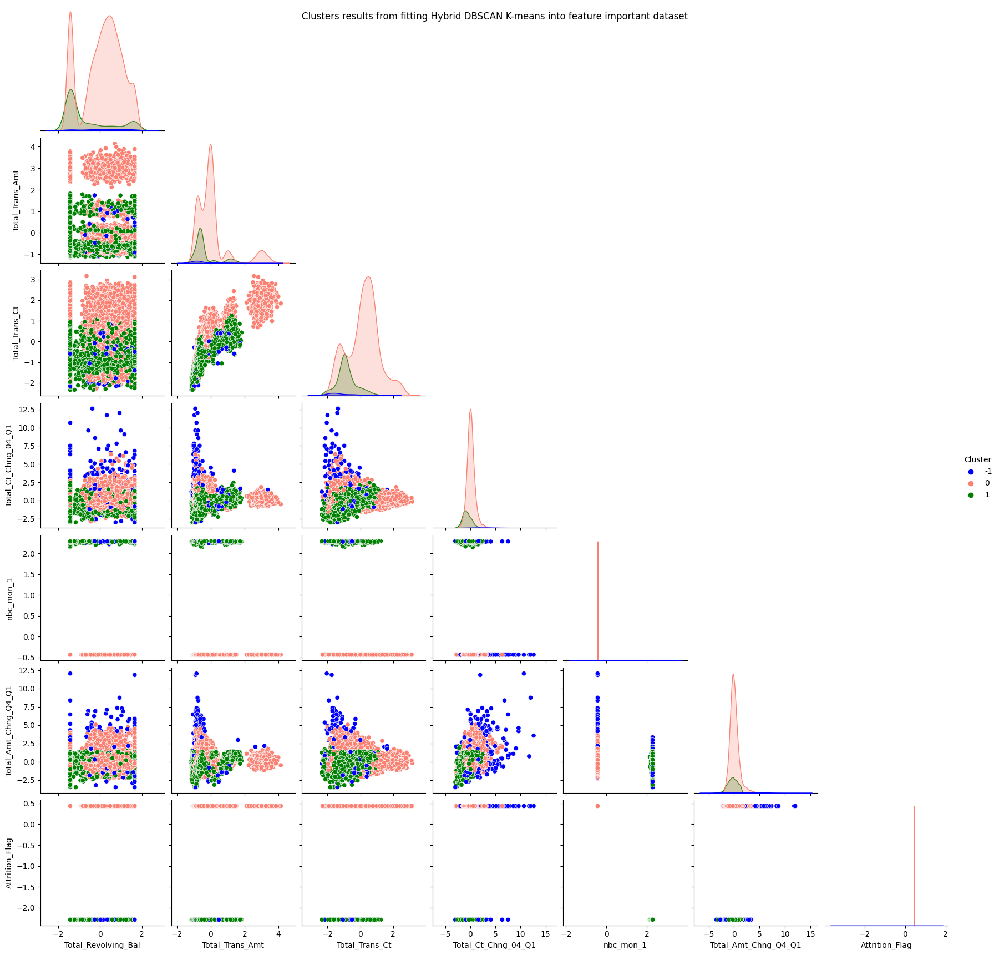

In [68]:
# Assuming your scaled data is a numpy array, convert it to a dataframe
df_scaled_imp = pd.DataFrame(scaled_important_feature_data_2, columns=['Total_Revolving_Bal','Total_Trans_Amt','Total_Trans_Ct','Total_Ct_Chng_04_Q1','nbc_mon_1','Total_Amt_Chng_Q4_Q1','Attrition_Flag'])

# Add the cluster labels to your dataframe
df_scaled_imp['Cluster'] = labels_dbk_h2

# Now you can create the pairplot
sns.pairplot(df_scaled_imp, hue='Cluster', corner=True, diag_kind="kde", palette=['blue', 'salmon', 'green'])
plt.suptitle("Clusters results from fitting Hybrid DBSCAN K-means into feature important dataset")
plt.show()

In [62]:
from sklearn.cluster import DBSCAN, KMeans
from sklearn.metrics import pairwise_distances
import numpy as np

def hybrid_clustering(data, eps, min_samples, n_clusters):
    # Step 1: Apply DBSCAN to identify dense regions and outliers
    dbscan = DBSCAN(eps=eps, min_samples=min_samples)
    dbscan_labels = dbscan.fit_predict(data)

    # Step 2: Filter out the outliers identified by DBSCAN
    filtered_data = data[dbscan_labels != -1]

    # Step 3: Apply k-means on the filtered data
    kmeans = KMeans(n_clusters=n_clusters)
    kmeans_labels = kmeans.fit_predict(filtered_data)

    # Step 4: Combine the labels from DBSCAN and k-means
    hybrid_labels = dbscan_labels.copy()
    hybrid_labels[dbscan_labels != -1] = kmeans_labels

    return hybrid_labels

def calculate_cluster_statistics(data, labels):
    n_clusters = len(np.unique(labels))
    cluster_statistics = []

    for cluster_id in range(n_clusters):
        cluster_data = data[labels == cluster_id]
        n_samples = len(cluster_data)

        if n_samples > 1:
            dissimilarity_matrix = pairwise_distances(cluster_data)
            dissimilarity_sum = np.sum(dissimilarity_matrix)
            max_dissimilarity = np.max(dissimilarity_matrix)
            avg_dissimilarity = dissimilarity_sum / (n_samples * (n_samples - 1))
        else:
            max_dissimilarity = 0
            avg_dissimilarity = 0

        isolation = n_samples / len(data)

        cluster_statistics.append({
            'cluster_id': cluster_id,
            'n_samples': n_samples,
            'max_dissimilarity': max_dissimilarity,
            'avg_dissimilarity': avg_dissimilarity,
            'isolation': isolation
        })

    return cluster_statistics

# Example usage
# Assuming you have your data stored in a variable called 'data'
data = scaled_important_feature_data_2
eps = 3.93  # DBSCAN epsilon parameter
min_samples = 5  # DBSCAN minimum number of samples parameter
n_clusters = 2  # Number of clusters for k-means

# Apply the hybrid clustering algorithm
labels = hybrid_clustering(data, eps, min_samples, n_clusters)

# Calculate cluster statistics
cluster_stats = calculate_cluster_statistics(data, labels)

# Print the cluster statistics
for cluster in cluster_stats:
    print("Cluster ID:", cluster['cluster_id'])
    print("Number of samples:", cluster['n_samples'])
    print("Max dissimilarity:", cluster['max_dissimilarity'])
    print("Avg dissimilarity:", cluster['avg_dissimilarity'])
    print("Isolation:", cluster['isolation'])
    print()

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Cluster ID: 0
Number of samples: 8497
Max dissimilarity: 16.251549823206357
Avg dissimilarity: 2.76622463384721
Isolation: 0.8390441394292485

Cluster ID: 1
Number of samples: 1626
Max dissimilarity: 10.579719798328782
Avg dissimilarity: 2.5762628048261114
Isolation: 0.16056087686382936

Cluster ID: 2
Number of samples: 0
Max dissimilarity: 0
Avg dissimilarity: 0
Isolation: 0.0



In [69]:
# Calculate pairwise distances
distances = pairwise_distances(scaled_important_feature_data_2)

# Find number of observations in each cluster
unique_labels, counts = np.unique(labels_dbk_h2, return_counts=True)
print(f'Number of observations in each cluster: {dict(zip(unique_labels, counts))}')

# For each cluster label
for label in unique_labels:
    # Ignore noise points
    if label == -1:
        continue

    # Indices of instances in the current cluster
    indices = np.where(labels_dbk_h2 == label)[0]
    
    # Calculate max and average dissimilarity
    dissimilarities = distances[np.ix_(indices, indices)]
    max_dissimilarity = dissimilarities.max()
    avg_dissimilarity = dissimilarities.mean()

    print(f'Cluster {label}: Max dissimilarity = {max_dissimilarity}, Average dissimilarity = {avg_dissimilarity}')

# Calculate isolation for each cluster
cluster_distances = distances[np.ix_(labels_dbk_h2 != -1, labels_dbk_h2 != -1)]
min_distances = cluster_distances.min(axis=0)
max_distances = cluster_distances.max(axis=0)
isolation = max_distances - min_distances

for i, label in enumerate(unique_labels):
    # Ignore noise points
    if label == -1:
        continue
    print(f'Isolation for cluster {label}: {isolation[i]:.5f}')

Number of observations in each cluster: {-1: 152, 0: 8400, 1: 1575}
Cluster 0: Max dissimilarity = 9.876621474535801, Average dissimilarity = 2.6824835734696117
Cluster 1: Max dissimilarity = 7.7744141452979765, Average dissimilarity = 2.5021665561637474
Isolation for cluster 0: 8.32325
Isolation for cluster 1: 9.01258


In [30]:
# Calculate pairwise distances
distances = pairwise_distances(scaled_important_feature_data_2)

# Find number of observations in each cluster
unique_labels, counts = np.unique(labels_dbk_h2, return_counts=True)
print(f'Number of observations in each cluster: {dict(zip(unique_labels, counts))}')

# For each cluster label
for label in unique_labels:
    # Indices of instances in the current cluster
    indices = np.where(labels_dbk_h2 == label)[0]
    
    # Calculate max and average dissimilarity
    dissimilarities = distances[np.ix_(indices, indices)]
    max_dissimilarity = dissimilarities.max()
    avg_dissimilarity = dissimilarities.mean()

    print(f'Cluster {label}: Max dissimilarity = {max_dissimilarity}, Average dissimilarity = {avg_dissimilarity}')

# Calculate isolation for each cluster
cluster_distances = distances[np.ix_(labels_dbk_h2 == labels_dbk_h2, labels_dbk_h2 == labels_dbk_h2)]
min_distances = cluster_distances.min(axis=0)
max_distances = cluster_distances.max(axis=0)
isolation = max_distances - min_distances

for i, label in enumerate(unique_labels):
    print(f'Isolation for cluster {label}: {isolation[i]:.5f}')

Number of observations in each cluster: {-1: 152, 0: 8400, 1: 1575}
Cluster -1: Max dissimilarity = 21.245423846071294, Average dissimilarity = 6.355252808587433
Cluster 0: Max dissimilarity = 9.876621474535801, Average dissimilarity = 2.6824835734696117
Cluster 1: Max dissimilarity = 7.7744141452979765, Average dissimilarity = 2.5021665561637474
Isolation for cluster -1: 11.71066
Isolation for cluster 0: 17.65767
Isolation for cluster 1: 16.14904


when k = 3

In [22]:
from sklearn.cluster import DBSCAN, KMeans

start_time = time.time()

def hybrid_clustering(data, eps, min_samples, n_clusters):
    # Step 1: Apply DBSCAN to identify dense regions and outliers
    dbscan = DBSCAN(eps=eps, min_samples=min_samples)
    dbscan_labels = dbscan.fit_predict(data)

    # Step 2: Filter out the outliers identified by DBSCAN
    filtered_data = data[dbscan_labels != -1]

    # Step 3: Apply k-means on the filtered data
    kmeans = KMeans(n_clusters=n_clusters)
    kmeans_labels = kmeans.fit_predict(filtered_data)

    # Step 4: Combine the labels from DBSCAN and k-means
    hybrid_labels = dbscan_labels.copy()
    hybrid_labels[dbscan_labels != -1] = kmeans_labels

    return hybrid_labels

# Example usage
# Assuming you have your data stored in a variable called 'data'
data = scaled_important_feature_data_2
eps = 0.88  # DBSCAN epsilon parameter
min_samples = 5  # DBSCAN minimum number of samples parameter
n_clusters = 4  # Number of clusters for k-means

# Apply the hybrid clustering algorithm
labels_dbk_h21 = hybrid_clustering(data, eps, min_samples, n_clusters)

# Evaluate the performance using Silhouette score
silhouette = silhouette_score(data, labels_dbk_h21)
davies_bouldin = davies_bouldin_score(data, labels_dbk_h21)
calinski_harabasz = calinski_harabasz_score(data, labels_dbk_h21)
print("Silhouette score:", silhouette)
print("Davies-Bouldin Score:", davies_bouldin)
print("Calinski-Harabasz Score:", calinski_harabasz)

elapsed_time = time.time() - start_time
print("Elapsed time: {:.2f} seconds".format(elapsed_time))

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Silhouette score: 0.29820780865112717
Davies-Bouldin Score: 1.5490600948744817
Calinski-Harabasz Score: 3260.9519552227066
Elapsed time: 4.09 seconds


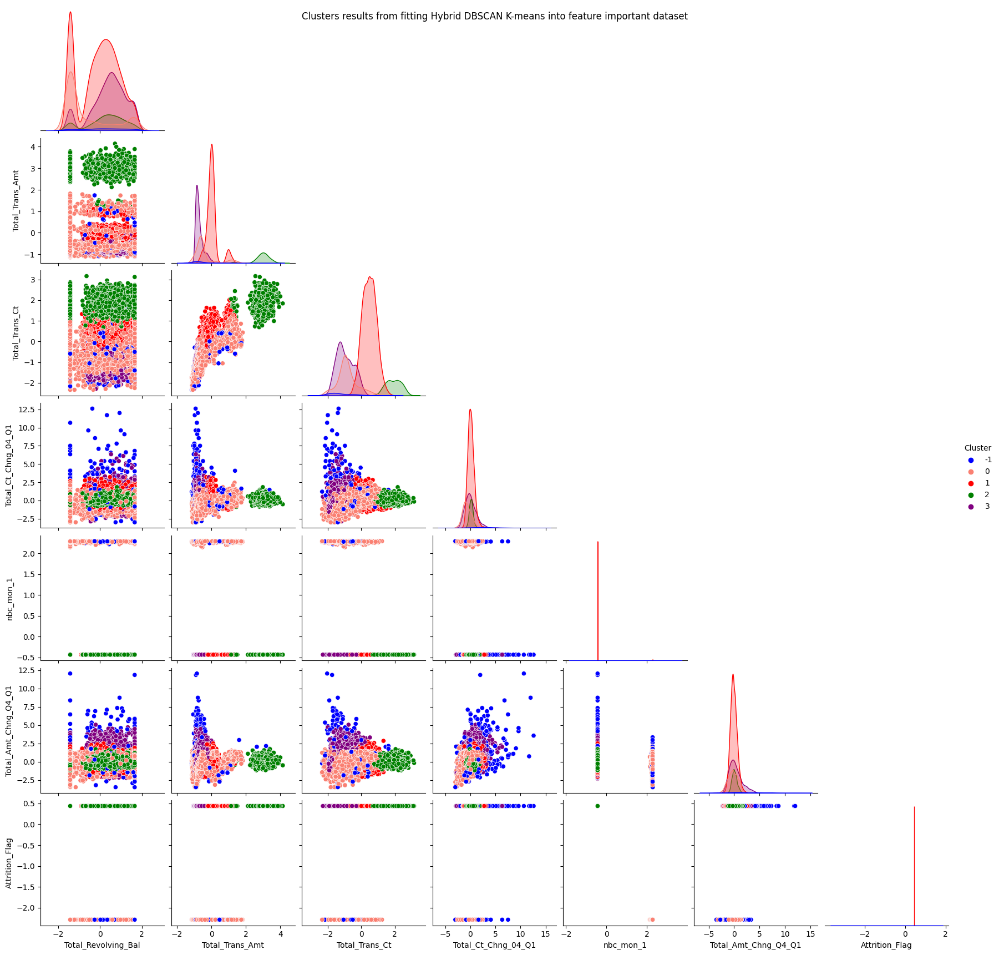

In [36]:
# Assuming your scaled data is a numpy array, convert it to a dataframe
df_scaled_imp = pd.DataFrame(scaled_important_feature_data_2, columns=['Total_Revolving_Bal','Total_Trans_Amt','Total_Trans_Ct','Total_Ct_Chng_04_Q1','nbc_mon_1','Total_Amt_Chng_Q4_Q1','Attrition_Flag'])

# Add the cluster labels to your dataframe
df_scaled_imp['Cluster'] = labels_dbk_h21

# Now you can create the pairplot
sns.pairplot(df_scaled_imp, hue='Cluster', corner=True, diag_kind="kde", palette=['blue', 'salmon', 'red', 'green', 'purple'])
plt.suptitle("Clusters results from fitting Hybrid DBSCAN K-means into feature important dataset")
plt.show()

opt_pca_data

In [80]:
from sklearn.cluster import DBSCAN, KMeans

start_time = time.time()

def hybrid_clustering(data, eps, min_samples, n_clusters):
    # Step 1: Apply DBSCAN to identify dense regions and outliers
    dbscan = DBSCAN(eps=eps, min_samples=min_samples)
    dbscan_labels = dbscan.fit_predict(data)

    # Step 2: Filter out the outliers identified by DBSCAN
    filtered_data = data[dbscan_labels != -1]

    # Step 3: Apply k-means on the filtered data
    kmeans = KMeans(n_clusters=n_clusters)
    kmeans_labels = kmeans.fit_predict(filtered_data)

    # Step 4: Combine the labels from DBSCAN and k-means
    hybrid_labels = dbscan_labels.copy()
    hybrid_labels[dbscan_labels != -1] = kmeans_labels

    return hybrid_labels

# Example usage
# Assuming you have your data stored in a variable called 'data'
data = opt_pca_data
eps = 2.08  # DBSCAN epsilon parameter
min_samples = 5  # DBSCAN minimum number of samples parameter
n_clusters = 2  # Number of clusters for k-means

# Apply the hybrid clustering algorithm
labels_dbk_h3 = hybrid_clustering(data, eps, min_samples, n_clusters)

# Evaluate the performance using Silhouette score
silhouette = silhouette_score(data, labels_dbk_h3)
davies_bouldin = davies_bouldin_score(data, labels_dbk_h3)
calinski_harabasz = calinski_harabasz_score(data, labels_dbk_h3)
print("Silhouette score:", silhouette)
print("Davies-Bouldin Score:", davies_bouldin)
print("Calinski-Harabasz Score:", calinski_harabasz)

elapsed_time = time.time() - start_time
print("Elapsed time: {:.2f} seconds".format(elapsed_time))

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Silhouette score: 0.3246075938929077
Davies-Bouldin Score: 2.1857127992541923
Calinski-Harabasz Score: 1501.2448180763697
Elapsed time: 2.08 seconds


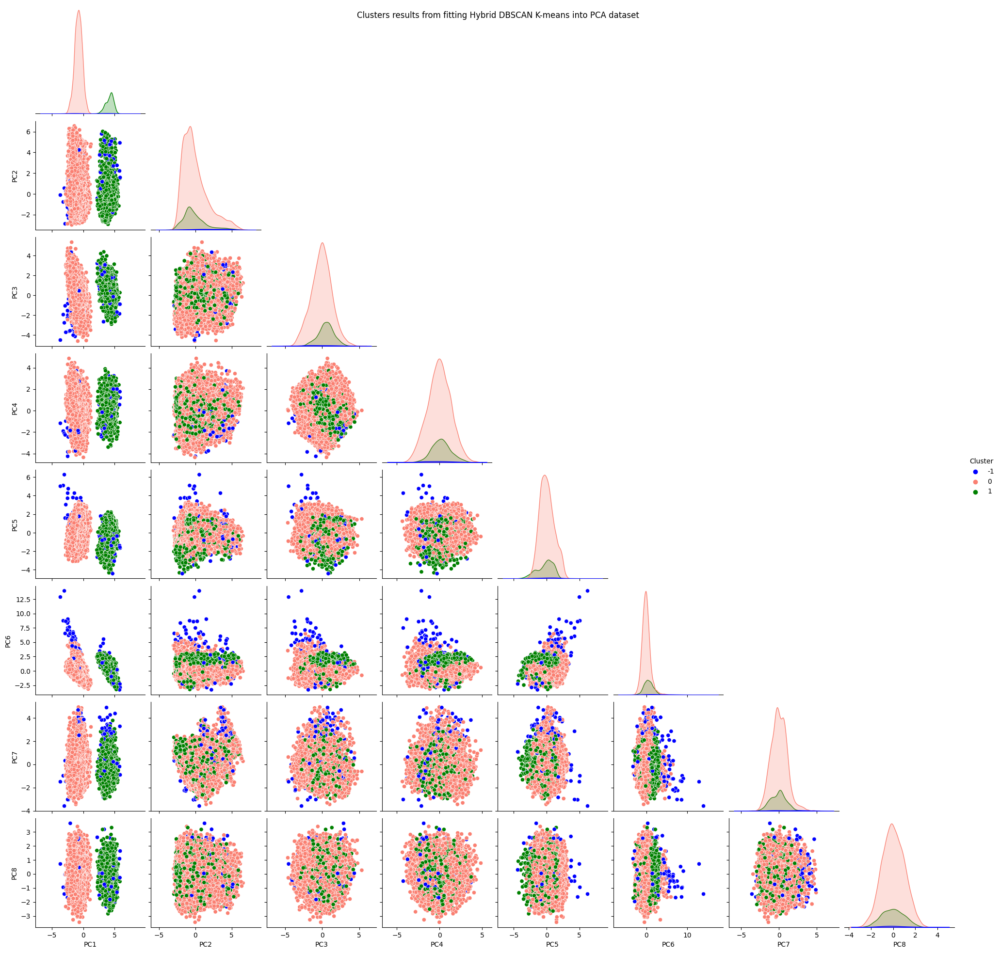

In [77]:
# Assuming your scaled data is a numpy array, convert it to a dataframe
df_scaled_imp = pd.DataFrame(opt_pca_data, columns=['PC1','PC2','PC3','PC4','PC5','PC6','PC7','PC8'])
# Add the cluster labels to your dataframe
df_scaled_imp['Cluster'] = labels_dbk_h3

# Now you can create the pairplot
sns.pairplot(df_scaled_imp, hue='Cluster', corner=True, diag_kind="kde", palette=['blue', 'salmon','green'])
plt.suptitle("Clusters results from fitting Hybrid DBSCAN K-means into PCA dataset")
plt.show()

In [81]:
# Calculate pairwise distances
distances = pairwise_distances(opt_pca_data)

# Find number of observations in each cluster
unique_labels, counts = np.unique(labels_dbk_h3, return_counts=True)
print(f'Number of observations in each cluster: {dict(zip(unique_labels, counts))}')

# For each cluster label
for label in unique_labels:
    # Indices of instances in the current cluster
    indices = np.where(labels_dbk_h3 == label)[0]
    
    # Calculate max and average dissimilarity
    dissimilarities = distances[np.ix_(indices, indices)]
    max_dissimilarity = dissimilarities.max()
    avg_dissimilarity = dissimilarities.mean()

    print(f'Cluster {label}: Max dissimilarity = {max_dissimilarity}, Average dissimilarity = {avg_dissimilarity}')

# Calculate isolation for each cluster
cluster_distances = distances[np.ix_(labels_dbk_h3 == labels_dbk_h3, labels_dbk_h3 == labels_dbk_h3)]
min_distances = cluster_distances.min(axis=0)
max_distances = cluster_distances.max(axis=0)
isolation = max_distances - min_distances

for i, label in enumerate(unique_labels):
    print(f'Isolation for cluster {label}: {isolation[i]:.5f}')

Number of observations in each cluster: {-1: 121, 0: 1564, 1: 8442}
Cluster -1: Max dissimilarity = 22.116435159759533, Average dissimilarity = 8.204130700737098
Cluster 0: Max dissimilarity = 10.616018889806677, Average dissimilarity = 4.313385993823837
Cluster 1: Max dissimilarity = 12.464156579855256, Average dissimilarity = 4.602984497667598
Isolation for cluster -1: 12.06212
Isolation for cluster 0: 17.69709
Isolation for cluster 1: 17.69678


In [82]:
# Calculate pairwise distances
distances = pairwise_distances(opt_pca_data)

# Find number of observations in each cluster
unique_labels, counts = np.unique(labels_dbk_h3, return_counts=True)
print(f'Number of observations in each cluster: {dict(zip(unique_labels, counts))}')

# For each cluster label
for label in unique_labels:
    # Ignore noise points
    if label == -1:
        continue

    # Indices of instances in the current cluster
    indices = np.where(labels_dbk_h3 == label)[0]
    
    # Calculate max and average dissimilarity
    dissimilarities = distances[np.ix_(indices, indices)]
    max_dissimilarity = dissimilarities.max()
    avg_dissimilarity = dissimilarities.mean()

    print(f'Cluster {label}: Max dissimilarity = {max_dissimilarity}, Average dissimilarity = {avg_dissimilarity}')

# Calculate isolation for each cluster
cluster_distances = distances[np.ix_(labels_dbk_h3 != -1, labels_dbk_h3 != -1)]
min_distances = cluster_distances.min(axis=0)
max_distances = cluster_distances.max(axis=0)
isolation = max_distances - min_distances

for i, label in enumerate(unique_labels):
    # Ignore noise points
    if label == -1:
        continue
    print(f'Isolation for cluster {label}: {isolation[i]:.5f}')

Number of observations in each cluster: {-1: 121, 0: 1564, 1: 8442}
Cluster 0: Max dissimilarity = 10.616018889806677, Average dissimilarity = 4.313385993823837
Cluster 1: Max dissimilarity = 12.464156579855256, Average dissimilarity = 4.602984497667598
Isolation for cluster 0: 9.82577
Isolation for cluster 1: 12.08293
